# **SmartSeq HCC1806 Cell Line: ```metadata``` and ```unfiltered``` data**

-----



In this file, we will analyze the ```metadata``` and ```unfiltered``` datasets for the HCC1806 cell line with the SmartSeq technique.

Our report will be extensive and as explanatory as possible. Indeed, all other files for the MCF7 cell line and the ones with the DropSeq technique will be much shorter, straight to the point, and similar to the structure here.

The structure of the file is the following

- Python Libraries
- Exploratory Data Analysis
  - Metadata
  - Unfiltered
    - Introductory Information
    - Sparsity
    - Outliers
    - Distributions
    - Correlation
- Data Preprocessing
  - Quality Control (QC)
    - QC for Cells
    - QC for Genes
  - Why Do We Need Normalization?
  - Normalization
  - Scaling
  - A Note on Cell Cycles
  - Feature Selection
  - Dimensionality Reduction
    - PCA
    - t-SNE
    - UMAP
- Downstream Analysis
  - Correlation
  - Unsupervised Clustering
    - Hierarchical
    - K-Means
    - Leiden Clustering Technique
  - Gene Annotation

# **Python Libraries**

In [ ]:
# install additional packages
!pip install -q scanpy
!pip install -q scikit-misc
!pip install -q pyvis
!pip install -q leidenalg

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 23.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 103.0/103.0 kB 10.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.2/88.2 kB 8.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 44.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.5/63.5 kB 4.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.7/10.7 MB 70.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 756.0/756.0 kB 11.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 41.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 15.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.3/3.3 MB 75.2 MB/s eta 0:00:00


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import matplotlib.colors as colors
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D
import random
from scipy.stats import kurtosis, skew
from scipy.cluster.hierarchy import dendrogram, linkage
import scanpy as sc
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE 
import umap.umap_ as umap
import networkx as nx
from pyvis.network import Network
from sklearn.cluster import KMeans

np.random.seed(42)

assert pd.__version__ <= "1.5.3" # some cells will NOT run in the new 2.0 version!

In [ ]:
# code used to avoid having long (and useless) warning messages
import warnings
warnings.filterwarnings("ignore", message="No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored")
warnings.filterwarnings("ignore", message="The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning")


Let's import the paths of the datasets. We inform the reader that the datasets are not public and we will not release them.

In [ ]:
# HCC1806 cell line data paths
path_h_metadata = "./SmartSeq/HCC1806_SmartS_MetaData.tsv"
path_h_unfiltered = "./SmartSeq/HCC1806_SmartS_Unfiltered_Data.txt"
path_h_filtered = "./SmartSeq/HCC1806_SmartS_Filtered_Data.txt"
path_h_filtered_norm_train = "./SmartSeq/HCC1806_SmartS_Filtered_Normalised_3000_Data_train.txt"
path_h_filtered_norm_test = "./SmartSeq/HCC1806_SmartS_Filtered_Normalised_3000_Data_test_anonim.txt"

# **Exploratory Data Analysis**

In this section we'll explore the data.

## Metadata

Let's check the metadata file.

In [ ]:
#Loading the file 
h_metadata = pd.read_csv(path_h_metadata, sep="\t")

In [ ]:
#Dimension and view of the dataframe
print("Dataframe dimension:", h_metadata.shape)
h_metadata.head()

Dataframe dimension: (243, 9)


,Filename,Cell Line,PCR Plate,Pos,Condition,Hours,Cell name,PreprocessingTag,ProcessingComments
0,output.STAR.PCRPlate1A10_Normoxia_S123_Aligned...,HCC1806,1,A10,Normo,24,S123,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
1,output.STAR.PCRPlate1A12_Normoxia_S26_Aligned....,HCC1806,1,A12,Normo,24,S26,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
2,output.STAR.PCRPlate1A1_Hypoxia_S97_Aligned.so...,HCC1806,1,A1,Hypo,24,S97,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
3,output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.s...,HCC1806,1,A2,Hypo,24,S104,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"
4,output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sor...,HCC1806,1,A3,Hypo,24,S4,Aligned.sortedByCoord.out.bam,"STAR,FeatureCounts"


In [ ]:
#general informations about the dataframe
h_metadata.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 243 entries, 0 to 242
Data columns (total 9 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   Filename            243 non-null    object
 1   Cell Line           243 non-null    object
 2   PCR Plate           243 non-null    int64 
 3   Pos                 243 non-null    object
 4   Condition           243 non-null    object
 5   Hours               243 non-null    int64 
 6   Cell name           243 non-null    object
 7   PreprocessingTag    243 non-null    object
 8   ProcessingComments  243 non-null    object
dtypes: int64(2), object(7)
memory usage: 17.2+ KB


We have a dataframe with 243 rows and 9 columns, most of which are of type object, except for the columns ```PCR Plate``` and ```Hours``` that are integers. Moreover, from the above description, we see that there are no missing values. 

Let's try to understand what each row and column represents.

In [ ]:
#For each column, which are the possible values
print("Filename length: ", len(h_metadata["Filename"].unique()))
print("Cell line[{}]: {}".format(len(h_metadata["Cell Line"].unique()), h_metadata["Cell Line"].unique()))
print("PCR Plate[{}]: {}".format(len(h_metadata["PCR Plate"].unique()), h_metadata["PCR Plate"].unique()))
print("Pos[{}]: {}".format(len(h_metadata["Pos"].unique()), h_metadata["Pos"].unique()))
print("Condition[{}]: {}".format(len(h_metadata["Condition"].unique()), h_metadata["Condition"].unique()))
print("Hours[{}]: {}".format(len(h_metadata["Hours"].unique()), h_metadata["Hours"].unique()))
print("Cell name[{}]: {}".format(len(h_metadata["Cell name"].unique()), h_metadata["Cell name"].unique()))
print("Preprocessing tags[{}]: {}".format(len(h_metadata["PreprocessingTag"].unique()), h_metadata["PreprocessingTag"].unique()))
print("Processing comments[{}]: {}".format(len(h_metadata["ProcessingComments"].unique()), h_metadata["ProcessingComments"].unique()))

Filename length:  243
Cell line[1]: ['HCC1806']
PCR Plate[4]: [1 2 3 4]
Pos[91]: ['A10' 'A12' 'A1' 'A2' 'A3' 'A4' 'A5' 'A6' 'A7' 'A8' 'A9' 'B11' 'B12' 'B1'
 'B2' 'B3' 'B4' 'B5' 'B6' 'B7' 'B9' 'C10' 'C11' 'C12' 'C1' 'C5' 'C6' 'C7'
 'C8' 'C9' 'D10' 'D12' 'D1' 'D3' 'D5' 'D9' 'E12' 'E1' 'E5' 'E6' 'E7' 'E8'
 'F12' 'F4' 'F5' 'F7' 'F8' 'F9' 'G10' 'G11' 'G12' 'G1' 'G2' 'G3' 'G4' 'G6'
 'G7' 'G8' 'G9' 'H1' 'H2' 'H5' 'H6' 'H9' 'B8' 'C3' 'C4' 'D2' 'D6' 'E10'
 'E11' 'E3' 'E4' 'E9' 'F10' 'F1' 'F2' 'F3' 'F6' 'H10' 'H11' 'H3' 'A11'
 'C2' 'D11' 'D4' 'E2' 'G5' 'H4' 'H7' 'B10']
Condition[2]: ['Normo' 'Hypo']
Hours[1]: [24]
Cell name[243]: ['S123' 'S26' 'S97' 'S104' 'S4' 'S8' 'S108' 'S11' 'S113' 'S119' 'S20'
 'S127' 'S27' 'S98' 'S1' 'S5' 'S105' 'S109' 'S12' 'S114' 'S21' 'S124'
 'S128' 'S28' 'S99' 'S110' 'S13' 'S115' 'S120' 'S22' 'S125' 'S29' 'S100'
 'S6' 'S111' 'S23' 'S30' 'S101' 'S112' 'S14' 'S116' 'S17' 'S31' 'S106'
 'S9' 'S117' 'S18' 'S24' 'S126' 'S25' 'S32' 'S102' 'S2' 'S7' 'S107' 'S15'
 'S118' 'S19' 

The data contains information about the samples used in PCR (Polymerase Chain Reaction). In particular:
- the ```Filename``` column summarizes all the information provided in the other columns. The name of the file gives you information on cell line, the technology used, and processing. The format is: CellLine_Technology_preprocessing_Data.txt
- the ```Cell line``` column refers to the type of cell line used in the experiment. As indicated in the file and from the values, it is the same for all values (namely HCC1806).
- the ```PCR Plate``` column indicates the specific plate used for the sample. There were 4 plates: 1, 2, 3, and 4.
- the ```Pos``` column refers to the position of the sample in the respective plate, numbered in a grid format.
- the ```Condition``` column indicates whether the sample was normoxic (i.e. 21% of oxygen) or hypoxic (1% of oxygen)
- the ```Hours``` column indicates the number of hours the sample was grown for. We infer that all samples were grown for 24 hours.
- the ```Cell name``` column indicates the name of the cell sample.
- the ```PreprocessingTag``` column indicates the preprocessing. It is the same for all values. In particular:
  - *Aligned.sortedByCoord* refers to the fact that the reads (the RNA sequence from one fragment) have been organized based on the specific position on the genome.
  - *out.bam* indicates the output has been saved as a Binary Alignment Map file (BAM), namely a compressed version of a Sequence Alignment Map (SAM) file.
- the ```ProcessingComments``` column indicates additional information on the processing of the sample, given the previous preprocessing part.
  - *STAR* indicates the type of alignment conducted.
  - *FeatureCounts* is just the name of the software used.

So each row refers to a specific cell sample used in the PCR process, related to the growth of this specific cell line. Since we have 243 different ```Filename``` rows, we have a total of 243 different cells.

Since we are trying to solve a problem related to hypoxia, it can be interesting to study how many hypoxic and normoxic cells we have in the dataset.

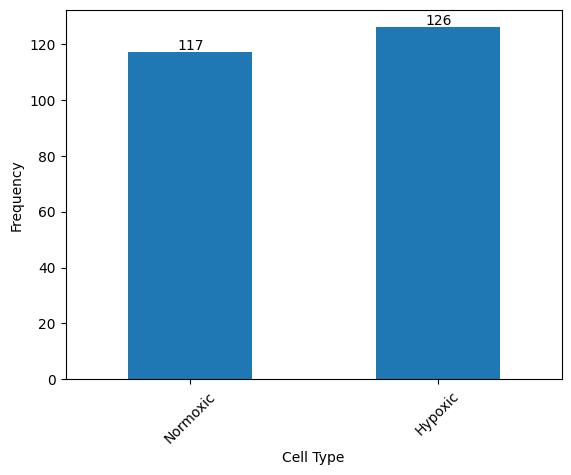

In [ ]:
normoxic_cells = h_metadata["Filename"].str.contains('Normoxia').sum()
hypoxic_cells = h_metadata["Filename"].str.contains('Hypoxia').sum()
s = pd.Series({"Normoxic" : normoxic_cells, "Hypoxic" : hypoxic_cells})
s.plot.bar(rot = 45)
plt.text(-0.05, 118, str(normoxic_cells))
plt.text(0.95, 127, str(hypoxic_cells))
plt.xlabel("Cell Type")
plt.ylabel("Frequency")
plt.grid(False)
plt.show()

As we can see, we have similar proportions, with a slightly bigger number of hypoxic cells. Nonetheless, all groups in the dataset appear evenly distributed, which is our ideal scenario that will later come helpful in the modeling section.

The metadata file contains no other meaningful information, so we can move on.

## Unfiltered

### Introductory Information

In [ ]:
#Loading HCC1806_SmartS_Unfiltered_Data.txt0
h_unfiltered = pd.read_csv(path_h_unfiltered, sep = " ")

In [ ]:
#General informations about the file
h_unfiltered.info()

<class 'pandas.core.frame.DataFrame'>
Index: 23396 entries, WASH7P to MAFIP
Columns: 243 entries, output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam to output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam
dtypes: int64(243)
memory usage: 43.6+ MB


In [ ]:
#Dimensions of the dataframe
h_unfiltered.shape

(23396, 243)

In [ ]:
#which are the indexes, which are the columns
print("Dataframe indexes: ", h_unfiltered.index)
print("Dataframe columns: ", h_unfiltered.columns)

Dataframe indexes:  Index(['WASH7P', 'CICP27', 'DDX11L17', 'WASH9P', 'OR4F29', 'MTND1P23',
       'MTND2P28', 'MTCO1P12', 'MTCO2P12', 'MTATP8P1',
       ...
       'MT-TH', 'MT-TS2', 'MT-TL2', 'MT-ND5', 'MT-ND6', 'MT-TE', 'MT-CYB',
       'MT-TT', 'MT-TP', 'MAFIP'],
      dtype='object', length=23396)
Dataframe columns:  Index(['output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam',
       'output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam',
       'output.STAR.PCRPlate1A1_Hypoxia_S97_Aligned.sortedByCoord.out.bam',
       'output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam',
       'output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam',
       'output.STAR.PCRPlate1A4_Hypoxia_S8_Aligned.sortedByCoord.out.bam',
       'output.STAR.PCRPlate1A5_Hypoxia_S108_Aligned.sortedByCoord.out.bam',
       'output.STAR.PCRPlate1A6_Hypoxia_S11_Aligned.sortedByCoord.out.bam',
       'output.STAR.PCRPlate1A7_Normoxia_S113_Aligned.sortedByCo

In [ ]:
#check the type of the columns
h_unfiltered.dtypes.unique() 

array([dtype('int64')], dtype=object)

We can notice that we have 23396  rows, with a specific string, and 243 columns, each corresponding to the filenames in the metadata dataset explored before. All the data entries are integers. Let's understand what each row indicates.

In [ ]:
#view of the dataframe
h_unfiltered.head()

,output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A1_Hypoxia_S97_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A4_Hypoxia_S8_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A5_Hypoxia_S108_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A6_Hypoxia_S11_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A7_Normoxia_S113_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A8_Normoxia_S119_Aligned.sortedByCoord.out.bam,...,output.STAR.PCRPlate4G12_Normoxia_S243_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G1_Hypoxia_S193_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G2_Hypoxia_S198_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G6_Hypoxia_S232_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G7_Normoxia_S204_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam
WASH7P,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
CICP27,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
DDX11L17,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
WASH9P,0,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,1,0,1,0,0
OR4F29,2,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
#Creates a new dataframe containing informations about the genes in the index
path_gene_symbols_url = "https://ftp.ebi.ac.uk/pub/databases/genenames/hgnc/tsv/hgnc_complete_set.txt"
symbols = pd.read_csv(path_gene_symbols_url, sep = "\t", low_memory=False)

In [ ]:
symbols.columns

Index(['hgnc_id', 'symbol', 'name', 'locus_group', 'locus_type', 'status',
       'location', 'location_sortable', 'alias_symbol', 'alias_name',
       'prev_symbol', 'prev_name', 'gene_group', 'gene_group_id',
       'date_approved_reserved', 'date_symbol_changed', 'date_name_changed',
       'date_modified', 'entrez_id', 'ensembl_gene_id', 'vega_id', 'ucsc_id',
       'ena', 'refseq_accession', 'ccds_id', 'uniprot_ids', 'pubmed_id',
       'mgd_id', 'rgd_id', 'lsdb', 'cosmic', 'omim_id', 'mirbase', 'homeodb',
       'snornabase', 'bioparadigms_slc', 'orphanet', 'pseudogene.org',
       'horde_id', 'merops', 'imgt', 'iuphar', 'kznf_gene_catalog',
       'mamit-trnadb', 'cd', 'lncrnadb', 'enzyme_id',
       'intermediate_filament_db', 'rna_central_ids', 'lncipedia', 'gtrnadb',
       'agr', 'mane_select', 'gencc'],
      dtype='object')

[Symbols](https://ftp.ebi.ac.uk/pub/databases/genenames/hgnc/tsv/hgnc_complete_set.txt) is a publicly available dataset containing information about genes. In our case, we are keeping only the ones that are relevant for us and which might be helpful to gain more information on our dataset.

In [ ]:
# genes that are also in our dataframe
symbols.loc[symbols['symbol'].isin(h_unfiltered.index)]

,hgnc_id,symbol,name,locus_group,locus_type,status,location,location_sortable,alias_symbol,alias_name,...,cd,lncrnadb,enzyme_id,intermediate_filament_db,rna_central_ids,lncipedia,gtrnadb,agr,mane_select,gencc
0,HGNC:5,A1BG,alpha-1-B glycoprotein,protein-coding gene,gene with protein product,Approved,19q13.43,19q13.43,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,HGNC:5,ENST00000263100.8|NM_130786.4,NaN
1,HGNC:37133,A1BG-AS1,A1BG antisense RNA 1,non-coding RNA,"RNA, long non-coding",Approved,19q13.43,19q13.43,FLJ23569,NaN,...,NaN,NaN,NaN,NaN,NaN,A1BG-AS1,NaN,HGNC:37133,NaN,NaN
2,HGNC:24086,A1CF,APOBEC1 complementation factor,protein-coding gene,gene with protein product,Approved,10q11.23,10q11.23,ACF|ASP|ACF64|ACF65|APOBEC1CF,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,HGNC:24086,ENST00000373997.8|NM_014576.4,NaN
3,HGNC:7,A2M,alpha-2-macroglobulin,protein-coding gene,gene with protein product,Approved,12p13.31,12p13.31,FWP007|S863-7|CPAMD5,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,HGNC:7,ENST00000318602.12|NM_000014.6,HGNC:7
4,HGNC:27057,A2M-AS1,A2M antisense RNA 1,non-coding RNA,"RNA, long non-coding",Approved,12p13.31,12p13.31,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,A2M-AS1,NaN,HGNC:27057,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43683,HGNC:32058,ZYG11A,"zyg-11 family member A, cell cycle regulator",protein-coding gene,gene with protein product,Approved,1p32.3,01p32.3,ZYG11,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,HGNC:32058,ENST00000371528.2|NM_001004339.3,NaN
43685,HGNC:25820,ZYG11B,"zyg-11 family member B, cell cycle regulator",protein-coding gene,gene with protein product,Approved,1p32.3,01p32.3,FLJ13456,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,HGNC:25820,ENST00000294353.7|NM_024646.3,HGNC:25820
43686,HGNC:13200,ZYX,zyxin,protein-coding gene,gene with protein product,Approved,7q34,07q34,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,HGNC:13200,ENST00000322764.10|NM_003461.5,NaN
43688,HGNC:29027,ZZEF1,zinc finger ZZ-type and EF-hand domain contain...,protein-coding gene,gene with protein product,Approved,17p13.2,17p13.2,KIAA0399|ZZZ4|FLJ10821,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,HGNC:29027,ENST00000381638.7|NM_015113.4,NaN


Above one can see 23170 rows out of the 23396 rows in the dataset.

This said we can conclude that the dataframe *h_unfiltered* is a **gene expression matrix**. Each row corresponds to a gene, encoded with its own naming convention, while each column corresponds to one of the 243 cell samples. The value of the matrix corresponds to the expression level of the particular gene in the particular sample.

The expression level refers to the number of RNA molecules corresponding to that gene that were detected and quantified in the sample. For example, *OR4F29* has expression value 2 in the sample corresponding to *output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam* (first column).
This means that in that particular sample, the sequencing reads aligning to the gene OR4F29 correspond to 2 RNA molecules of that gene. Instead, still in the same cell, the expression level of gene *WASH9P* is 0, meaning that no RNA molecules corresponding to that gene were detected in the sample.

Now let's try to understand the structure of our dataset. 


### Sparsity

At this stage, it is important to get an idea of how the data is structured. In particular, gene expression data are known to be sparse and we'll check it along the way.

Yet, let's start first with some basic information

In [ ]:
#number of missing values
h_unfiltered.isna().sum().sum()

0

We can see that the dataset has no missing values. Now we do an initial inspection of the distribution of the data.

In [ ]:
#general statistics of the dataframe
h_unfiltered.describe()

,output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A1_Hypoxia_S97_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A4_Hypoxia_S8_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A5_Hypoxia_S108_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A6_Hypoxia_S11_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A7_Normoxia_S113_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A8_Normoxia_S119_Aligned.sortedByCoord.out.bam,...,output.STAR.PCRPlate4G12_Normoxia_S243_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G1_Hypoxia_S193_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G2_Hypoxia_S198_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G6_Hypoxia_S232_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G7_Normoxia_S204_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam
count,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000,...,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000
mean,99.565695,207.678278,9.694734,150.689007,35.700504,47.088434,152.799453,135.869422,38.363908,45.512139,...,76.361771,105.566593,54.026116,29.763806,28.905411,104.740725,35.181569,108.197940,37.279962,76.303855
std,529.532443,981.107905,65.546050,976.936548,205.885369,545.367706,864.974182,870.729740,265.062493,366.704721,...,346.659348,536.881574,344.068304,186.721266,135.474736,444.773045,170.872090,589.082268,181.398951,369.090274
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,1.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,1.000000
75%,51.000000,125.000000,5.000000,40.000000,22.000000,17.000000,81.000000,76.000000,22.000000,18.000000,...,56.000000,67.000000,29.000000,18.000000,19.000000,76.000000,24.000000,68.000000,22.000000,44.000000
max,35477.000000,69068.000000,6351.000000,70206.000000,17326.000000,47442.000000,43081.000000,62813.000000,30240.000000,35450.000000,...,19629.000000,30987.000000,21894.000000,13457.000000,11488.000000,33462.000000,15403.000000,34478.000000,10921.000000,28532.000000


In [ ]:
#general statistics of the dataframe transposed (so for each gene)
h_unfiltered.transpose().describe()

,WASH7P,CICP27,DDX11L17,WASH9P,OR4F29,MTND1P23,MTND2P28,MTCO1P12,MTCO2P12,MTATP8P1,...,MT-TH,MT-TS2,MT-TL2,MT-ND5,MT-ND6,MT-TE,MT-CYB,MT-TT,MT-TP,MAFIP
count,243.000000,243.000000,243.000000,243.000000,243.000000,243.000000,243.000000,243.000000,243.000000,243.000000,...,243.000000,243.000000,243.000000,243.000000,243.000000,243.000000,243.000000,243.000000,243.000000,243.000000
mean,0.045267,0.119342,0.469136,0.255144,0.127572,117.930041,28.427984,904.308642,1.403292,0.378601,...,10.358025,5.930041,13.493827,2290.213992,386.901235,18.246914,2163.588477,20.613169,46.444444,3.897119
std,0.318195,0.594531,1.455282,0.818639,0.440910,103.038022,26.062662,654.520308,1.735003,0.747361,...,10.910199,7.040559,11.803967,1726.423259,309.276105,54.076514,1730.393947,22.224590,47.684223,4.736193
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,46.500000,8.000000,390.500000,0.000000,0.000000,...,2.000000,1.000000,4.000000,918.000000,138.500000,4.000000,947.500000,5.000000,14.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,94.000000,22.000000,790.000000,1.000000,0.000000,...,7.000000,4.000000,10.000000,1848.000000,320.000000,11.000000,1774.000000,14.000000,38.000000,2.000000
75%,0.000000,0.000000,0.000000,0.000000,0.000000,157.000000,42.000000,1208.000000,2.000000,1.000000,...,14.000000,7.500000,20.000000,3172.000000,528.000000,20.000000,2927.000000,30.500000,64.500000,6.000000
max,3.000000,5.000000,12.000000,6.000000,4.000000,694.000000,120.000000,3569.000000,12.000000,4.000000,...,52.000000,43.000000,57.000000,8972.000000,1439.000000,804.000000,11383.000000,154.000000,409.000000,24.000000


In [ ]:
#average number of genes expressed, average number of cell expressing
h_unfiltered_entries1 = h_unfiltered.copy().astype(bool).astype(int)
print("Average expressed genes by each cell: ", np.count_nonzero(h_unfiltered_entries1, axis=0).mean().round(3))
print("Average expressing cells for each gene: ", np.count_nonzero(h_unfiltered_entries1, axis=1).mean().round(3))

Average expressed genes by each cell:  10330.358
Average expressing cells for each gene:  107.295


Notice that, on average, each cell expresses 10330 genes. On the contrary, we notice that each gene is expressed, on average, by 107 cells. Let's have a look at the median:

In [ ]:
#average value of the median
print(f"Average median across all cells: {h_unfiltered.describe().loc['50%'].mean():.3f}")

#number of cells and percentage of cells with 0 median
filt = h_unfiltered.describe().loc['50%'] == 0
number_cell_0_median = h_unfiltered.describe().loc['50%', filt].count() #counts the number of cells with 0 median
print("Number of cells with 0 median: {}, Percentage: {:.3f}".format(number_cell_0_median, number_cell_0_median / h_unfiltered.shape[1]))

Average median across all cells: 0.243
Number of cells with 0 median: 206, Percentage: 0.848


Interestingly enough, we can notice that over 80% of the medians for each cell are 0. Since the minimum value is also 0, by definition of median, this means that the majority of the data in each cell is 0. Technically speaking, in each sample, most of the 23 thousand genes are not matched by the RNA reads. This may suggest that the matrix is sparse.

Let's further confirm this by inspecting 10 random columns.

In [ ]:
#numbers of nonzero entries for 10 random columns
for i in np.random.randint(0, h_unfiltered.shape[1], 10):
    print(f"Number of nonzero elements in column {i}: {np.count_nonzero(h_unfiltered.iloc[:,i].values)}")

Number of nonzero elements in column 102: 11034
Number of nonzero elements in column 179: 12101
Number of nonzero elements in column 92: 10263
Number of nonzero elements in column 14: 8144
Number of nonzero elements in column 106: 8924
Number of nonzero elements in column 71: 10530
Number of nonzero elements in column 188: 11821
Number of nonzero elements in column 20: 11026
Number of nonzero elements in column 102: 11034
Number of nonzero elements in column 121: 11428


So less than half of the elements are different from 0 in the above 10 random cells. Let's see this also for 10 random genes:

In [ ]:
#numbers of nonzero entries for 10 random rows
for i in np.random.randint(0, h_unfiltered.transpose().shape[1], 10):
    print(f"Number of nonzero elements in row {i}: {np.count_nonzero(h_unfiltered.iloc[i,:].values)}")

Number of nonzero elements in row 16850: 2
Number of nonzero elements in row 4426: 168
Number of nonzero elements in row 21962: 217
Number of nonzero elements in row 14423: 47
Number of nonzero elements in row 11363: 58
Number of nonzero elements in row 16023: 34
Number of nonzero elements in row 8322: 45
Number of nonzero elements in row 1685: 224
Number of nonzero elements in row 769: 39
Number of nonzero elements in row 23333: 231


We have a similar situation also for the genes! With all the previous information, this suggests that the dataframe might be sparse. 

Let's measure the sparsity index of the dataframe. It just counts the number of zero entries over all possible entries of the dataframe.

In [ ]:
#computing this sparsity index (Where was it found?)
sparsity_index_unfiltered = 1 - (np.count_nonzero(h_unfiltered.values) / h_unfiltered.size)
sparsity_index_unfiltered

0.558456230779135

The sparsity index is almost 0.56, meaning that roughly more than half of the entries are zero.

Let's now visualize it.

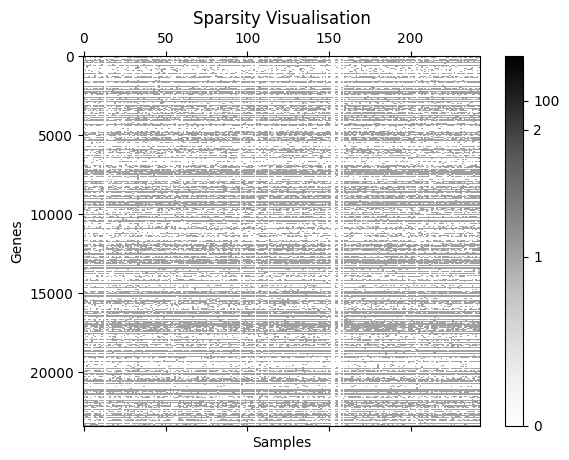

In [ ]:
#sparsity visualisation
class MidpointNormalize(colors.Normalize):
    def __init__(self, vmin=None, vmax=None, vcenter=None, clip=False):
        self.vcenter = vcenter
        super().__init__(vmin, vmax, clip)

    def __call__(self, value, clip=None):
        # I'm ignoring masked values and all kinds of edge cases to make a
        # simple example...
        # Note also that we must extrapolate beyond vmin/vmax
        x, y = [self.vmin, self.vcenter, self.vmax], [0, 0.8, 1.]
        return np.ma.masked_array(np.interp(value, x, y,
                                            left=-np.inf, right=np.inf))

    def inverse(self, value):
        y, x = [self.vmin, self.vcenter, self.vmax], [0, 0.8, 1]
        return np.interp(value, x, y, left=-np.inf, right=np.inf)


fig, ax = plt.subplots()
midnorm = MidpointNormalize(vmin=0, vcenter=1.75, vmax=250)

graph_temporary = plt.spy(h_unfiltered, aspect = "auto", norm=midnorm,
                   cmap='Greys') #hsv
plt.colorbar(graph_temporary).set_ticks([0, 1, 2, 100])
plt.grid(False)
plt.xlabel("Samples")
plt.ylabel("Genes")
ax.set_title('Sparsity Visualisation')

plt.show()

We can see that there are many white zones, meaning that the entry is 0. So, from the previous measures of sparsity and from the plot above, we can officially conclude that the matrix is sparse. Technically, what this means is that lots of genes are codified by a few cells and cells codify for just a few genes. 

Moreover, from the legend on the right-hand side, we notice that there are other values, different from zero. Let's try to understand what these values are by checking the distribution of the data:

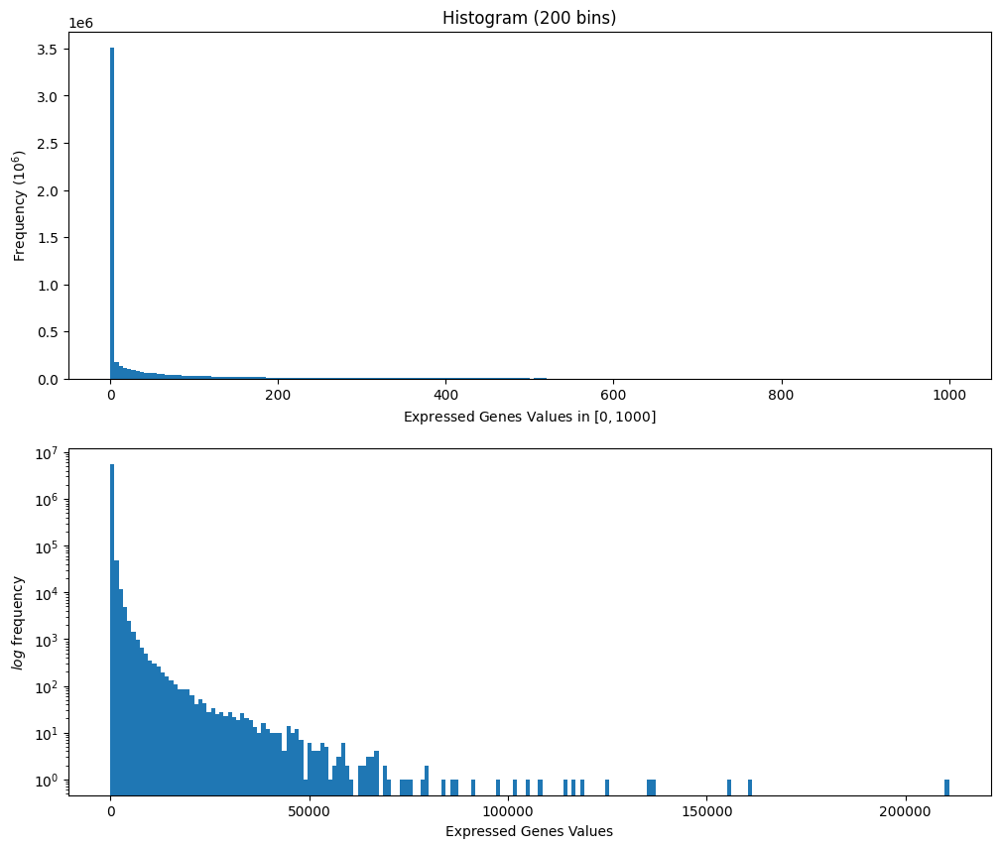

In [ ]:
#distribution of the whole matrix
h_unfiltered_flattened = pd.Series(h_unfiltered.values.flatten())
fig, ax = plt.subplots(2, 1, figsize=(12, 10)) 
ax[0].hist(h_unfiltered_flattened, range = [0, 1000], bins = 200)
ax[0].set_xlabel("Expressed Genes Values in $[0, 1000]$")
ax[0].set_ylabel("Frequency ($10^6$)")
ax[0].set_title("Histogram (200 bins)")
h_unfiltered_flattened = h_unfiltered_flattened
ax[1].hist(h_unfiltered_flattened, bins = 200, log = True)
ax[1].set_xlabel("Expressed Genes Values")
ax[1].set_ylabel("$log$ frequency")
plt.show()

By looking at the first plot we see that most values are 0, as expected. In addition, all other values seem to decrease very rapidly, showing that there are very few highly expressed genes. To further understand such changes, we inspected a log frequency in the second plot. Since the log decreases more than linearly (seems like $\frac{1}{x}$), we can say that the as the number of expressed genes grows, the number of such occurrences seems to decrease more than exponentially.

Of course, one would need to run statistical tests to verify this assumption, but as of now, we're more interested in just grasping an intuitive idea of our data.

In [ ]:
#check other location metrics
round(h_unfiltered_flattened.describe())

count    5685228.0
mean          86.0
std          580.0
min            0.0
25%            0.0
50%            0.0
75%           39.0
max       210944.0
dtype: float64

In [ ]:
#skewness and kurtosis of the whole matrix
skew_matrix = skew(h_unfiltered_flattened)
kurtosis_matrix = kurtosis(h_unfiltered_flattened)
print("Skewness of the whole matrix: ", round(skew_matrix))
print("Kurtosis of the whole matrix: ", round(kurtosis_matrix))

Skewness of the whole matrix:  68
Kurtosis of the whole matrix:  10959


Notice that we have both a high skewness, meaning that the distribution of the data is not symmetric, and high kurtosis, meaning that it has very long and skinny tails and that we have a distribution where lots of numbers are located in the tails of it instead of around the mean. Therefore the distribution is not similar to a normal one. We'll consider these attributes better later on.

Moreover, by looking at the sparsity graph plotted before we can gain other interesting insights. Indeed at the white stripes, some cells seem to codify for no gene at all and, similarly, some genes are codified by no RNA molecule of any cell. This might indicate either that the RNA reads were not representative enough for that gene sequence (so it's more of a stochastic effect that depends on what segment of the RNA had been read in the lab) or that the gene has nothing to do with the cell at all.

Let's understand if this is the case:

In [ ]:
#proportion of genes that are not expressed and proportion of cells that are not expressing 
expressed_genes = 1 - (np.count_nonzero(h_unfiltered.sum(axis = 1)) / h_unfiltered.shape[0])
expressing_cells = 1 - (np.count_nonzero(h_unfiltered.sum(axis = 0)) / h_unfiltered.shape[1])
print("Expressed genes:", expressed_genes, "\nExpressing cells: ", expressing_cells)

Expressed genes: 0.0 
Expressing cells:  0.0


Since both values are zero, it means that each gene is expressed at least once, at each cell is producing at least one gene. Therefore, our claim stated above is false. This said, it would be interesting to inspect which genes are expressed the most and the less, and similarly for the cells.

In [ ]:
# which is the gene that is expressed less
min_expressed_gene = h_unfiltered.sum(axis = 1).idxmin()
print("Least expressed gene: {}\nNumber of codifying samples: {}".format(min_expressed_gene, h_unfiltered.sum(axis = 1)[min_expressed_gene]))

# which is the gene that is expressed most
max_expressed_gene = h_unfiltered.sum(axis = 1).idxmax()
print("\nMost expressed gene: {}\nNumber of codifying samples: {}".format(max_expressed_gene, h_unfiltered.sum(axis = 1)[max_expressed_gene]))

#which is the cell that expresses less (cell: how many it produces, which uniques)
min_expressed_gene = h_unfiltered.sum(axis = 0).idxmin()
print("\nLeast expressed cell: {}\nProduced genes:{}\nUnique genes:{}\n".format(min_expressed_gene, h_unfiltered.sum(axis = 0)[min_expressed_gene], h_unfiltered.astype(bool).sum(axis = 0).min()))

#which is the cell that expresses most (cell: how many it produces, which uniques)
max_expressed_gene = h_unfiltered.sum(axis = 0).idxmax()
print("Most expressed cell: {}\nProduced genes:{}\nUnique genes:{}".format(max_expressed_gene, h_unfiltered.sum(axis = 0)[max_expressed_gene], h_unfiltered.astype(bool).sum(axis = 0).max()))

Least expressed gene: CICP3
Number of codifying samples: 2

Most expressed gene: ACTB
Number of codifying samples: 6582141

Least expressed cell: output.STAR.PCRPlate2F12_Normoxia_S62_Aligned.sortedByCoord.out.bam
Produced genes:114
Unique genes:35

Most expressed cell: output.STAR.PCRPlate2H2_Hypoxia_S35_Aligned.sortedByCoord.out.bam
Produced genes:5758132
Unique genes:13986


In [ ]:
#which gene are produced the most by each cell
print(pd.DataFrame({'gene': h_unfiltered.idxmax(), 'value': h_unfiltered.max()}))
print("Uniques[{}]: {}".format(h_unfiltered.idxmax().unique().size, h_unfiltered.idxmax().unique()))

                                                     gene  value
output.STAR.PCRPlate1A10_Normoxia_S123_Aligned....    FTL  35477
output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.s...   ACTB  69068
output.STAR.PCRPlate1A1_Hypoxia_S97_Aligned.sor...   ACTB   6351
output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.so...  HSPA5  70206
output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sort...    FTL  17326
...                                                   ...    ...
output.STAR.PCRPlate4H10_Normoxia_S210_Aligned....   ACTB  33462
output.STAR.PCRPlate4H11_Normoxia_S214_Aligned....   ACTB  15403
output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.so...    FTL  34478
output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.s...   ACTB  10921
output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.s...   ACTB  28532

[243 rows x 2 columns]
Uniques[19]: ['FTL' 'ACTB' 'HSPA5' 'FTH1' 'LDHA' 'SGCB' 'GAPDH' 'KRT19' 'MT-ND4'
 'MT-CO1' 'FLT3LG' 'HFE' 'MT-RNR2' 'KRT17' 'C12orf29' 'LGI1' 'CAPN5'
 'GPATCH2L' 'LAMB3']


From this last cell, we can notice something particular: most cells codify for the same group of genes. Indeed, out of the 23000 genes, only 19 are the most codified by the 243 cells in our sample. This suggests that some genes might play a much stronger role than others and we will try to understand it in later sections.

Now let's check if there are some differences when dealing with normoxia/hypoxia cells.

In [ ]:
#define dataframe with normoxic, hypoxic cells
normoxic_cells = h_unfiltered.columns.str.contains('Normoxia')
hypoxic_cells = h_unfiltered.columns.str.contains('Hypoxia')
norm_hypo_cells = pd.Series({"Normoxic" : normoxic_cells, "Hypoxic" : hypoxic_cells})

In [ ]:
#values of nonzero for normoxic, hypoxic cells
codified_genes_normoxia = np.count_nonzero(h_unfiltered.loc[:, normoxic_cells].values)
codified_genes_hypoxia = np.count_nonzero(h_unfiltered.loc[:, hypoxic_cells].values)
print("Codified genes in normoxic cells: ", codified_genes_normoxia)
print("Codified genes in hypoxic cells: ", codified_genes_hypoxia)

Codified genes in normoxic cells:  1223522
Codified genes in hypoxic cells:  1286755


They both codify for roughly the same amount of genes. Let's check how, with the distributions.

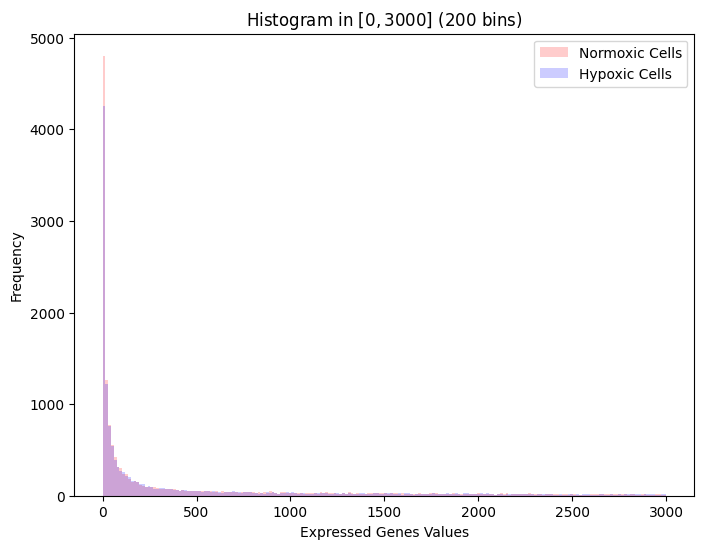

In [ ]:
#check for the distribution
fig, ax = plt.subplots(1, 1, figsize=(8, 6)) 
ax.hist(h_unfiltered.loc[:, normoxic_cells].sum(axis = 1), range = [0, 3000], bins = 200, alpha = 0.2, color = "red", label = "Normoxic Cells")
ax.hist(h_unfiltered.loc[:, hypoxic_cells].sum(axis = 1), range = [0, 3000], bins = 200, alpha = 0.2, color = "blue", label = "Hypoxic Cells")
ax.set_xlabel("Expressed Genes Values")
ax.set_ylabel("Frequency")
ax.set_title("Histogram in $[0, 3000]$ (200 bins)")
ax.legend()
plt.show()

We can see that both hypoxic and normoxic cells follow a similar distribution pattern, with most gene expression values being 0. This also tells us that, overall, the cells do not differ in the number of genes they codify for.

Let's check the most expressed genes in each type.

In [ ]:
#check for normoxic, hypoxic cells which are the top 10 expressed genes
print("Top 10 genes of normoxic cells:\n", h_unfiltered.loc[:, normoxic_cells].sum(axis = 1).nlargest(10))
print("Top 10 genes of hypoxic cells:\n", h_unfiltered.loc[:, hypoxic_cells].sum(axis = 1).nlargest(10))

Top 10 genes of normoxic cells:
 ACTB       2912678
FTL        2835354
GAPDH      1351516
FTH1       1284712
BEST1      1116573
CD44       1056221
MT-CO1     1026417
HSPA5      1012828
LDHA        917910
MT-RNR2     805549
dtype: int64
Top 10 genes of hypoxic cells:
 ACTB      3669463
LDHA      2886073
FTL       2827955
GAPDH     2536718
FTH1      1859697
KRT19     1717945
BEST1     1615105
ENO1      1401152
HSPA5     1388389
MT-CO1    1309556
dtype: int64


Notice that we see a relevant increase in LDHA, KRT19 for hypoxic cells. However, we are going to analyze which aspects are relevant in order to predict normoxia/hypoxia later on.

Now we want to see whether having cells belonging to a different plate has an effect on the distribution of 0's.

<ipython-input-38-b1610198a593>:4: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  h_unfiltered_with_plates = h_unfiltered.append(h_new)


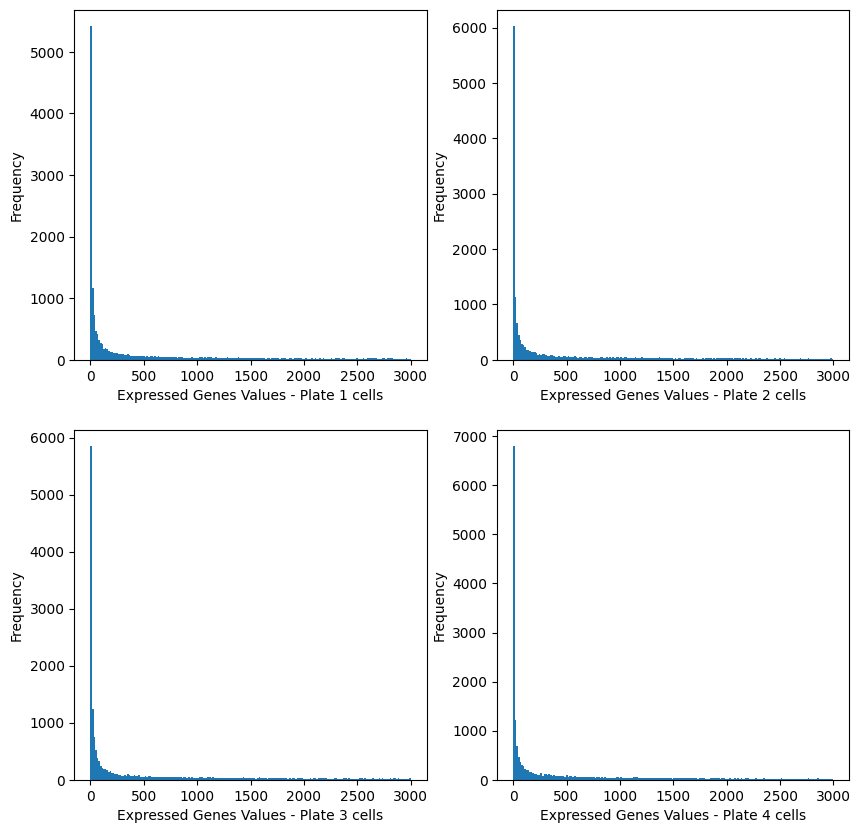

In [ ]:
#distributions of cells on different part of the plates
h_new = h_metadata["PCR Plate"]
h_new.index = h_metadata['Filename']
h_unfiltered_with_plates = h_unfiltered.append(h_new)
h_unfiltered_with_plates

plate1_mask = h_unfiltered_with_plates.loc['PCR Plate', :] == 1
plate2_mask = h_unfiltered_with_plates.loc['PCR Plate', :] == 2
plate3_mask = h_unfiltered_with_plates.loc['PCR Plate', :] == 3
plate4_mask = h_unfiltered_with_plates.loc['PCR Plate', :] == 4

plate1 = h_unfiltered_with_plates.loc[:, plate1_mask].sum(axis = 1)
plate2 = h_unfiltered_with_plates.loc[:, plate2_mask].sum(axis = 1)
plate3 = h_unfiltered_with_plates.loc[:, plate3_mask].sum(axis = 1)
plate4 = h_unfiltered_with_plates.loc[:, plate4_mask].sum(axis = 1)

fig, ax = plt.subplots(2, 2, figsize=(10, 10)) 
ax[0][0].hist(plate1, range = [0, 3000], bins = 200)
ax[0][0].set_xlabel("Expressed Genes Values - Plate 1 cells")
ax[0][0].set_ylabel("Frequency")
ax[0][1].hist(plate2, range = [0, 3000], bins = 200)
ax[0][1].set_xlabel("Expressed Genes Values - Plate 2 cells")
ax[0][1].set_ylabel("Frequency")
ax[1][0].hist(plate3, range = [0, 3000], bins = 200)
ax[1][0].set_xlabel("Expressed Genes Values - Plate 3 cells")
ax[1][0].set_ylabel("Frequency")
ax[1][1].hist(plate4, range = [0, 3000], bins = 200)
ax[1][1].set_xlabel("Expressed Genes Values - Plate 4 cells")
ax[1][1].set_ylabel("Frequency")
plt.show()

Again, there don't seem to be relevant differences.

Going back to our structure, we have verified having a sparse dataframe. From a computational point of view, we have to be careful. The problem with sparse data is that they are frequently large, making it hard to use standard ML Python tools such as pandas and sklearn.
Indeed, it is not uncommon for the memory of an average local machine not to suffice for the storage or processing of a large data set. Handling a sparse matrix as a dense one is frequently inefficient, making excessive use of memory. Even if memory is sufficient, processing time can increase significantly. Indeed in the following cell we see the memory used by our data:

In [ ]:
#bytes occupied by nonsparse/sparse representation of dataframe
h_unfiltered_sparr = h_unfiltered.astype(pd.SparseDtype("int", 0))
print('dense : {:0.2f} bytes'.format(h_unfiltered.memory_usage().sum() / 1e3))
print('sparse: {:0.2f} bytes'.format(h_unfiltered_sparr.memory_usage().sum() / 1e3))

dense : 46197.42 bytes
sparse: 30838.92 bytes


Still, not all algorithms in Python's libraries support sparse matrices, so it's up to the programmers care to check that the specific method used is available for that representation.

As we can see above, at least for now we're handling (only) megabytes of data, so using a sparse representation will not lead to dramatic memory savings and computational increases. Therefore, for now, we decide to keep the matrix as it is.

### Outliers

Studying outliers is important because it can greatly affect the results of the analyses and interpretations. If not treated and processed properly they can potentially can serious issues, such as skewing the data and impacting the mean, standard deviation, and correlations, which can in turn affect the results of clustering, dimensionality reduction, and other analyses. 

Having a sparse dataset, studying the outliers (so the nonzero elements most likely) becomes even more fundamental since they have an even larger impact on the statistical properties and interpretations of the data. Indeed, we expect that simply removing outliers would not work here, as many genes/features would be 0 if we excluded the outliers.

In this section, we'll try to identify the outliers and there are several methods to check them, such as:
- Visual tools
- Z-score
- IQR (Interquartile Range, with Tukey's rule)

and more. We'll quickly explore some of these methods.

First of all, let's visualize the violin plot and the box plot of a single column of our dataframe.

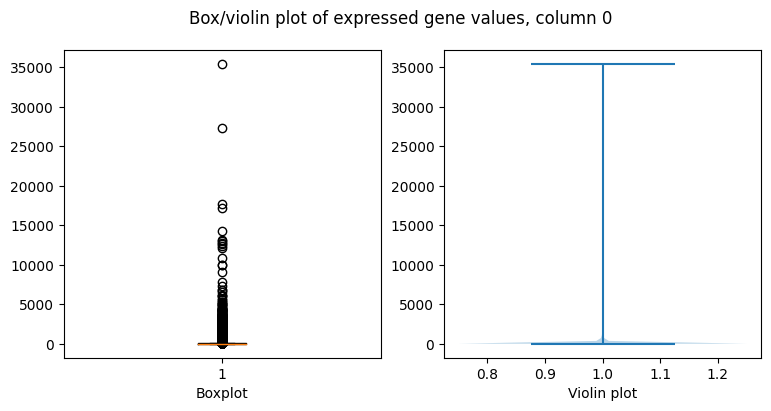

In [ ]:
#boxplot and violin plot of a single column
col = h_unfiltered.iloc[:, 0]
fig, ax= plt.subplots(1,2, figsize=(9, 4))
plt.suptitle("Box/violin plot of expressed gene values, column 0")
ax[0].boxplot(col)
ax[1].violinplot(col)
ax[0].set_xlabel("Boxplot")
ax[1].set_xlabel("Violin plot")
plt.show()

Notice that, especially through the violin plot, most of the density of the distribution is around 0.

We've inspected a single cell. Now (and also a bit in subsequent sections) we'll be using a version of the original dataset which includes only 50 random columns, since generating the plots for all the 243 cells would take too much time in our setup.

In [ ]:
#create smaller dataframe
random_columns = list(range(0, h_unfiltered.shape[1])) # list of integers from 1 to 243
random.shuffle(random_columns)
random_columns = random_columns[:50]
h_unfiltered_small = h_unfiltered.iloc[:, random_columns]

First of all, let's look at the boxplot and the violin plots of the data.

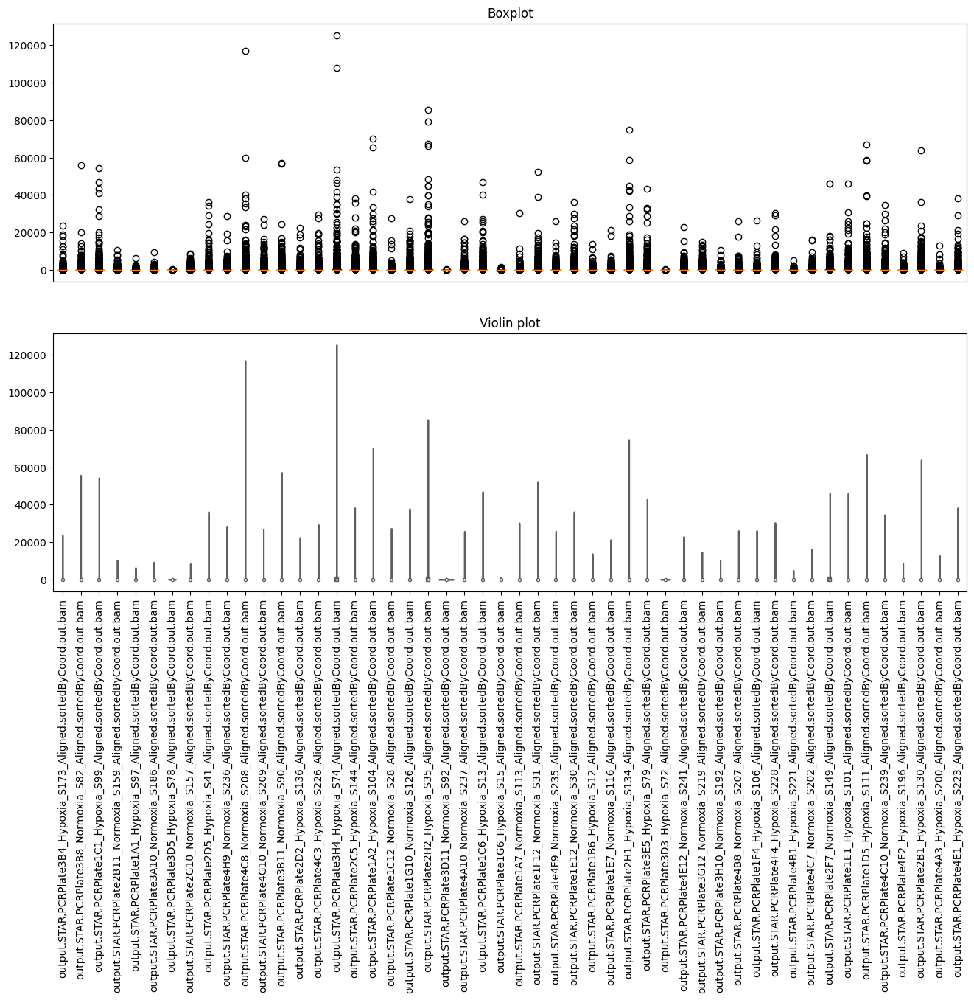

In [ ]:
#boxplot and violinplot of smaller dataframe
fig, axs = plt.subplots(2, figsize=(16,10))
axs[0].boxplot(h_unfiltered_small)
axs[0].set_title("Boxplot")
axs[0].get_xaxis().set_visible(False)

violionplot_unfiltered=sns.violinplot(data=h_unfiltered_small,palette="Set3",cut=0, ax = axs[1])
plt.setp(violionplot_unfiltered.get_xticklabels(), rotation=90);
axs[1].set_title("Violin plot")

plt.show()

The empty dots represent the outliers and we can see that most columns have them. From the above plots, one can easily identify the outliers.

As we indicated initially, to identify the outliers the z-score is a possible method. However, as we are going to confirm later, the distribution of the data is skewed and hence not normal, so we prefer not to use the z-score to identify the outliers.

So, we'll use the Inter-Quartile Range (IQR) proximity rule, which tells how spread the middle values are. From those values, we define an outlier as a point that falls more than $1.5\cdot IQR$ above the third quartile or below the first quartile.

Let's identify the outliers in the samples and in the genes with this method.

In [ ]:
column_outliers = {} # key:value is column:number of outliers
column_outliers_genes = {} # key:value is column: list of rows that are outliers

for col in h_unfiltered.columns:
    s = h_unfiltered[col]
    lower_quantile = s.quantile(0.25)
    upper_quantile = s.quantile(0.75)
    IQR = upper_quantile - lower_quantile
    boolean_out = (s < s.quantile(0.25) - 1.5 * IQR) | (s > s.quantile(0.75) + 1.5 * IQR)
    column_outliers[col] = boolean_out.value_counts().loc[True]

In [ ]:
column_outliers

{'output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam': 3512,
 'output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam': 3385,
 'output.STAR.PCRPlate1A1_Hypoxia_S97_Aligned.sortedByCoord.out.bam': 3442,
 'output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam': 5021,
 'output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam': 3336,
 'output.STAR.PCRPlate1A4_Hypoxia_S8_Aligned.sortedByCoord.out.bam': 4012,
 'output.STAR.PCRPlate1A5_Hypoxia_S108_Aligned.sortedByCoord.out.bam': 3578,
 'output.STAR.PCRPlate1A6_Hypoxia_S11_Aligned.sortedByCoord.out.bam': 3335,
 'output.STAR.PCRPlate1A7_Normoxia_S113_Aligned.sortedByCoord.out.bam': 3442,
 'output.STAR.PCRPlate1A8_Normoxia_S119_Aligned.sortedByCoord.out.bam': 3869,
 'output.STAR.PCRPlate1A9_Normoxia_S20_Aligned.sortedByCoord.out.bam': 3088,
 'output.STAR.PCRPlate1B11_Normoxia_S127_Aligned.sortedByCoord.out.bam': 3315,
 'output.STAR.PCRPlate1B12_Normoxia_S27_Aligned.sortedByCoord.out.bam': 344

In [ ]:
print("Total number of outliers in the sample cells: ", sum(list(column_outliers.values())))
print("Proportion of outliers in the sample cells: ", round(sum(list(column_outliers.values())) / h_unfiltered.size, 5))

Total number of outliers in the sample cells:  789983
Proportion of outliers in the sample cells:  0.13895


From the above lines, we see that 14% of the data is an outlier. This is an extremely high value for a dataset, but in our context, it's not surprising at all, given the sparsity we previously discussed.

Given the identified outliers, now there are different ways in which we could deal with them. We could:
- Drop the outliers
- Cap the outliers (Winsorize Method)
- Replace outliers using imputation as if they were missing values.

Now, we'll consider the outliers based on the IQR method. Let's start by dropping the outliers. Using this method, we essentially drop all the outliers from the data, excluding them from the analysis and modeling.

In [ ]:
#dropping outliers based on IQR
h_unfiltered_dropOutliers = h_unfiltered[~((h_unfiltered < (lower_quantile - 1.5 * IQR)) |(h_unfiltered > (upper_quantile + 1.5 * IQR))).any(axis=1)]
h_unfiltered_dropOutliers.head()

,output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A1_Hypoxia_S97_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A4_Hypoxia_S8_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A5_Hypoxia_S108_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A6_Hypoxia_S11_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A7_Normoxia_S113_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A8_Normoxia_S119_Aligned.sortedByCoord.out.bam,...,output.STAR.PCRPlate4G12_Normoxia_S243_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G1_Hypoxia_S193_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G2_Hypoxia_S198_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G6_Hypoxia_S232_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G7_Normoxia_S204_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam
WASH7P,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
CICP27,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
DDX11L17,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
WASH9P,0,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,1,0,1,0,0
OR4F29,2,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
h_unfiltered_dropOutliers.shape

(10720, 243)

We cut out more than half of the genes! Let's relook at the boxlplots and violin plots, again on a smaller dataset.

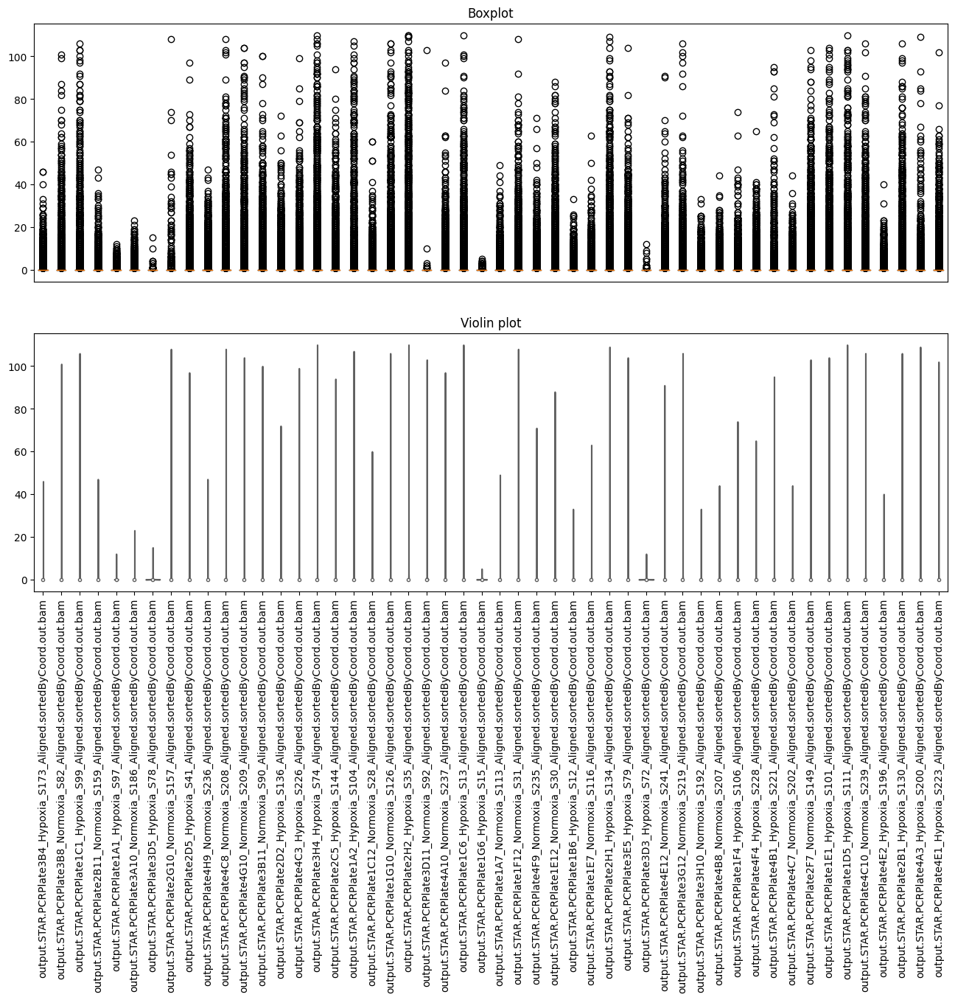

In [ ]:
#boxplot and violinplot of random 50 columns
h_unfiltered_dropOutliers_small = h_unfiltered_dropOutliers.iloc[:, random_columns]

fig, axs = plt.subplots(2, figsize=(16,10))
axs[0].boxplot(h_unfiltered_dropOutliers_small)
axs[0].set_title("Boxplot")
axs[0].get_xaxis().set_visible(False)

violionplot_unfiltered=sns.violinplot(data=h_unfiltered_dropOutliers_small,palette="Set3",cut=0, ax = axs[1])
plt.setp(violionplot_unfiltered.get_xticklabels(), rotation=90);
axs[1].set_title("Violin plot")

plt.show()

In [ ]:
#general statistics abbout dataframe without outliers
h_unfiltered_dropOutliers.describe()

,output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A1_Hypoxia_S97_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A4_Hypoxia_S8_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A5_Hypoxia_S108_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A6_Hypoxia_S11_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A7_Normoxia_S113_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A8_Normoxia_S119_Aligned.sortedByCoord.out.bam,...,output.STAR.PCRPlate4G12_Normoxia_S243_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G1_Hypoxia_S193_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G2_Hypoxia_S198_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G6_Hypoxia_S232_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G7_Normoxia_S204_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam
count,10720.000000,10720.000000,10720.000000,10720.000000,10720.000000,10720.000000,10720.000000,10720.000000,10720.000000,10720.000000,...,10720.000000,10720.000000,10720.000000,10720.000000,10720.000000,10720.000000,10720.000000,10720.000000,10720.000000,10720.000000
mean,1.171642,2.179944,0.129011,1.149813,0.482836,0.756063,1.505317,1.392071,0.428451,0.590578,...,1.088340,1.140765,0.647854,0.285541,0.312407,1.281063,0.513899,1.178638,0.362500,0.955410
std,4.951073,9.148758,0.657123,7.048017,2.352919,4.480484,7.599670,6.716919,2.312169,3.170822,...,4.500493,5.168263,3.288243,1.299277,1.476903,4.706342,2.226261,5.088313,1.629714,3.375975
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,86.000000,106.000000,12.000000,107.000000,55.000000,108.000000,108.000000,103.000000,49.000000,57.000000,...,87.000000,104.000000,80.000000,26.000000,29.000000,69.000000,46.000000,91.000000,35.000000,47.000000


In [ ]:
# zero elements
1 - (np.count_nonzero(h_unfiltered_dropOutliers.values) / h_unfiltered_dropOutliers.size)

0.8694336957189361

Notice that we have increased significantly the number of 0 entries in the dataframe.  In addition, even though we can easily spot the outliers from the boxplots, the range of values, namely the max, has dramatically decreased. Although this technique is quick and easy, removing the outliers might not be the best option. Indeed, having a sparse matrix, the outliers carry a lot of valuable information about the expression of genes. In addition, we have seen that we removed many genes from the data, so dropping them like this could introduce bias.

Another technique that we could adopt is capping the outliers. We essentially set a limit for the min and max outlier values and anything above or below the cap gets set to the capped min or max respectively. This technique is used when you can assume that all outliers express the same behaviors or patterns, meaning the model wouldn’t learn anything new by allowing the outliers to remain. 

In our case let's cap only the maximum since the minimum is 0.

In [ ]:
#capping outliers based on IQR
upper_limit = h_unfiltered.mean(axis = 0) + 3*h_unfiltered.std(axis = 0)
h_unfiltered_capOutliers = h_unfiltered.where(h_unfiltered < upper_limit, upper_limit, axis = 1)
h_unfiltered_capOutliers

,output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A1_Hypoxia_S97_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A4_Hypoxia_S8_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A5_Hypoxia_S108_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A6_Hypoxia_S11_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A7_Normoxia_S113_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A8_Normoxia_S119_Aligned.sortedByCoord.out.bam,...,output.STAR.PCRPlate4G12_Normoxia_S243_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G1_Hypoxia_S193_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G2_Hypoxia_S198_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G6_Hypoxia_S232_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G7_Normoxia_S204_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam
WASH7P,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,...,0.000000,0.0,0.0,0.000000,0.000000,0.00000,0.00000,0.000000,0.000000,0.000000
CICP27,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,...,0.000000,0.0,0.0,0.000000,0.000000,0.00000,0.00000,0.000000,0.000000,0.000000
DDX11L17,0.000000,0.000000,0.0,0.000000,0.0,1.0,0.000000,0.0,0.0,0.000000,...,0.000000,0.0,0.0,0.000000,0.000000,0.00000,0.00000,0.000000,0.000000,0.000000
WASH9P,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,1.0,0.000000,...,0.000000,0.0,0.0,0.000000,0.000000,1.00000,0.00000,1.000000,0.000000,0.000000
OR4F29,2.000000,0.000000,0.0,0.000000,0.0,0.0,1.000000,0.0,0.0,0.000000,...,0.000000,0.0,0.0,0.000000,0.000000,0.00000,0.00000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MT-TE,22.000000,43.000000,0.0,0.000000,0.0,3.0,47.000000,4.0,2.0,8.000000,...,24.000000,15.0,15.0,4.000000,4.000000,26.00000,1.00000,4.000000,4.000000,20.000000
MT-CYB,1688.163024,3151.001992,25.0,3081.498652,310.0,695.0,2747.721998,1552.0,366.0,1145.626301,...,1116.339815,1429.0,808.0,589.927603,435.329618,1439.05986,547.79784,1875.444745,581.476815,1183.574677
MT-TT,26.000000,62.000000,0.0,11.000000,4.0,0.0,41.000000,9.0,2.0,8.000000,...,48.000000,31.0,3.0,8.000000,5.000000,42.00000,1.00000,15.000000,6.000000,34.000000
MT-TP,66.000000,71.000000,1.0,3.000000,9.0,14.0,91.000000,22.0,3.0,30.000000,...,119.000000,52.0,11.0,22.000000,15.000000,48.00000,18.00000,36.000000,8.000000,79.000000


In [ ]:
#general statistic about dataframe with capped outliers
h_unfiltered_capOutliers.describe()

,output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A1_Hypoxia_S97_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A4_Hypoxia_S8_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A5_Hypoxia_S108_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A6_Hypoxia_S11_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A7_Normoxia_S113_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A8_Normoxia_S119_Aligned.sortedByCoord.out.bam,...,output.STAR.PCRPlate4G12_Normoxia_S243_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G1_Hypoxia_S193_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G2_Hypoxia_S198_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G6_Hypoxia_S232_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G7_Normoxia_S204_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam
count,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000,...,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000
mean,81.837650,173.206676,7.954905,124.246318,29.930523,36.475194,123.857080,111.668499,32.699175,36.807516,...,65.855337,88.331713,43.612460,24.500859,24.576064,89.436378,30.010850,90.088084,31.197853,64.412729
std,229.344463,451.587251,23.608572,367.362817,80.163083,135.745463,351.886344,321.035186,93.853686,121.397195,...,159.126548,231.871480,128.341292,68.884792,62.604230,212.925270,74.770177,239.465689,81.882080,168.298243
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,1.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,1.000000
75%,51.000000,125.000000,5.000000,40.000000,22.000000,17.000000,81.000000,76.000000,22.000000,18.000000,...,56.000000,67.000000,29.000000,18.000000,19.000000,76.000000,24.000000,68.000000,22.000000,44.000000
max,1688.163024,3151.001992,206.332884,3081.498652,653.356610,1683.191553,2747.721998,2748.058642,833.551387,1145.626301,...,1116.339815,1716.211315,1086.231029,589.927603,435.329618,1439.059860,547.797840,1875.444745,581.476815,1183.574677


Compared to the original dataset, we already see that the max is different. Let's visualize them

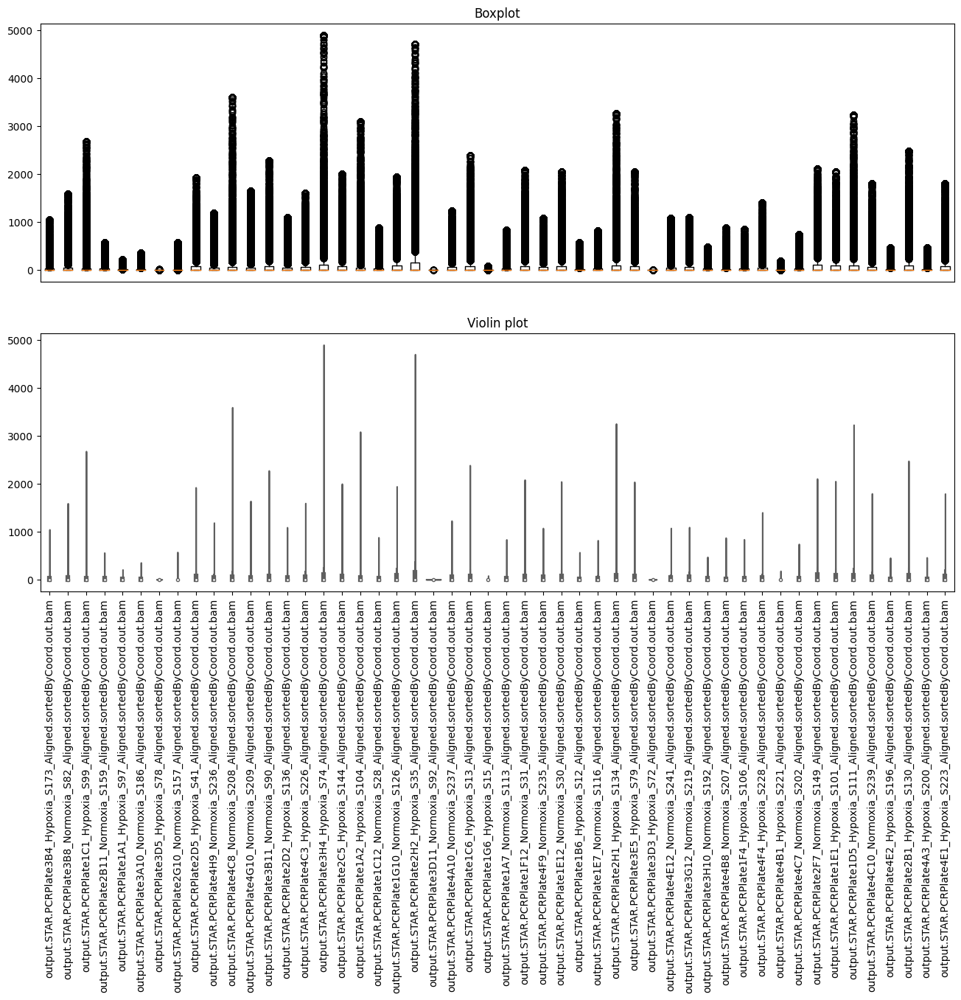

In [ ]:
#boxplots and violinplots of dataframe with capped outliers
h_unfiltered_capOutliers_small = h_unfiltered_capOutliers.iloc[:, random_columns]

fig, axs = plt.subplots(2, figsize=(16,10))
axs[0].boxplot(h_unfiltered_capOutliers_small)
axs[0].set_title("Boxplot")
axs[0].get_xaxis().set_visible(False)

violionplot_unfiltered=sns.violinplot(data=h_unfiltered_capOutliers_small,palette="Set3",cut=0, ax = axs[1])
plt.setp(violionplot_unfiltered.get_xticklabels(), rotation=90);
axs[1].set_title("Violin plot")

plt.show()


By capping, we seem to have also changed a bit the distribution density of values, since we can see the quantiles more clearly in some cases from the boxplot.

Lastly, we could replace outliers using imputation, as if they were missing values. For instance, we could replace outliers with the mean, or with other relevant statistics. So we treat them as if they were missing values.

In this case, we substitute them using the mean of the columns.

In [ ]:
#dataframe with outliers substitued with the mean
h_unfiltered_repOutliers = h_unfiltered.copy()

h_unfiltered_repOutliers[((h_unfiltered < (lower_quantile - 1.5 * IQR)) |(h_unfiltered > (upper_quantile + 1.5 * IQR))).any(axis=1)] = np.nan
for i in h_unfiltered_repOutliers.columns[h_unfiltered_repOutliers.isnull().any(axis=0)]: #applying Only on variables with NaN values
    h_unfiltered_repOutliers[i].fillna(h_unfiltered_repOutliers[i].mean(),inplace = True)

h_unfiltered_repOutliers


,output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A1_Hypoxia_S97_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A4_Hypoxia_S8_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A5_Hypoxia_S108_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A6_Hypoxia_S11_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A7_Normoxia_S113_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A8_Normoxia_S119_Aligned.sortedByCoord.out.bam,...,output.STAR.PCRPlate4G12_Normoxia_S243_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G1_Hypoxia_S193_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G2_Hypoxia_S198_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G6_Hypoxia_S232_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G7_Normoxia_S204_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam
WASH7P,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0000,0.00000
CICP27,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0000,0.00000
DDX11L17,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,...,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0000,0.00000
WASH9P,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,...,0.00000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000,0.0000,0.00000
OR4F29,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,...,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0000,0.00000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MT-TE,1.171642,2.179944,0.129011,1.149813,0.482836,0.756063,1.505317,1.392071,0.428451,0.590578,...,1.08834,1.140765,0.647854,0.285541,0.312407,1.281063,0.513899,1.178638,0.3625,0.95541
MT-CYB,1.171642,2.179944,0.129011,1.149813,0.482836,0.756063,1.505317,1.392071,0.428451,0.590578,...,1.08834,1.140765,0.647854,0.285541,0.312407,1.281063,0.513899,1.178638,0.3625,0.95541
MT-TT,1.171642,2.179944,0.129011,1.149813,0.482836,0.756063,1.505317,1.392071,0.428451,0.590578,...,1.08834,1.140765,0.647854,0.285541,0.312407,1.281063,0.513899,1.178638,0.3625,0.95541
MT-TP,1.171642,2.179944,0.129011,1.149813,0.482836,0.756063,1.505317,1.392071,0.428451,0.590578,...,1.08834,1.140765,0.647854,0.285541,0.312407,1.281063,0.513899,1.178638,0.3625,0.95541


In [ ]:
h_unfiltered_repOutliers.describe()

,output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A1_Hypoxia_S97_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A4_Hypoxia_S8_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A5_Hypoxia_S108_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A6_Hypoxia_S11_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A7_Normoxia_S113_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A8_Normoxia_S119_Aligned.sortedByCoord.out.bam,...,output.STAR.PCRPlate4G12_Normoxia_S243_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G1_Hypoxia_S193_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G2_Hypoxia_S198_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G6_Hypoxia_S232_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G7_Normoxia_S204_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam
count,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000,...,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000,23396.000000
mean,1.171642,2.179944,0.129011,1.149813,0.482836,0.756063,1.505317,1.392071,0.428451,0.590578,...,1.088340,1.140765,0.647854,0.285541,0.312407,1.281063,0.513899,1.178638,0.362500,0.955410
std,3.351313,6.192667,0.444797,4.770705,1.592658,3.032777,5.144111,4.546589,1.565075,2.146286,...,3.046321,3.498325,2.225766,0.879462,0.999695,3.185658,1.506925,3.444209,1.103131,2.285151
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,1.171642,2.179944,0.129011,1.149813,0.482836,0.756063,1.505317,1.392071,0.428451,0.590578,...,1.088340,1.140765,0.647854,0.285541,0.312407,1.281063,0.513899,1.178638,0.362500,0.955410
75%,1.171642,2.179944,0.129011,1.149813,0.482836,0.756063,1.505317,1.392071,0.428451,0.590578,...,1.088340,1.140765,0.647854,0.285541,0.312407,1.281063,0.513899,1.178638,0.362500,0.955410
max,86.000000,106.000000,12.000000,107.000000,55.000000,108.000000,108.000000,103.000000,49.000000,57.000000,...,87.000000,104.000000,80.000000,26.000000,29.000000,69.000000,46.000000,91.000000,35.000000,47.000000


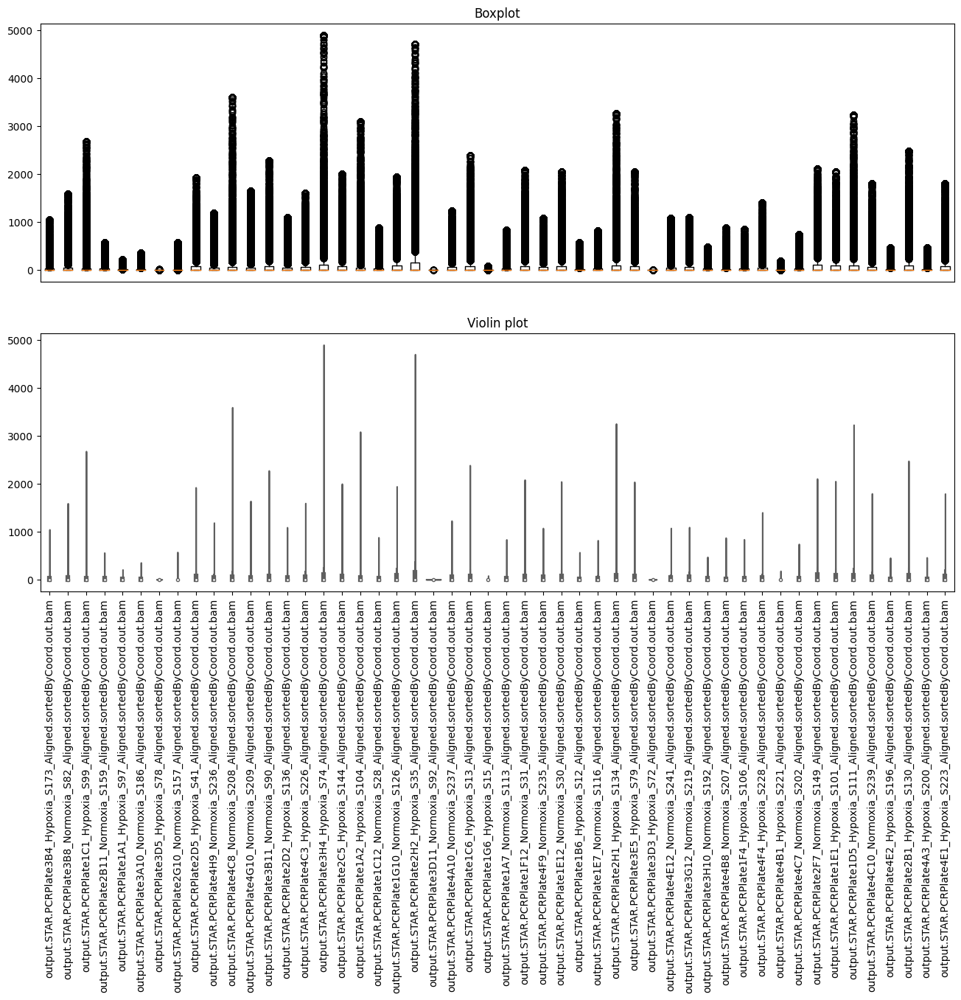

In [ ]:
#boxplot of dataframe with imputated outliers
h_unfiltered_repOutliers_small = h_unfiltered_repOutliers.iloc[:, random_columns]

fig, axs = plt.subplots(2, figsize=(16,10))
axs[0].boxplot(h_unfiltered_capOutliers_small)
axs[0].set_title("Boxplot")
axs[0].get_xaxis().set_visible(False)

violionplot_unfiltered=sns.violinplot(data=h_unfiltered_capOutliers_small,palette="Set3",cut=0, ax = axs[1])
plt.setp(violionplot_unfiltered.get_xticklabels(), rotation=90);
axs[1].set_title("Violin plot")

plt.show()

Once again, we can see how the range drops dramatically with respect to that of the original dataset. 

Overall, we can see that all the above techniques lead to different results. With these analyses, we can confirm our previous hypothesis: outliers convey most of the information, and removing them can lead to a significant loss of it. 

Let's go on with the data, as it is now.

### Distributions

Understanding the distribution is fundamental to gaining a further understanding of the data. Indeed, identifying intrinsic properties of the measurements (e.g. skewness, kurtosis) can be beneficial to later select appropriate feature selection and data normalization techniques. It can also help us in identifying which machine learning models might better fit the data, given that different algorithms have different assumptions about the distribution of data, and some may perform better than others for a particular type of distribution. For example, decision tree algorithms perform well for data with a hierarchical or tree-like structure, whereas clustering algorithms like K-means are more effective for data with a normal or Gaussian distribution.

First of all, let's visualize the histogram of a single column of our dataframe.


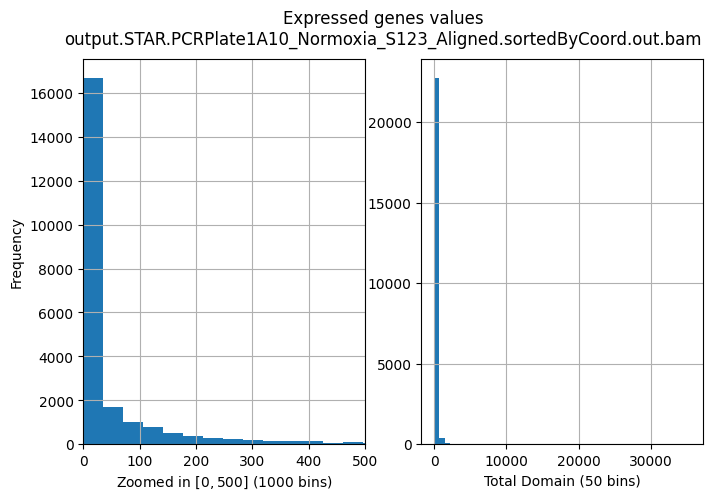

In [ ]:
#histogram of a single column
col = h_unfiltered.iloc[:, 0]
fig, axs = plt.subplots(1, 2, figsize=(8, 5))
col.hist(ax=axs[0], bins=1000)
col.hist(ax=axs[1], bins=50)
plt.suptitle(f"Expressed genes values\n{col.name}")
axs[0].set_xlim(0, 500)
axs[0].set_xlabel("Zoomed in $[0, 500]$ (1000 bins)")
axs[0].set_ylabel("Frequency")
axs[1].set_xlabel("Total Domain (50 bins)")
plt.show()

This plot, just like some plots done before, illustrates common features of RNA-seq count data:
- few counts associated with a large proportion of genes
- a long right tail
- large dynamic range

Firstly, we can say that the distribution is not normal. Indeed, it is very rare to find RNA-seq data with such a distribution of values.

Usually, in the field, the underlying distribution of the data can be seen either as a Poisson or a Negative binomial distribution (Gamma, in the continuous case).
Intuitively, these distributions make sense since, with RNA-Seq data, a very large number of RNAs are represented and the probability of pulling out a particular transcript is very small. 

Let's check which of the 2 distributions might work better in our case. These observations are important at this stage because they will hugely help us in the model selection and interpretation. It may not lead to incredibly better results, of course, yet it may be useful for a later analysis to be given to an expert in the field.[$^{[2]}$](https://www.biostars.org/p/84445/).
In particular, we want to analyze the relation between the mean and the variance of our data. Indeed, we know that, for the Poisson distribution, we have that the means equals the variance. 
So:

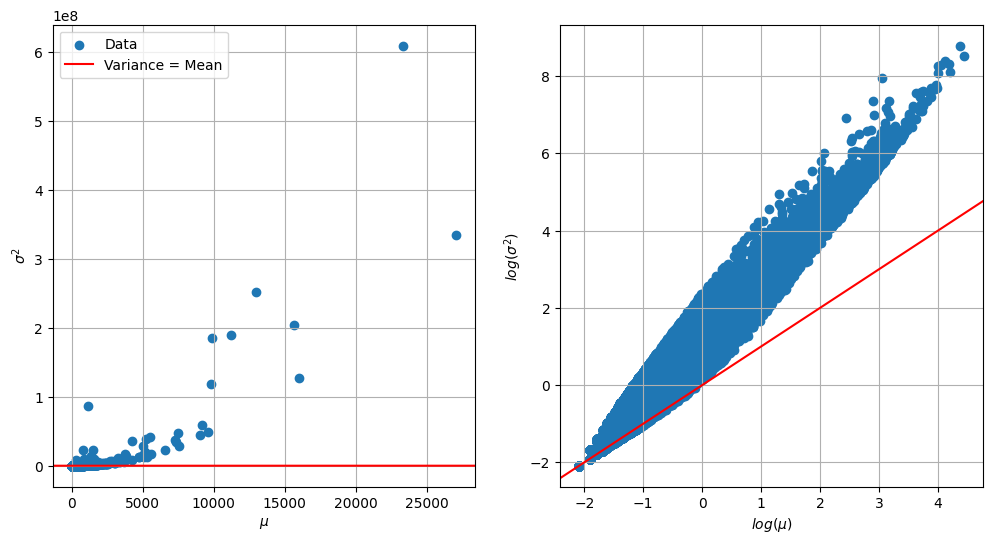

In [ ]:
h_unfiltered_var = h_unfiltered.var(axis = 1)
h_unfiltered_mean = h_unfiltered.mean(axis = 1)
# NOTES: df.var(axis=1) returns the variance for each gene

fig, ax = plt.subplots(1,2, figsize = (12,6))
ax[0].scatter(h_unfiltered_mean, h_unfiltered_var, label = "Data")
ax[0].set_xlabel("$\mu$")
ax[0].set_ylabel("$\sigma^2$")
ax[0].grid(True)
ax[0].axline((0,0), slope=1, color = 'r', label = "Variance = Mean")
ax[0].legend()

ax[1].scatter(h_unfiltered_mean.apply(np.log10), h_unfiltered_var.apply(np.log10), label = "Data")
ax[1].set_xlabel("$log(\mu$)")
ax[1].set_ylabel("$log(\sigma^2)$")
ax[1].grid(True)
ax[1] = plt.gca() 
ax[1].axline((0,0), slope=1, color = 'r', label = "Variance = Mean")


plt.show()

Since the scatter of the data points does not fall on the diagonal $y=x$, we infer that the mean is not equal to the variance, so the Poisson is not a good distribution. Indeed, for the genes with high mean expression, the variance across replicates tends to be greater than the mean (i.e. scatter is above the red line). Indeed, in our case we expect some amount of variability between samples, as some genes may fluctuate more because of counting noise, biological noise, technical artifacts, or because of their inherent nature, leading to variance and mean being different. 

In such cases, what is done is to assume that the biological variability follows a Gamma distribution. This is because we are first taking the data as coming from a Negative Binomial, and then we are taking its continuous version, that is the Gamma. Notice that it is a good approximation for data where $\mu < \sigma^2$, as is the case with our RNA-Seq count data.

Of course, this analysis has been more heuristic than statistically significant, yet it serves for us as a step to further understand the data.

Now, let's inspect the skewness and kurtosis of a single column. We remind the reader that kurtosis measures how much of the data in a probability distribution are centered around the middle (mean) vs. the tails. Skewness instead measures the relative symmetry of a distribution around the mean.

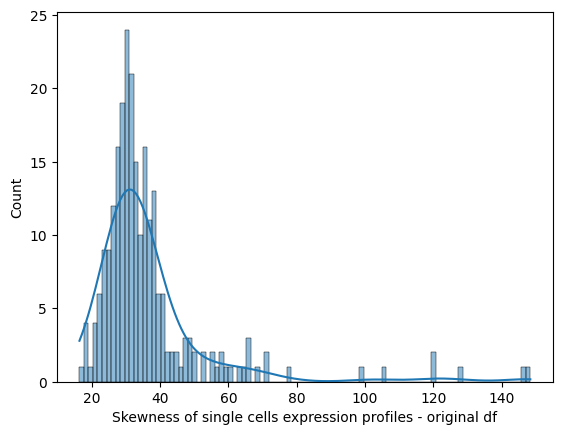

In [ ]:
#skewness of distribution
h_unfiltered_colnames = list(h_unfiltered.columns)

h_unfiltered_colN = np.shape(h_unfiltered)[1]
h_unfiltered_skew_cells = []
for i in range(h_unfiltered_colN):     
     v_df = h_unfiltered[h_unfiltered_colnames[i]]
     h_unfiltered_skew_cells += [skew(v_df)] 
h_unfiltered_skew_cells
sns.histplot(h_unfiltered_skew_cells, bins=100, kde = True)
plt.xlabel('Skewness of single cells expression profiles - original df')
plt.show()

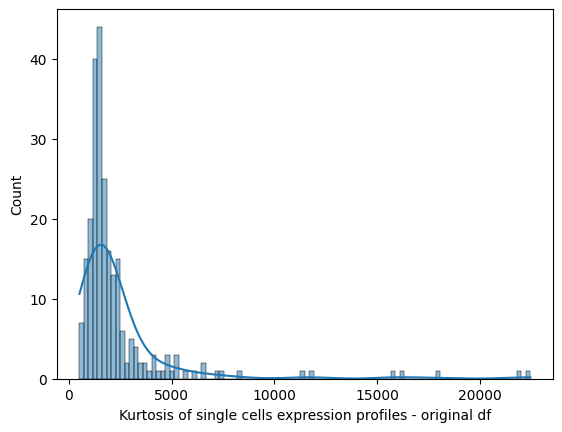

In [ ]:
#kurtosis of distribution
h_unfiltered_kurt_cells = []
for i in range(h_unfiltered_colN) :     
     v_df = h_unfiltered[h_unfiltered_colnames[i]]
     h_unfiltered_kurt_cells += [kurtosis(v_df)]
h_unfiltered_kurt_cells
ax = sns.histplot(h_unfiltered_kurt_cells,bins=100, kde = True)
plt.xlabel('Kurtosis of single cells expression profiles - original df')
plt.show()

Above we implemented a visual inspection for just one column. Let's now calculate skewness and kurtosis for all our cell samples. Obviously, given the large number of cells, we will not draw all the plots as done above.

In [ ]:
skewness_list = []
kurtosis_list = []

for col in h_unfiltered.columns:
  skewness_list.append(skew(h_unfiltered[col]))
  kurtosis_list.append(kurtosis(h_unfiltered[col]))

skewness_series = pd.Series(skewness_list)
kurtosis_series = pd.Series(kurtosis_list)

In [ ]:
print("Skewness\n", skewness_series.describe())
print("\nKurtosis\n", kurtosis_series.describe())

Skewness
 count    243.000000
mean      36.751122
std       18.480694
min       16.338221
25%       28.152079
50%       31.916505
75%       38.160192
max      148.449148
dtype: float64

Kurtosis
 count      243.000000
mean      2396.136519
std       2863.195768
min        517.397336
25%       1284.294844
50%       1594.813876
75%       2289.665638
max      22440.678861
dtype: float64


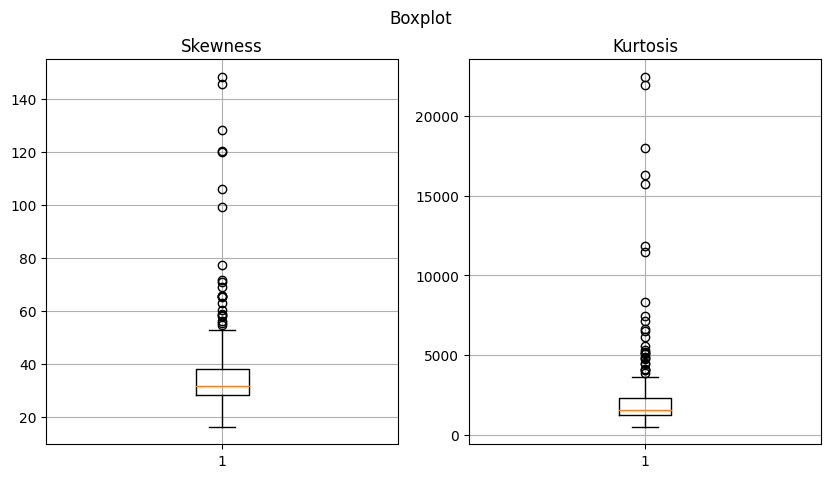

In [ ]:
# boxplot of skewness
fig, ax = plt.subplots(1, 2, figsize=(10,5))
plt.suptitle("Boxplot")
ax[0].boxplot(skewness_series)
ax[0].grid(True)
ax[0].set_title("Skewness")
ax[1].boxplot(kurtosis_series)
ax[1].grid(True)
ax[1].set_title("Kurtosis")
plt.show()

High values of skewness indicate low symmetry (e.g. the Gaussian has 0 skewness because it's symmetric) and high kurtosis indicates heavy tails. Thus, from the above summary tables and plots, we can clearly see that the distributions are highly non-normal, skewed with heavy tails. This is typically not ideal to analyze for different reasons that we list now:
- Biased estimates: non-normal data can lead to biased parameter estimates, which can affect the accuracy of the machine learning model. For instance, in linear regression, the estimates of the regression coefficients can be biased if the distribution of the response variable is non-normal.
- Overfitting: machine learning models can be susceptible to overfitting when the data is highly skewed or has heavy tails, resulting in poor performance on unseen data. It can lead to outlier values that are poorly fit by the model, leading to poor generalization performance.
- Incorrect assumptions: many machine learning algorithms assume that the data is normally distributed or at least symmetric. Non-normal data can violate these assumptions, leading to poor performance or incorrect predictions.

By addressing the issue, one can improve the accuracy and reliability of machine learning models.

### Correlation

We now want to check the correlation between samples and features. First, we proceed at looking the correlation between samples.

In order to analyze correlation, 2 main measures are used:
- Pearson correlation coefficient. It is a bivariate correlation coefficient, that measures the linear correlation between two sets of data.
-  Spearman's rank correlation. It is a nonparametric measure of rank correlation. It assesses how well the relationship between two variables can be described using a monotonic function. So it assesses monotonic relationships.

Number of cells included:  (243, 243)
Average between minimum and maximum correlation:  0.4992953213403934
Average correlation of expression profiles between genes:  0.7415974004285172


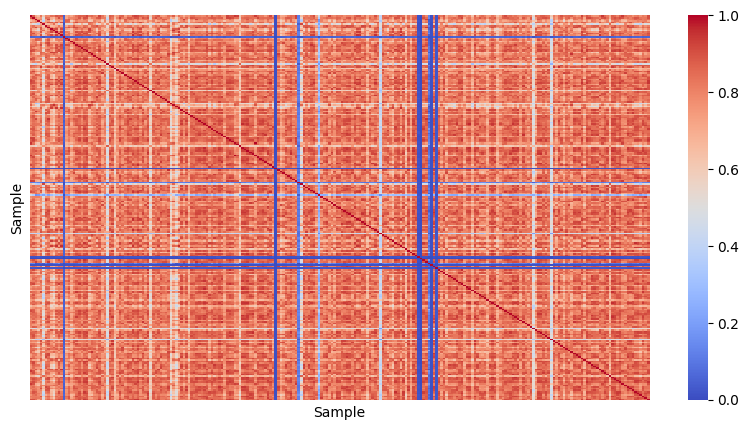

In [ ]:
#pearson correlation coefficient
corr_matrix_p = h_unfiltered.corr(method = 'pearson')

average = (corr_matrix_p.values.max() - corr_matrix_p.values.min()) /2 + corr_matrix_p.values.min()
print("Number of cells included: ", np.shape(corr_matrix_p))
print("Average between minimum and maximum correlation: ", average)
print("Average correlation of expression profiles between genes: ", corr_matrix_p.mean().mean())

plt.figure(figsize=(10,5))
sns.heatmap(corr_matrix_p, cmap='coolwarm', yticklabels = False, xticklabels = False)
plt.xlabel('Sample')
plt.ylabel('Sample')
plt.show()

Number of cells included:  (243, 243)
Average between minimum and maximum correlation:  0.5064551445608162
Average correlation of expression profiles between genes:  0.6902432014490262


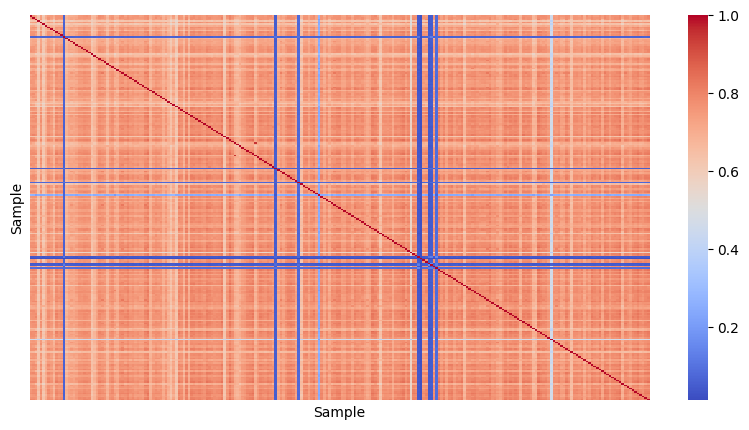

In [ ]:
#spearman correlation coefficient
corr_matrix_s = h_unfiltered.corr(method = 'spearman')

average = (corr_matrix_s.values.max() - corr_matrix_s.values.min()) /2 + corr_matrix_s.values.min()
print("Number of cells included: ", np.shape(corr_matrix_s))
print("Average between minimum and maximum correlation: ", average)
print("Average correlation of expression profiles between genes: ", corr_matrix_s.mean().mean())

plt.figure(figsize=(10,5))
sns.heatmap(corr_matrix_s, cmap='coolwarm', yticklabels = False, xticklabels = False)
plt.xlabel('Sample')
plt.ylabel('Sample')
plt.show()

Immediately we see that most cells are positively correlated between them. However, notice that there seems to be no correlation between some samples. To check this, we can compute the minimum correlation. From now on, we are going to analyse the correlation using the Pearson correlation coefficient. 


In [ ]:
print("Min. correlation of expression profiles between cells: ", corr_matrix_p.values.min())

Min. correlation of expression profiles between cells:  -0.0014093573192132602


This confirms that the correlation is mainly positive. By looking at the graph, moreover, we see some blue lines corresponding to some cells: these are the cells that have a low correlation with all other cells.

We now can plot the distribution of the correlation between gene expression profiles using a histogram (we do it on the first five variables in order not to lose too much time).

[]

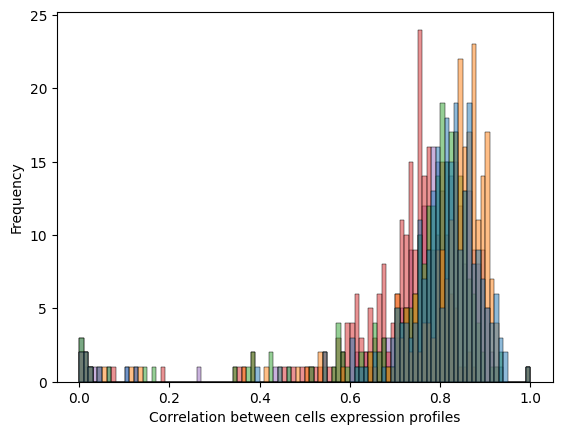

In [ ]:
c = corr_matrix_p

c_small=corr_matrix_p.iloc[:,:5]
sns.histplot(c_small,bins=100)
plt.legend().set_visible(False);
plt.ylabel('Frequency')
plt.xlabel('Correlation between cells expression profiles')
plt.plot()

We immediately see that the correlation is fairly high.

Some genes will be characteristic of some cells. For example in our case we expect some genes to be expressed at high levels only in cells cultured in conditions of low oxygen (hypoxia), or vice versa. However, most of the low and/or high-expressed genes will tend to be generally similar. Several genes will have a high expression across cells as they are housekeeping genes needed for the basic functioning of the cell. Some genes will have low expression across cells as they are less or not essential for normal functioning, so they will have low or no expression across cells and will only be expressed in specific circumstances.

Now, we want to focus on the distribution of cells that have a low correlation with all the others, in order to understand why this happens, and what are its properties.

First, we want to define cells that are not much correlated with others. We do so by saying that the average correlation with all the other cells is smaller than a threshold that we define, and we pick some of the lowest and the highest correlated cells.

In [ ]:
#find low and high correlated cells
correlation_threshold = 0.65

low_corr_cells = (corr_matrix_p.sum(axis = 0) / corr_matrix_p.shape[1] ) <= correlation_threshold
high_corr_cells = ((corr_matrix_p.sum(axis = 0) / corr_matrix_p.shape[1] ) > correlation_threshold) & ((corr_matrix_p.sum(axis = 0) / corr_matrix_p.shape[1] ) <= 0.82)
very_high_corr_cells = (corr_matrix_p.sum(axis = 0) / corr_matrix_p.shape[1] ) > 0.82

Now, let's analyse the distribution of the low correlated cells.

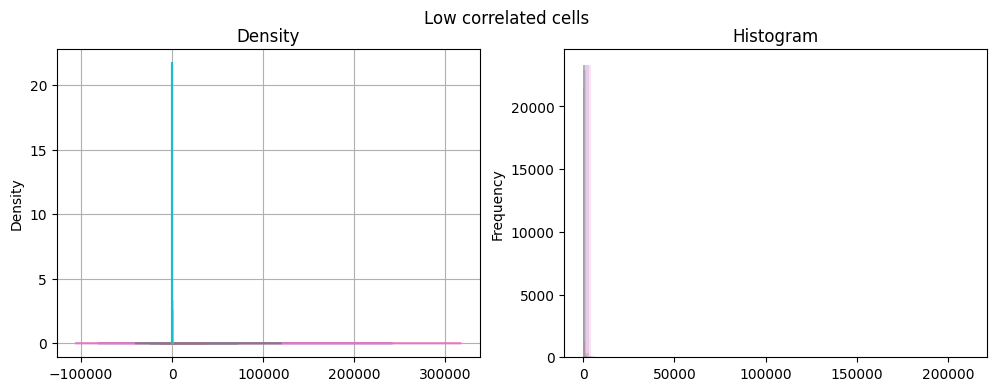

In [ ]:
low_corr = h_unfiltered.loc[:, low_corr_cells]

# 10 densities
fig, ax = plt.subplots(1,2, figsize=(12,4))
plt.suptitle("Low correlated cells")
for s in low_corr.columns[:10]:
    low_corr[s].plot.density(legend = False, ax = ax[0])  
ax[0].grid(True)
ax[0].set_title("Density")
 
for s in low_corr.columns[:10]:
    ax[1].hist(low_corr[s], bins = 50, alpha = 0.2)
ax[1].set_ylabel("Frequency")
ax[1].set_title("Histogram")
plt.show()

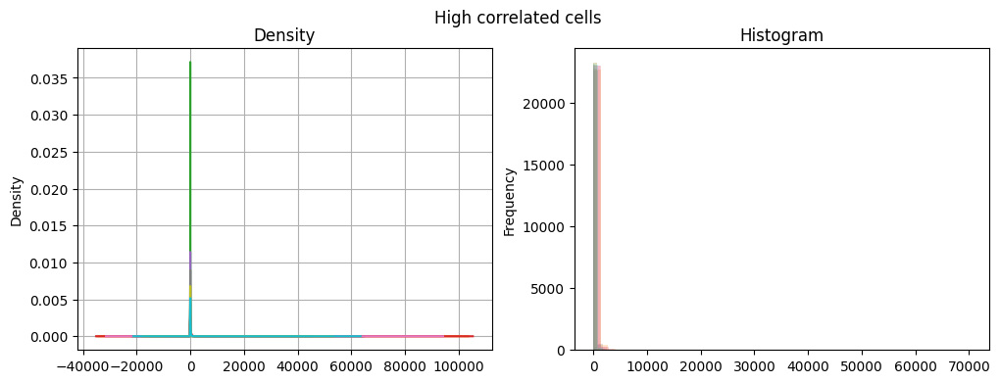

In [ ]:
high_corr = h_unfiltered.loc[:, high_corr_cells]

# 10 densities
fig, ax = plt.subplots(1,2, figsize=(12,4))
plt.suptitle("High correlated cells")
for s in high_corr.columns[:10]:
    high_corr[s].plot.density(legend = False, ax = ax[0])  
ax[0].grid(True)
ax[0].set_title("Density")
 
for s in high_corr.columns[:10]:
    ax[1].hist(high_corr[s], bins = 50, alpha = 0.2)
ax[1].set_ylabel("Frequency")
ax[1].set_title("Histogram")
plt.show()

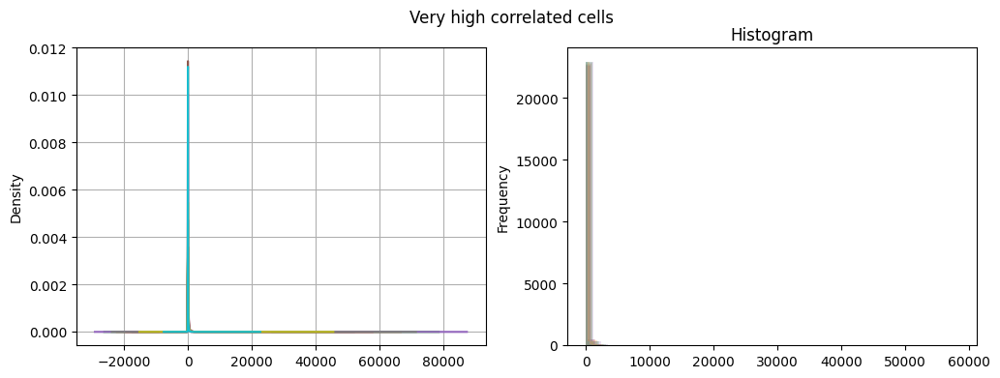

In [ ]:
very_high_corr = h_unfiltered.loc[:, very_high_corr_cells]

# 10 densities
fig, ax = plt.subplots(1,2, figsize=(12,4))
plt.suptitle("Very high correlated cells")
for s in very_high_corr.columns[:10]:
    very_high_corr[s].plot.density(legend = False, ax = ax[0])  
ax[0].grid(True)
ax[1].set_title("Density")
 
for s in very_high_corr.columns[:10]:
    ax[1].hist(very_high_corr[s], bins = 50, alpha = 0.2)
ax[1].set_ylabel("Frequency")
ax[1].set_title("Histogram")
plt.show()

From the distributions, we see that the uncorrelated cells are cells that contain mostly 0, and nothing else, that is that are not very much expressed. For highly correlated cells, we notice that they are expressed more (they are not all 0).

We are going to analyze them more closely in the QC of cells. Let's check this: 

In [ ]:
#average
print("Average expression low correlation: ", low_corr.mean().mean())
print("Average expression high correlation: ", high_corr.mean().mean())
print("Average expression very high correlation: ", very_high_corr.mean().mean())

Average expression low correlation:  57.40654599076767
Average expression high correlation:  88.32132911770113
Average expression very high correlation:  93.48608930819564


In [ ]:
#sparsity of low_corr, high_corr and very_high_corr
sparsity_index_low = 1 - (np.count_nonzero(low_corr.values) / low_corr.size)
sparsity_index_high = 1 - (np.count_nonzero(high_corr.values) / high_corr.size)
sparsity_index_very_high = 1 - (np.count_nonzero(very_high_corr.values) / very_high_corr.size)
print("Low correlation: ", sparsity_index_low)
print("High correlation: ", sparsity_index_high)
print("Very high correlation: ", sparsity_index_very_high)

Low correlation:  0.7719717045648828
High correlation:  0.5400263954167299
Very high correlation:  0.5254394690623105


Notice that low-correlated cells have a more sparse expression with respect to the other ones. So, in general, they are less expressed.

Now, we are interested in how hypoxic and normoxic cells relate with each other. So, we want to analyze, using the Pearson correlation coefficient, the correlation between hypoxic and normoxic cells between them.

Hypoxic:
Number of cells included:  (126, 126)
Average between minimum and maximum correlation:  0.5011429766677863
Average correlation of expression profiles between genes:  0.753932347277663
Min. correlation of expression profiles between cells:  0.002285953335572634
Normoxic:
Number of cells included:  (117, 117)
Average between minimum and maximum correlation:  0.4999420654859071
Average correlation of expression profiles between genes:  0.7690283993129178
Min. correlation of expression profiles between cells:  -0.0001158690281858835
Mixed:
Number of cells included:  (117, 126)
Average between minimum and maximum correlation:  0.47056526656198905
Average correlation of expression profiles between genes:  0.7222196850606707
Min. correlation of expression profiles between cells:  -0.0014093573192132602


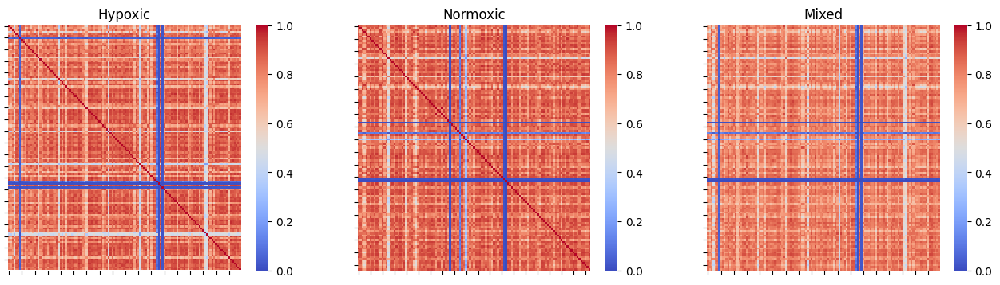

In [ ]:
normoxic_cells = h_unfiltered.columns[h_unfiltered.columns.str.contains('Normoxia')].tolist()
hypoxic_cells = h_unfiltered.columns[h_unfiltered.columns.str.contains('Hypoxia')].tolist()

#correlation matrix between hypoxic cells
corr_matrix_hypoxic = corr_matrix_p.loc[hypoxic_cells, hypoxic_cells]
corr_matrix_hypoxic
print("Hypoxic:")
average = (corr_matrix_hypoxic.values.max() - corr_matrix_hypoxic.values.min()) /2 + corr_matrix_hypoxic.values.min()
print("Number of cells included: ", np.shape(corr_matrix_hypoxic))
print("Average between minimum and maximum correlation: ", average)
print("Average correlation of expression profiles between genes: ", corr_matrix_hypoxic.mean().mean())
print("Min. correlation of expression profiles between cells: ", corr_matrix_hypoxic.values.min())

#correlation matrix between normoxic cells
corr_matrix_normoxic = corr_matrix_p.loc[normoxic_cells, normoxic_cells]
corr_matrix_normoxic
print("Normoxic:")
average = (corr_matrix_normoxic.values.max() - corr_matrix_normoxic.values.min()) /2 + corr_matrix_normoxic.values.min()
print("Number of cells included: ", np.shape(corr_matrix_normoxic))
print("Average between minimum and maximum correlation: ", average)
print("Average correlation of expression profiles between genes: ", corr_matrix_normoxic.mean().mean())
print("Min. correlation of expression profiles between cells: ", corr_matrix_normoxic.values.min())

#correlation matrix between mixed cells
corr_matrix_mixed = corr_matrix_p.loc[normoxic_cells, hypoxic_cells]
corr_matrix_mixed
print("Mixed:")
average = (corr_matrix_mixed.values.max() - corr_matrix_mixed.values.min()) /2 + corr_matrix_mixed.values.min()
print("Number of cells included: ", np.shape(corr_matrix_mixed))
print("Average between minimum and maximum correlation: ", average)
print("Average correlation of expression profiles between genes: ", corr_matrix_mixed.mean().mean())
print("Min. correlation of expression profiles between cells: ", corr_matrix_mixed.values.min())

#Statistics:
fig, ax =plt.subplots(1,3, figsize = (16,4))

sns.heatmap(corr_matrix_hypoxic, cmap='coolwarm', ax=ax[0], vmin=0, vmax=1)
ax[0].set(title='Hypoxic', xticklabels=[], yticklabels=[])

sns.heatmap(corr_matrix_normoxic, cmap='coolwarm', ax=ax[1], vmin=0, vmax=1)
ax[1].set(title='Normoxic', xticklabels=[], yticklabels=[])

sns.heatmap(corr_matrix_mixed, cmap='coolwarm', ax=ax[2], vmin=0, vmax=1)
ax[2].set(title='Mixed', xticklabels=[], yticklabels=[])

plt.show()


The patterns seems to be similar. 

Now we are interested in the analysis of the correlation of genes. Let's first use again Pearson and Spearman correlation coefficients.

Number of cells included:  (3000, 3000)
Average between minimum and maximum correlation:  0.40951765039846083
Average correlation of expression profiles between genes:  0.10065979641750304
Min. correlation of expression profiles between genes:  -0.1809646992030784


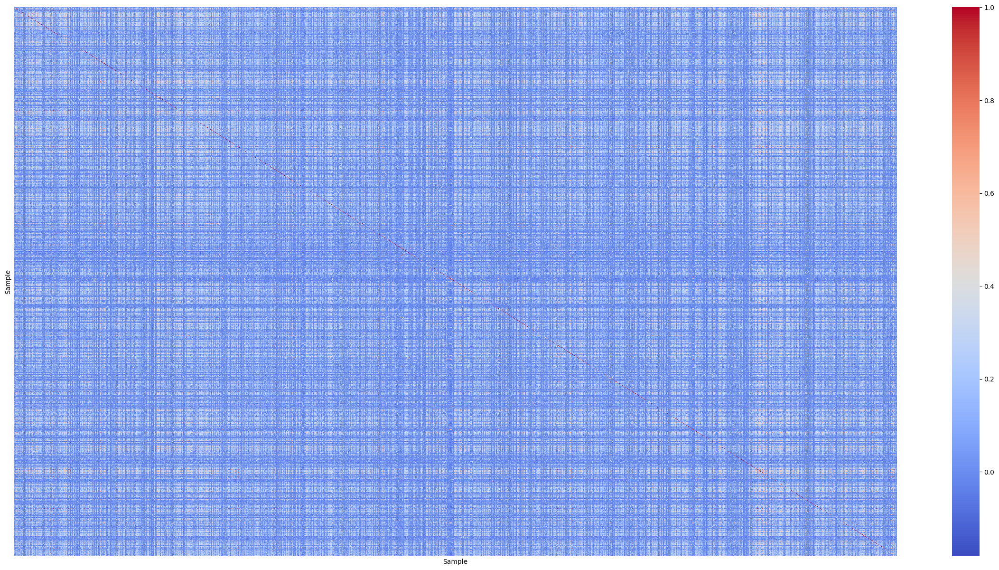

In [ ]:
#pearson correlation coefficient
corr_matrix_p = h_unfiltered[:3000].transpose().corr(method = 'pearson')

average = (corr_matrix_p.values.max() - corr_matrix_p.values.min()) /2 + corr_matrix_p.values.min()
print("Number of cells included: ", np.shape(corr_matrix_p))
print("Average between minimum and maximum correlation: ", average)
print("Average correlation of expression profiles between genes: ", corr_matrix_p.mean().mean())
print("Min. correlation of expression profiles between genes: ", corr_matrix_p.values.min())

plt.figure(figsize=(30,15))
sns.heatmap(corr_matrix_p, cmap='coolwarm', yticklabels = False, xticklabels = False)
plt.xlabel('Sample')
plt.ylabel('Sample')
plt.show()

Number of cells included:  (3000, 3000)
Average between minimum and maximum correlation:  0.29213312959730087
Average correlation of expression profiles between genes:  0.10205742345782395
Min. correlation of expression profiles between genes:  -0.41573374080539827


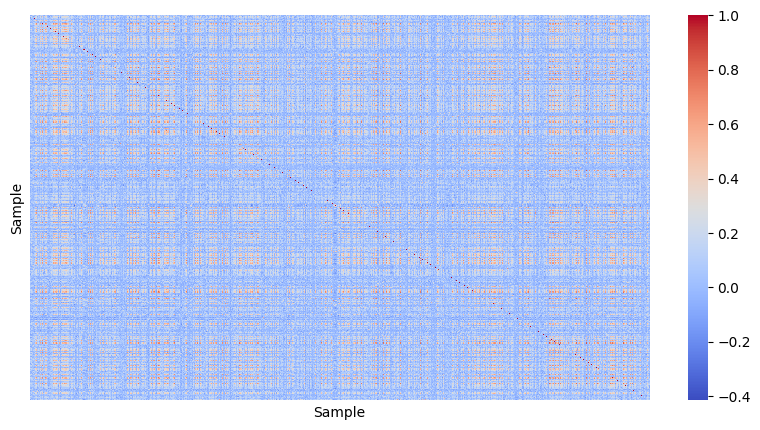

In [ ]:
#spearman correlation coefficient
corr_matrix_s = h_unfiltered[:3000].transpose().corr(method = 'spearman')

average = (corr_matrix_s.values.max() - corr_matrix_s.values.min()) /2 + corr_matrix_s.values.min()
print("Number of cells included: ", np.shape(corr_matrix_s))
print("Average between minimum and maximum correlation: ", average)
print("Average correlation of expression profiles between genes: ", corr_matrix_s.mean().mean())
print("Min. correlation of expression profiles between genes: ", corr_matrix_s.values.min())

plt.figure(figsize=(10,5))
sns.heatmap(corr_matrix_s, cmap='coolwarm', yticklabels = False, xticklabels = False)
plt.xlabel('Sample')
plt.ylabel('Sample')
plt.show()

Notice that for both correlation coefficients, most of the genes don't seem to be correlated.
Especially when looking at the Pearson correlation coefficient, there doesn't seem to be a structure overall.

# **Data Preprocessing**

In the Exploratory Data Analysis (EDA) we analyzed the data we have at our disposal, without intervening. Recalling that our task is to classify hypoxic and normoxic cells, we now want to transform the data so that the classification task is as accurate as possible. Note, that will not be working with the _metadata_ dataset anymore, since it will not be used for the classification task.

In [ ]:
# reupload the unfiltered file to avoid having conflicts with before
h_unfiltered = pd.read_csv(path_h_unfiltered, sep = " ")

In order to preprocess the data to be analyzed, we will need to run different steps which are considered best practices ([Luecken and Theis, 2019](https://www.embopress.org/doi/epdf/10.15252/msb.20188746)), that we list briefly now:
- Quality Control (QC)
- Normalization and Scaling
- Feature Selection and Dimensionality Reduction

We'll try the above procedures in order to make the data sufficiently good for the later downstream analysis.

## Quality Control (QC)

In this step, we want to prepare the data such that it is of the highest possible quality. Of course, such quality cannot be determined _a priori_ and will need to be revised in a cyclic way with the downstream analysis. This is why we want to stress the fact that due to time and domain-knowledge constraints, the filtering choices we have adopted may be suboptimal.

### QC for Cells

Now, we want to remove low-quality cells, that might have come, for instance, from sequencing errors or dead cells. QC is done based on the following three covariates:
- Number of counts per cell (i.e. the count depth or library size)
- Number of detected genes per cell
- Fraction of mitochondrial genes count (denoted by MT) per cell

We'll need to consider them together, since considering them alone may lead to misinterpretation. Our goal is to examine the distribution of these three covariates and identify the outliers, which will be determined by a threshold.

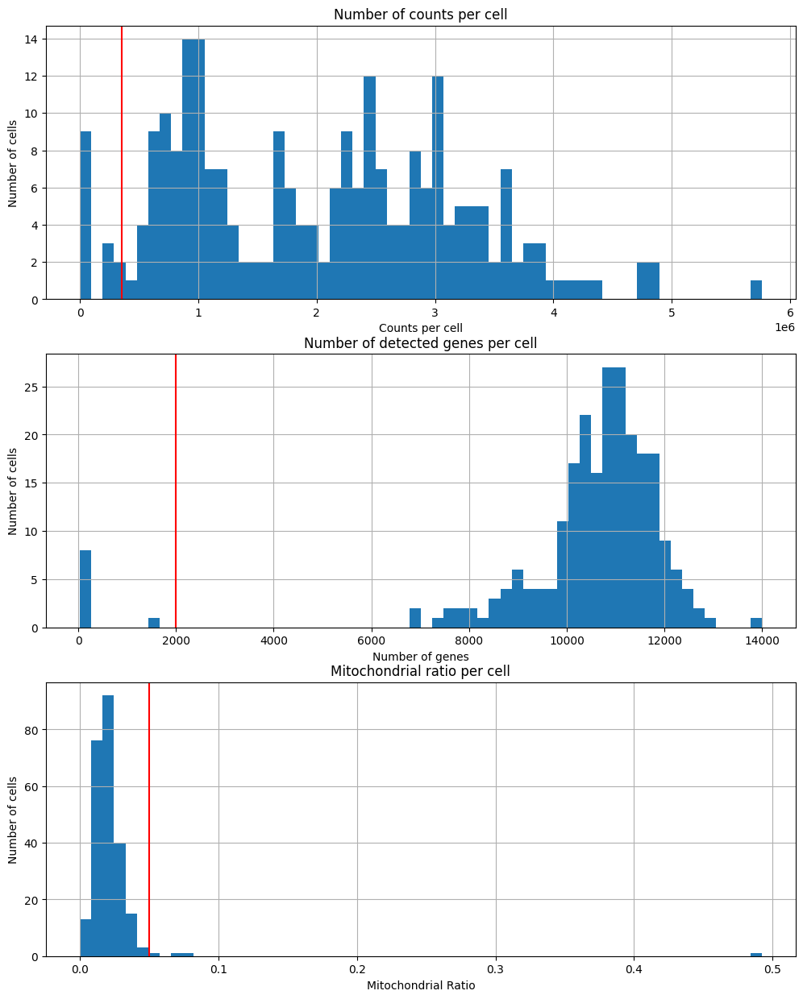

In [ ]:
counts_per_cell = h_unfiltered.sum(axis = 0) # number of counts per cell
number_of_genes = np.count_nonzero(h_unfiltered, axis=0) #number of detected genes count
#mitochondrial count
mitochondrial_genes = h_unfiltered.index.str.startswith("MT-")
mitochondrial_threshold = 0.05
mitochondrial_ratio = h_unfiltered.loc[mitochondrial_genes, :].sum() / counts_per_cell

counts_per_cell_threshold = 350000
number_of_genes_threshold = 2000
mitochondrial_threshold = 0.05

#plotting
fig, ax = plt.subplots(3, 1, figsize = (12, 15))

ax[0].set_title("Number of counts per cell")
ax[0].hist(counts_per_cell, bins = 60)
ax[0].axvline(counts_per_cell_threshold, color = "r")
ax[0].set_xlabel("Counts per cell")
ax[0].set_ylabel("Number of cells")
ax[0].grid(True)
ax[1].set_title("Number of detected genes per cell")
ax[1].hist(number_of_genes, bins = 60)
ax[1].axvline(number_of_genes_threshold, color = "r")
ax[1].set_xlabel("Number of genes")
ax[1].set_ylabel("Number of cells")
ax[1].grid(True)
ax[2].set_title("Mitochondrial ratio per cell")
ax[2].hist(mitochondrial_ratio, bins = 60)
ax[2].axvline(mitochondrial_threshold, color = "r")
ax[2].set_xlabel("Mitochondrial Ratio")
ax[2].set_ylabel("Number of cells")
ax[2].grid(True)

plt.show()

As mentioned above, in cell QC these covariates should be considered jointly. Indeed, cells with a just relatively high fraction of mitochondrial counts might for example be involved in respiratory processes and should not be filtered out. But when a cell has a low number of detected genes, a low count depth, and a high fraction of mitochondrial counts it might have a broken membrane which can indicate a dying cell, which should be removed, as they're not the target of our analysis. It is therefore preferred to consider all covariates when thresholding decisions on single covariates are made. 

Given that this step is based on common sense, rather than on statistical tests, it is important to set the thresholds as permissive as possible to avoid filtering out viable cell populations unintentionally.

Therefore, using the above-defined thresholds:

In [ ]:
#filtering wrt 3 metrics
h_unfiltered_filtered = h_unfiltered.loc[:, (mitochondrial_ratio < mitochondrial_threshold) & (number_of_genes > number_of_genes_threshold) & (counts_per_cell > counts_per_cell_threshold)]
h_unfiltered_filtered

,output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A4_Hypoxia_S8_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A5_Hypoxia_S108_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A6_Hypoxia_S11_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A7_Normoxia_S113_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A8_Normoxia_S119_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A9_Normoxia_S20_Aligned.sortedByCoord.out.bam,...,output.STAR.PCRPlate4G12_Normoxia_S243_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G1_Hypoxia_S193_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G2_Hypoxia_S198_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G6_Hypoxia_S232_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G7_Normoxia_S204_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam
WASH7P,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
CICP27,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
DDX11L17,0,0,0,0,1,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
WASH9P,0,0,0,0,0,0,0,1,0,0,...,0,0,0,0,0,1,0,1,0,0
OR4F29,2,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MT-TE,22,43,0,0,3,47,4,2,8,17,...,24,15,15,4,4,26,1,4,4,20
MT-CYB,4208,6491,4819,310,695,2885,1552,366,1829,3387,...,1119,1429,808,999,916,3719,984,2256,981,2039
MT-TT,26,62,11,4,0,41,9,2,8,9,...,48,31,3,8,5,42,1,15,6,34
MT-TP,66,71,3,9,14,91,22,3,30,37,...,119,52,11,22,15,48,18,36,8,79


Hence, we have reduced to 229 cells. The QC procedure could be extended even more and be more thorough, but we decide to stop here as it seems satisfactory enough.

In [ ]:
h_unfiltered = h_unfiltered_filtered.copy()

### QC for Genes

After removing low-quality cells, we want to get rid of low-quality genes. One could identify many types of low-quality genes based on different metrics, but for our purpose, we'll remove duplicate rows only.

By duplicate row, we mean data corresponding to different genes that have exactly the same number of counts. There could be many reasons why this happens. They could be the same entity as there is redundancy in gene annotation, or they could reflect other issues, for example when in the same region there are overlapping gene annotations. Not removing duplicates could lead to problems, such as false positive findings, misleading clustering patterns, model over-fitting issues, and more generally bias induction.

Still, it is fundamental to recognize that the gene that has been dropped could be the one corresponding to the most recurring annotation in previous studies; so it needs to be noted and recorded, as it could create issues with data interpretation later on.

In [ ]:
#find duplicated rows
h_unfiltered_duplicate_rows = h_unfiltered[h_unfiltered.duplicated(keep=False)]
print("number of duplicate rows: ", h_unfiltered_duplicate_rows.shape[0])
print("duplicates: ")
h_unfiltered_duplicate_rows

number of duplicate rows:  139
duplicates: 


,output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A4_Hypoxia_S8_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A5_Hypoxia_S108_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A6_Hypoxia_S11_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A7_Normoxia_S113_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A8_Normoxia_S119_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A9_Normoxia_S20_Aligned.sortedByCoord.out.bam,...,output.STAR.PCRPlate4G12_Normoxia_S243_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G1_Hypoxia_S193_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G2_Hypoxia_S198_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G6_Hypoxia_S232_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G7_Normoxia_S204_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam
MMP23A,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
LINC01647,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
CSF3R,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
PTGFR,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
LINC01361,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
LHB,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
FPR1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
LILRB2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
TMEM150B,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
#index of duplicated rows
print("names of duplicate rows: ",h_unfiltered_duplicate_rows.index)

names of duplicate rows:  Index(['MMP23A', 'LINC01647', 'CSF3R', 'PTGFR', 'LINC01361', 'ITGA10', 'RORC',
       'GPA33', 'SELE', 'OR2M4',
       ...
       'MIR1-1HG-AS1', 'CHRNA4', 'OR7G2', 'LINC00661', 'PLVAP', 'LHB', 'FPR1',
       'LILRB2', 'TMEM150B', 'POM121L7P'],
      dtype='object', length=139)


We could check case by case whether to remove. First let's understand where the duplicates really are.

In [ ]:
#correlation matrix of duplicated rows
h_unfiltered_duplicate_rows_t = h_unfiltered_duplicate_rows.T
h_unfiltered_duplicate_rows_t
c_dupl = h_unfiltered_duplicate_rows_t.corr()
c_dupl

,MMP23A,LINC01647,CSF3R,PTGFR,LINC01361,ITGA10,RORC,GPA33,SELE,OR2M4,...,MIR1-1HG-AS1,CHRNA4,OR7G2,LINC00661,PLVAP,LHB,FPR1,LILRB2,TMEM150B,POM121L7P
MMP23A,1.000000,-0.006216,-0.006216,-0.006216,-0.006216,-0.006216,-0.008811,-0.006216,-0.006216,-0.008811,...,-0.006216,-0.006216,-0.006216,-0.006216,-0.006216,NaN,-0.006216,-0.008811,-0.006216,-0.006216
LINC01647,-0.006216,1.000000,-0.004386,-0.004386,-0.004386,-0.004386,-0.006216,-0.004386,-0.004386,-0.006216,...,-0.004386,-0.004386,-0.004386,-0.004386,-0.004386,NaN,-0.004386,-0.006216,-0.004386,-0.004386
CSF3R,-0.006216,-0.004386,1.000000,1.000000,1.000000,1.000000,0.705554,1.000000,-0.004386,0.705554,...,-0.004386,-0.004386,-0.004386,-0.004386,1.000000,NaN,-0.004386,0.705554,-0.004386,-0.004386
PTGFR,-0.006216,-0.004386,1.000000,1.000000,1.000000,1.000000,0.705554,1.000000,-0.004386,0.705554,...,-0.004386,-0.004386,-0.004386,-0.004386,1.000000,NaN,-0.004386,0.705554,-0.004386,-0.004386
LINC01361,-0.006216,-0.004386,1.000000,1.000000,1.000000,1.000000,0.705554,1.000000,-0.004386,0.705554,...,-0.004386,-0.004386,-0.004386,-0.004386,1.000000,NaN,-0.004386,0.705554,-0.004386,-0.004386
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
LHB,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
FPR1,-0.006216,-0.004386,-0.004386,-0.004386,-0.004386,-0.004386,-0.006216,-0.004386,-0.004386,-0.006216,...,-0.004386,-0.004386,-0.004386,-0.004386,-0.004386,NaN,1.000000,-0.006216,-0.004386,-0.004386
LILRB2,-0.008811,-0.006216,0.705554,0.705554,0.705554,0.705554,0.495595,0.705554,-0.006216,0.495595,...,-0.006216,-0.006216,-0.006216,-0.006216,0.705554,NaN,-0.006216,1.000000,-0.006216,-0.006216
TMEM150B,-0.006216,-0.004386,-0.004386,-0.004386,-0.004386,-0.004386,-0.006216,-0.004386,-0.004386,-0.006216,...,-0.004386,-0.004386,-0.004386,-0.004386,-0.004386,NaN,-0.004386,-0.006216,1.000000,-0.004386


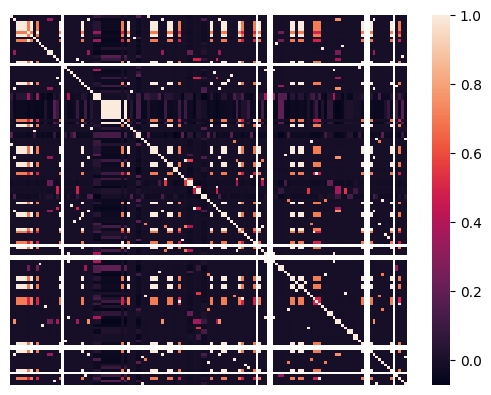

In [ ]:
# visualization
sns.heatmap(c_dupl, xticklabels=False, yticklabels=False)
plt.show()

We can look at the statistics of the gene expression profiles of genes/features that seem duplicates. They might be features with many zeros, or many missing data.

In [ ]:
#general statistics of duplicate rows in dataframe
h_unfiltered_duplicate_rows_t.describe()

,MMP23A,LINC01647,CSF3R,PTGFR,LINC01361,ITGA10,RORC,GPA33,SELE,OR2M4,...,MIR1-1HG-AS1,CHRNA4,OR7G2,LINC00661,PLVAP,LHB,FPR1,LILRB2,TMEM150B,POM121L7P
count,229.000000,229.000000,229.000000,229.000000,229.000000,229.000000,229.000000,229.000000,229.000000,229.000000,...,229.000000,229.000000,229.000000,229.000000,229.000000,229.0,229.000000,229.000000,229.000000,229.000000
mean,0.008734,0.004367,0.008734,0.008734,0.004367,0.004367,0.008734,0.004367,0.004367,0.008734,...,0.004367,0.004367,0.004367,0.004367,0.004367,0.0,0.004367,0.008734,0.004367,0.004367
std,0.093249,0.066082,0.132164,0.132164,0.066082,0.066082,0.093249,0.066082,0.066082,0.093249,...,0.066082,0.066082,0.066082,0.066082,0.066082,0.0,0.066082,0.093249,0.066082,0.066082
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000
75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000
max,1.000000,1.000000,2.000000,2.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,0.0,1.000000,1.000000,1.000000,1.000000


Notice that they are mainly 0, low value data. Below we drop duplicates using pandas built-in method:

In [ ]:
#create dataframe with no duplicates
h_unfiltered_noDup = h_unfiltered.drop_duplicates()
h_unfiltered_noDup

,output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A4_Hypoxia_S8_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A5_Hypoxia_S108_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A6_Hypoxia_S11_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A7_Normoxia_S113_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A8_Normoxia_S119_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A9_Normoxia_S20_Aligned.sortedByCoord.out.bam,...,output.STAR.PCRPlate4G12_Normoxia_S243_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G1_Hypoxia_S193_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G2_Hypoxia_S198_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G6_Hypoxia_S232_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G7_Normoxia_S204_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam
WASH7P,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
CICP27,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
DDX11L17,0,0,0,0,1,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
WASH9P,0,0,0,0,0,0,0,1,0,0,...,0,0,0,0,0,1,0,1,0,0
OR4F29,2,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MT-TE,22,43,0,0,3,47,4,2,8,17,...,24,15,15,4,4,26,1,4,4,20
MT-CYB,4208,6491,4819,310,695,2885,1552,366,1829,3387,...,1119,1429,808,999,916,3719,984,2256,981,2039
MT-TT,26,62,11,4,0,41,9,2,8,9,...,48,31,3,8,5,42,1,15,6,34
MT-TP,66,71,3,9,14,91,22,3,30,37,...,119,52,11,22,15,48,18,36,8,79


Let's count the number of removed rows in non-duplicated dataframe, for safety.

In [ ]:
h_unfiltered.shape[0] - h_unfiltered_noDup.shape[0]

87

In [ ]:
removed_genes = list(set(h_unfiltered.index).difference(set(h_unfiltered_noDup.index)))
removed_genes

['LRRN4CL',
 'TRPV6',
 'RPL22P18',
 'NUS1P2',
 'RPL36P2',
 'PCDHGC4',
 'NTRK3',
 'VNN3',
 'PAX2',
 'LHB',
 'LILRB2',
 'RASL12',
 'DYNLL2-DT',
 'CILP',
 'FBLIM1P2',
 'LDHAL6CP',
 'MIR6864',
 'PCDHGB3',
 'PTGFR',
 'ALPK2',
 'MIR1-1HG-AS1',
 'CD300A',
 'KCNA4',
 'CYCSP26',
 'MIR24-1',
 'CNPY1',
 'SLC5A8',
 'RNY1P12',
 'LINC02833',
 'GPA33',
 'ZBTB45P2',
 'PLVAP',
 'LINC00661',
 'ITPK1-AS1',
 'FPR1',
 'TMEM150B',
 'ITGA10',
 'OR5AU1',
 'LAP3P2',
 'SLC7A3',
 'HRH4',
 'MIR4520-2',
 'ENPP7',
 'SMIM23',
 'RIPOR2',
 'MSX2P1',
 'LINC02395',
 'PCDHGA3',
 'PCDHGA12',
 'DGKK',
 'OR7G2',
 'MIR548AA2',
 'B3GAT1-DT',
 'OR2V2',
 'C4orf50',
 'SPI1',
 'MIR4523',
 'PCDHGB7',
 'VAT1L',
 'SOX5',
 'POM121L7P',
 'STRA6LP',
 'KCNJ16',
 'RPL10AP3',
 'SERPINA1',
 'PCDHA8',
 'CPS1',
 'OR2M4',
 'COL2A1',
 'LINC00563',
 'RN7SKP7',
 'PCDHGA7',
 'PCDHA4',
 'ARHGEF25',
 'RNU6-826P',
 'RN7SL596P',
 'APLNR',
 'MIR548D1',
 'MIR374C',
 'CIR1P3',
 'CHRNA4',
 'DTNA',
 'CCL3L1',
 'OTOGL',
 'CUX2',
 'PCDHGA9',
 'RPL21P66']

In [ ]:
# updating the dataset
h_unfiltered = h_unfiltered_noDup.copy()

In [ ]:
h_unfiltered.shape

(23309, 229)

## Why Do We Need Normalization?

It is important to understand why need to normalize the data before even doing it. From the EDA Distribution section, we saw that the data was highly non-normal, with high skewness and kurtosis. To reduce the overdispersion of the data, we can take a log transformation of the data. 

**NOTE**: we run trials also with the square root and cubic root transformations, but the log is the one that worked the best. To avoid making the file longer than necessary, we avoid putting them and we ask the reader to trust that the log is indeed the one that worked the best. Also, we can see from different pieces of literature that it is the approach that is usually used.

Let's do an example of a single column, by plotting the boxplot with and without the log transformation.

In [ ]:
#computing log-transformation of one single column
h_unfiltered13_log2 = np.log2(h_unfiltered[h_unfiltered.columns[3]]+1)
# we add +1 to be able to take the log of the zero values as well

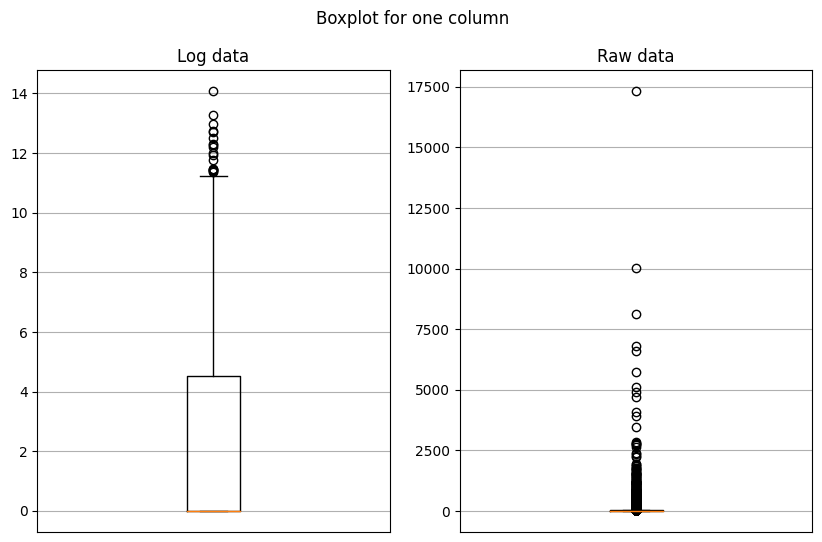

In [ ]:
# computing log transformation of a single column
fig, axs = plt.subplots(1, 2, figsize=(10,6))
plt.suptitle("Boxplot for one column")
axs[0].boxplot(h_unfiltered13_log2)
axs[0].set_title("Log data")
axs[0].get_xaxis().set_visible(False)
axs[0].grid(True)
axs[1].boxplot(h_unfiltered[h_unfiltered.columns[3]]+1)
axs[1].set_title("Raw data")
axs[1].get_xaxis().set_visible(False)
axs[1].grid(True)
plt.show()

We see a very big change with respect to the plots seen in the distribution section! The range seems shorter, but also the distribution is different. Let's investigate more:

In [ ]:
#general information about log-transformed data
display(h_unfiltered13_log2.describe().round(2))

count    23309.00
mean         2.12
std          2.76
min          0.00
25%          0.00
50%          0.00
75%          4.52
max         14.08
Name: output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam, dtype: float64

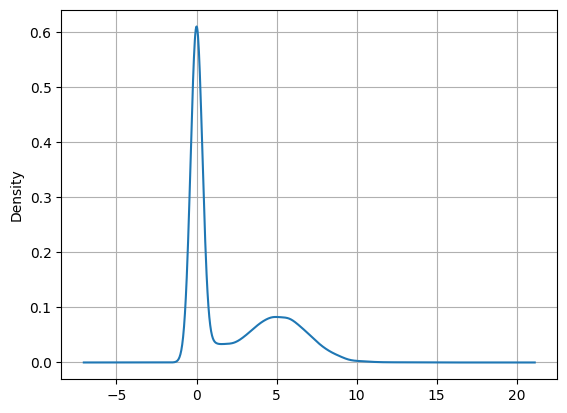

In [ ]:
h_unfiltered13_log2.plot.density(legend = False)
plt.grid(True)
plt.show()

Interestingly, we notice two peaks, at different locations. This is somewhat similar to a bimodal distribution! Notice that the first peak is centered around 0, while the second one is centered at approximately at 5. Intuitively, this might indicate that there are lots of genes that are not expressed much (the peak at 0), and then there is a group of genes that are highly expressed (the peak at 5).


Now let's apply the transformation to the whole data frame and check the corresponding boxplots for 50 random columns.

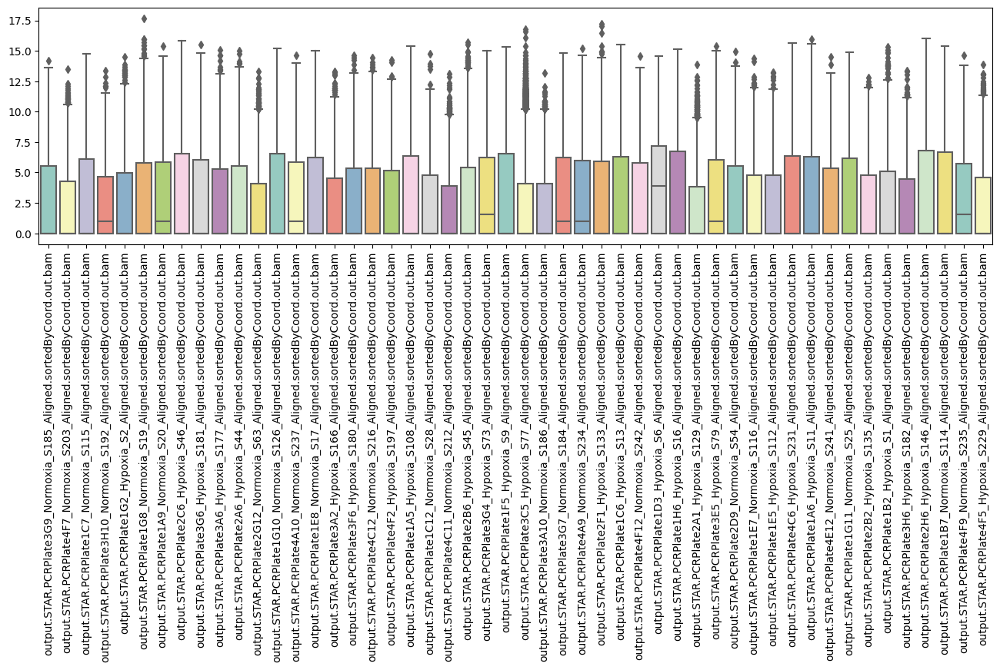

In [ ]:
#box-plot of log-transformed 50 random columns of dataframe
random_columns = list(range(0, h_unfiltered.shape[1])) # list of integers from 1 to 243
random.shuffle(random_columns)
random_columns = random_columns[:50] 

h_unfiltered1 = h_unfiltered + 1
h_unfiltered1_log2 = h_unfiltered1.apply(np.log2)
# selecting part of the data as the plots would otherwise take too long to generate
h_unfiltered1_log2_small = h_unfiltered1_log2.iloc[:, random_columns]
np.shape(h_unfiltered1_log2_small)
plt.figure(figsize=(16,4))
plot=sns.boxplot(data=h_unfiltered1_log2_small,palette="Set3")
plt.setp(plot.get_xticklabels(), rotation=90);

Notice that the range has changed for all of them, compared to the EDA part. Let's try to plot 10 of these densities, for illustration purposes.

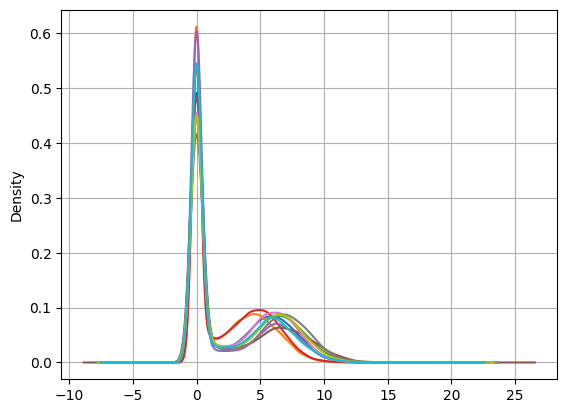

In [ ]:
# 10 densities
fig, ax = plt.subplots(1,1)
for s in h_unfiltered1_log2_small.columns[:10]:
    h_unfiltered1_log2_small[s].plot.density(legend = False)  
plt.grid(True)
plt.show()

There seems to be a clear bimodal trend! Let's check the skewness and kurtosis:

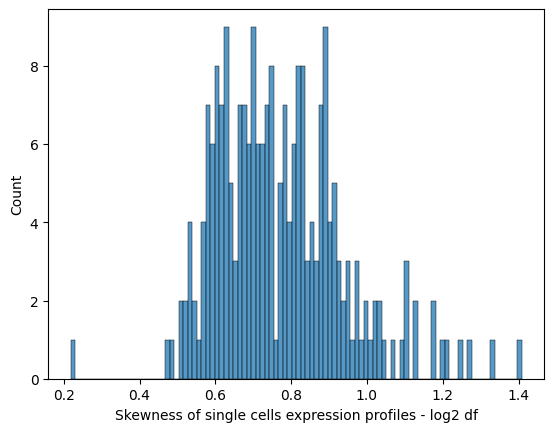

In [ ]:
#skewness of log-trasnformed dataframe
h_unfiltered_colnames = list(h_unfiltered.columns)
h_unfiltered_colN = np.shape(h_unfiltered)[1]

h_unfiltered1_log2_skew_cells = []
for i in range(h_unfiltered_colN) :     
     v_df = h_unfiltered1_log2[h_unfiltered_colnames[i]]
     h_unfiltered1_log2_skew_cells += [skew(v_df)]   
h_unfiltered1_log2_skew_cells
sns.histplot(h_unfiltered1_log2_skew_cells,bins=100)
plt.xlabel('Skewness of single cells expression profiles - log2 df')
plt.show()

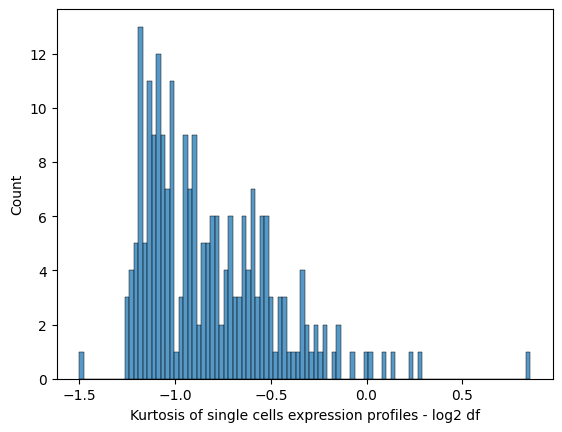

In [ ]:
#kurtosis of log-trasnformed dataframe
h_unfiltered1_log2_kurt_cells = []
for i in range(h_unfiltered_colN) :     
     v_df = h_unfiltered1_log2[h_unfiltered_colnames[i]]
     h_unfiltered1_log2_kurt_cells += [kurtosis(v_df)] 
h_unfiltered1_log2_kurt_cells
sns.histplot(h_unfiltered1_log2_kurt_cells,bins=100)
plt.xlabel('Kurtosis of single cells expression profiles - log2 df')
plt.show()

Both kurtosis and skewness decreased to low values, which makes sense also given that the distributions are bimodal.

What can we say about these results? We see that there are two peaks, so close to half of the genes are usually not expressed (or very low expressed) while roughly the other half is very expressed. So, this indicates the presence of two subgroups of genes for each cell.
In classification, we want to "compare" these distributions, but from the boxplot above, we can see that different samples have different expression levels range, which complicates the task!

For example, consider gene X and two cells A and B. If we see that gene X is more expressed in cell A than B, at this stage, we can't properly compare them because of their different bimodality, and dynamic range, and possibly because cell A might have had more reads than B, so that's why it might get a higher expression.

Thus, normalization becomes crucial for both to adjust technical issues that may have arisen from sampling effects to enable data comparison.

Note that we will normalize the original data, and not the log-transformed one. This is because normalizing the log data can lead to biased results because the normalization is applied to the transformed data, which may not reflect the empirical expression levels.

## Normalization

For single-cell RNA-seq data, there are several methods adopted for data normalization. We list a few of them:
- LogNorm
- CPM (Counts per Million mapped reads)
- RPKM and FPKM (Reads/Fragments Per Kilobase Million)
- TTM (Transcripts Per Kilobase Million)

Going into what each method does, its pros and cons is beyond the scope of our project and we listed them just for illustration purposes.

For our data, we are going to adopt the CPM normalization technique, which is the most commonly used. In addition, CPM normalization is often preferred for comparing gene expression levels across samples, which is our case indeed[$^{[1]}$](https://blog.bioturing.com/2022/01/27/a-guide-to-scrna-seq-normalization/). It is a basic gene expression unit that normalizes only for sequencing depth (depth-normalized counts).
It works as follows: 

$$x_i = \frac{\text{read count of gene } X \text{ in cell } i}{\text{total counts of cell } i}\cdot 10^6$$

where $x_i$ is the gene expression of gene $X$ in cell $i$.

CPM, compared to RPKM, FPKM, and TTM, works well assuming that the gene length has no impact and that the amount of RNA is the same in all cells. 
So this is an assumption that we are making in this modeling stage, which we will carry with us until the end!

Let's now apply the normalization and study the distribution of the new data.

In [ ]:
normalized_h_unfiltered = (h_unfiltered / h_unfiltered.sum(axis = 0)) * 10**6
normalized_h_unfiltered.head()

,output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A4_Hypoxia_S8_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A5_Hypoxia_S108_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A6_Hypoxia_S11_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A7_Normoxia_S113_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A8_Normoxia_S119_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A9_Normoxia_S20_Aligned.sortedByCoord.out.bam,...,output.STAR.PCRPlate4G12_Normoxia_S243_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G1_Hypoxia_S193_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G2_Hypoxia_S198_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G6_Hypoxia_S232_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G7_Normoxia_S204_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam
WASH7P,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0
CICP27,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0
DDX11L17,0.000000,0.0,0.0,0.0,0.907707,0.000000,0.0,0.000000,0.0,0.529511,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0
WASH9P,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,1.114129,0.0,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.408113,0.0,0.395049,0.0,0.0
OR4F29,0.858577,0.0,0.0,0.0,0.000000,0.279729,0.0,0.000000,0.0,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0


In [ ]:
# summary
normalized_h_unfiltered.describe()

,output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A4_Hypoxia_S8_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A5_Hypoxia_S108_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A6_Hypoxia_S11_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A7_Normoxia_S113_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A8_Normoxia_S119_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A9_Normoxia_S20_Aligned.sortedByCoord.out.bam,...,output.STAR.PCRPlate4G12_Normoxia_S243_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G1_Hypoxia_S193_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G2_Hypoxia_S198_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G6_Hypoxia_S232_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G7_Normoxia_S204_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam
count,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000,...,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000
mean,42.901883,42.901883,42.901883,42.901883,42.901883,42.901883,42.901883,42.901883,42.901883,42.901883,...,42.901883,42.901883,42.901883,42.901883,42.901883,42.901883,42.901883,42.901883,42.901883,42.901883
std,227.730909,202.313765,277.671273,246.967010,495.950262,242.395378,274.418846,295.852920,345.021899,237.093270,...,194.392329,217.794880,272.733958,268.658476,200.716917,181.838046,207.965175,233.135854,208.378869,207.139893
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.529511,...,0.559765,0.000000,0.000000,0.000000,0.000000,0.816226,0.000000,0.000000,0.000000,0.560216
75%,22.322990,25.936076,11.632077,26.342100,15.431020,22.937775,24.223221,24.510842,16.904647,30.182141,...,31.906586,27.130921,23.736994,25.851743,28.099900,31.424698,29.157884,27.258387,26.373636,25.209703
max,15229.860262,14217.086605,19918.087482,20745.601169,43063.438739,12051.003542,19760.171236,33691.265896,33292.762182,22403.621010,...,10987.620804,12547.848619,17323.258298,19327.050402,16990.086651,13656.275839,18713.286883,13620.502416,12522.890596,15984.071950


Again, let's see the behaviour on 50 random columns.

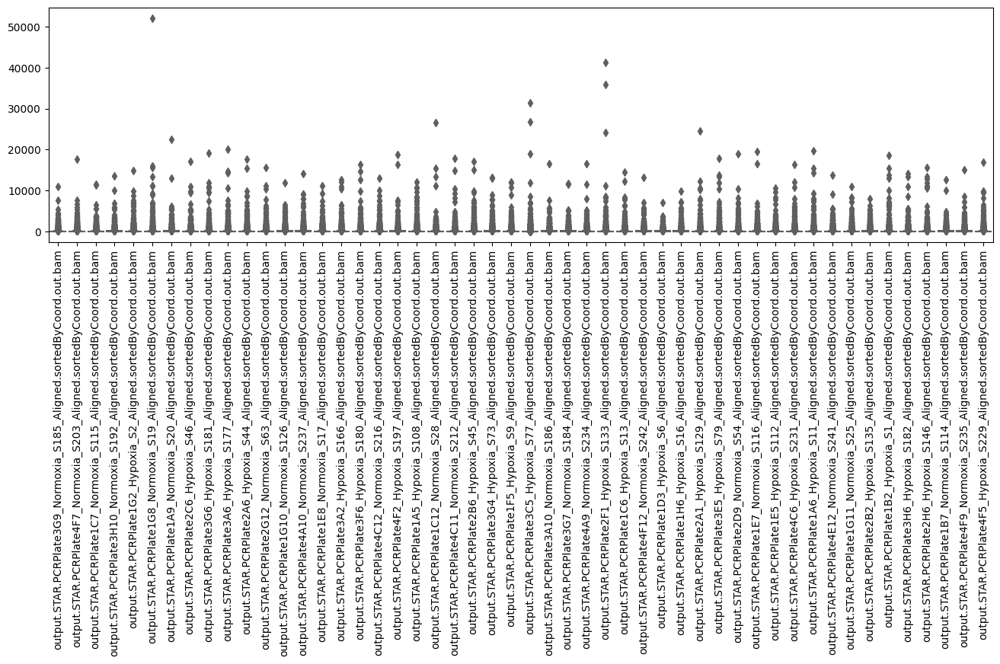

In [ ]:
#box-plot of log-transformed 50 random columns of dataframe
normalized_small = normalized_h_unfiltered.iloc[:, random_columns]
plt.figure(figsize=(16,4))
plot=sns.boxplot(data=normalized_small,palette="Set3")
plt.setp(plot.get_xticklabels(), rotation=90);

Surely the range has changed, and also the distribution of outliers, since they seem more compressed towards lower values, compared to before.
Let's see skewness and kurtosis.

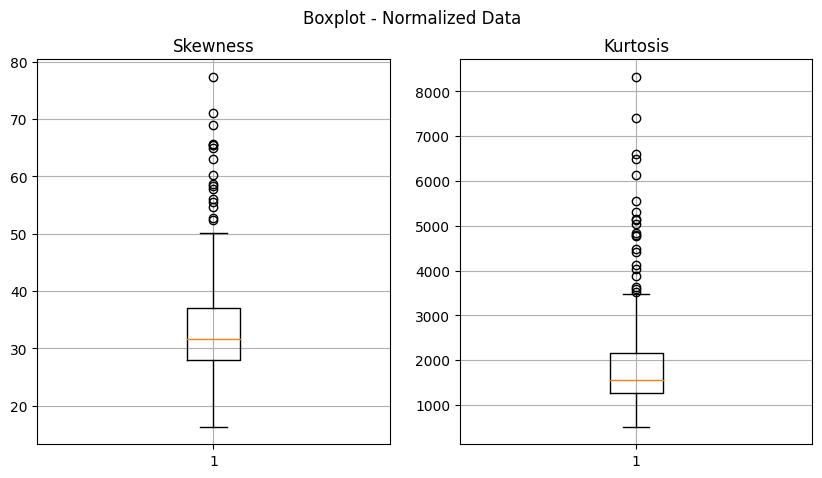

In [ ]:
norm_skewness_list = []
norm_kurtosis_list = []

for col in normalized_h_unfiltered.columns:
  norm_skewness_list.append(skew(normalized_h_unfiltered[col]))
  norm_kurtosis_list.append(kurtosis(normalized_h_unfiltered[col]))

norm_skewness_series = pd.Series(norm_skewness_list)
norm_kurtosis_series = pd.Series(norm_kurtosis_list)

# boxplot of skewness
fig, ax = plt.subplots(1, 2, figsize=(10,5))
plt.suptitle("Boxplot - Normalized Data")
ax[0].boxplot(norm_skewness_series)
ax[0].grid(True)
ax[0].set_title("Skewness")
ax[1].boxplot(norm_kurtosis_series)
ax[1].grid(True)
ax[1].set_title("Kurtosis")
plt.show()


As we can see skewness and kurtosis haven't changed much. This makes sense at this point since we just normalized the values. Moreover, CPM does not transform the data to approximate a normal distribution, so these metrics need not be lower than before.

In [ ]:
# updating
h_unfiltered = normalized_h_unfiltered.copy()

## Scaling

Now we want to scale the data, by applying a log transformation. This method is useful for three main reasons:
- distances between log-transformed expressions represent log-fold changes, which are the canonical measures of changes in expression. This is important in downstream procedures based on Euclidean distances, which include many forms of clustering and dimensionality reduction. By operating on log-transformed data, we ensure that these procedures are measuring distances between cells based on log-fold changes in expression. For instance, which of these tell us more information: a gene that is expressed at an average count of 50 in cell type A and 10 in cell type B, or a gene that is expressed at an average count of 1100 in A and 1000 in B? Log-transformation focuses on the former by promoting contributions from genes with strong relative differences.

- it stabilized the mean-variance relationship in the data
- it makes the data more normal

Notice that we'll actually apply a $log(x+1)$-transformation to avoid taking $log(0)$ in the sparse expressions.

In [ ]:
log_h_unfiltered = np.log2(h_unfiltered + 1)
log_h_unfiltered.describe()

,output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A4_Hypoxia_S8_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A5_Hypoxia_S108_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A6_Hypoxia_S11_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A7_Normoxia_S113_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A8_Normoxia_S119_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A9_Normoxia_S20_Aligned.sortedByCoord.out.bam,...,output.STAR.PCRPlate4G12_Normoxia_S243_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G1_Hypoxia_S193_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G2_Hypoxia_S198_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G6_Hypoxia_S232_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G7_Normoxia_S204_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam
count,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000,...,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000
mean,2.164407,2.241051,1.726915,2.220323,1.788858,1.976023,2.190918,2.094472,1.853881,2.428048,...,2.446603,2.252704,2.109034,2.251986,2.285084,2.500381,2.383497,2.244710,2.250774,2.382596
std,2.822549,2.865574,2.864983,2.874946,2.754952,2.863371,2.825050,2.876558,2.796790,2.858717,...,2.884324,2.872667,2.827354,2.837060,2.892533,2.859929,2.880595,2.864168,2.868606,2.815535
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.613071,...,0.641328,0.000000,0.000000,0.000000,0.000000,0.860944,0.000000,0.000000,0.000000,0.641745
75%,4.543681,4.751468,3.659020,4.773052,4.038350,4.581217,4.656681,4.673039,4.162262,4.962648,...,5.040304,4.814085,4.628598,4.746944,4.862942,5.019021,4.914463,4.820607,4.774715,4.712029
max,13.894710,13.795440,14.281864,14.340587,15.394209,13.556985,14.270381,15.040130,15.022964,14.451509,...,13.423723,13.615267,14.080506,14.238409,14.052491,13.737382,14.191852,13.733598,13.612395,13.964438


Already at first glance, the range has dramatically decreased, as we saw previously by taking the $log$ just on the raw data.

Let's study the distributions of 50 random columns now.

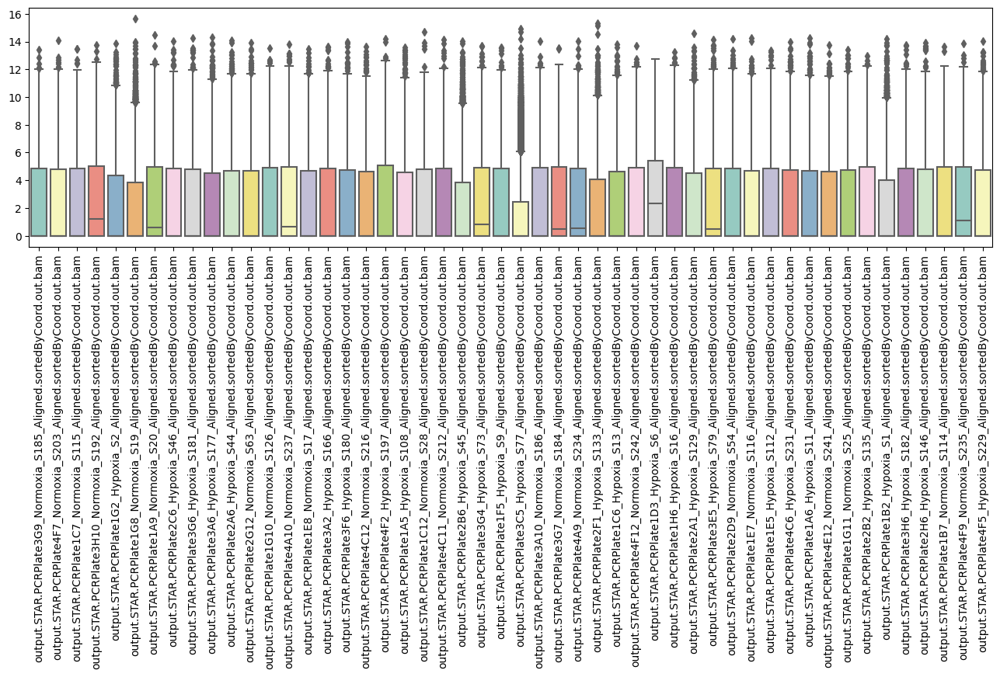

In [ ]:
#box-plot of log-transformed 50 random columns of log-norm df
log_small = log_h_unfiltered.iloc[:, random_columns]
plt.figure(figsize=(16,4))
plot=sns.boxplot(data=log_small,palette="Set3")
plt.setp(plot.get_xticklabels(), rotation=90);

Surely the range has decreased and the distribution is more symmetric. Moreover, we see that most values are within the quantiles and many outliers are far away. This might indicate, once again, the presence of a bimodal distribution. Let's verify it with 10 densities.

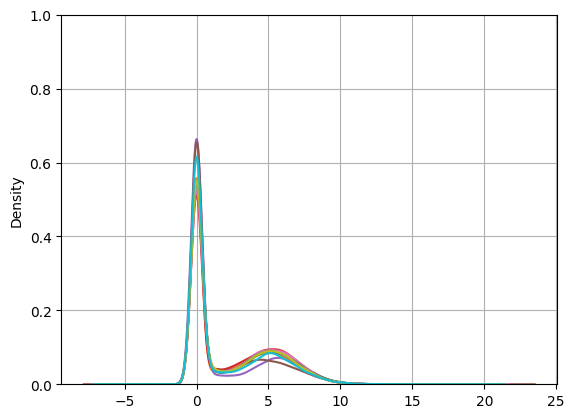

In [ ]:
# 10 densities
fig, ax = plt.subplots(1,1)
for s in log_small.columns[:10]:
    log_small[s].plot.density(legend = False)
plt.ylim(0,1)
plt.grid(True)
plt.show()

It is so! This confirms the presence of 2 main groups of genes with different expression levels in our dataset, as previously stated! 


In [ ]:
# updating
h_unfiltered = log_h_unfiltered.copy()

## A Note on Cell Cycles

What we do here is regress out (in the sense of "removing") unwanted variation. Indeed some biological effects, such as cell cycles, might be very variable and introduce a lot of background noise, that is not representative of the true biological variability. 

Usually one could target batch, dropout, or cell cycle effects. In our case, we decide to focus on cell cycle effects, as removing them could lead to better results in the downstream analysis.

To give a bit of context, the cell cycle consists of five phases: G0, G1, S, G2, and M. G0 is a resting phase, G1 is a growth phase, S is for DNA synthesis, G2 is a preparation phase for mitosis, and M is the actual nuclear division.

To regress out the cell cycle, we need to perform the cell cycle scoring, where we assign each cell a score, based on its expression of G2/M and S phase markers. To score a gene list, the algorithm calculates the difference between the mean expression of the given list and the mean expression of reference genes. To build the reference, the function randomly chooses a bunch of genes matching the distribution of the expression of the given list. Cell cycle scoring adds three slots in data, a score for the S phase, a score for the G2M phase, and the predicted cell cycle phase. 

First, we need to read an external dataset with cell cycle genes, publicly available on [ScanPy's GitHub](https://github.com/scverse/scanpy_usage/blob/master/180209_cell_cycle/data/regev_lab_cell_cycle_genes.txt). To facilitate the coding steps, we'll use ScanPy, which has many built-in methods.

In [ ]:
h_cell_cycle = h_unfiltered.copy()

In [ ]:
adata = sc.AnnData(h_cell_cycle).T
adata

AnnData object with n_obs × n_vars = 229 × 23309

Now we import the data, which you can find in the "data_additional" folder.

In [ ]:
# import cell cycle genes
cell_cycle_genes = [x.strip() for x in open('./regev_lab_cell_cycle_genes.txt')]
len(cell_cycle_genes) # 97

97

In [ ]:
s_genes = cell_cycle_genes[:43] # S phase genes
g2m_genes = cell_cycle_genes[43:] #G2M phase genes
cell_cycle_genes = [x for x in cell_cycle_genes if x in adata.var_names] # take only the ones in our dataset
len(cell_cycle_genes) # 93

93

Now we're ready to perform the cell-cycle scoring, on scaled data.

In [ ]:
sc.pp.scale(adata) # scale data to unit variance and zero mean.
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

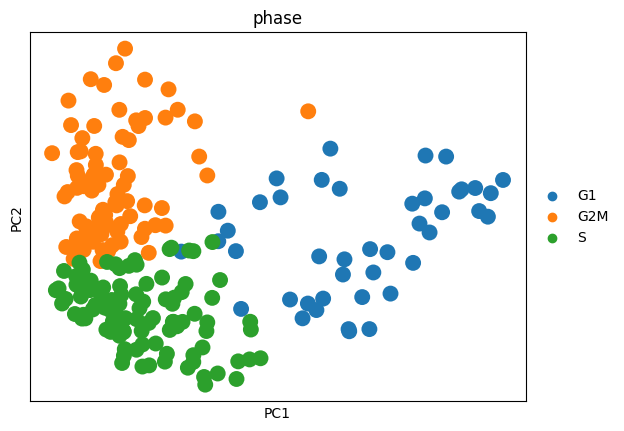

In [ ]:
adata_cc_genes = adata[:, cell_cycle_genes]
sc.tl.pca(adata_cc_genes)
sc.pl.pca_scatter(adata_cc_genes, color='phase')

We have indeed identified a cell cycle. Let's regress out both S score and G2M score.

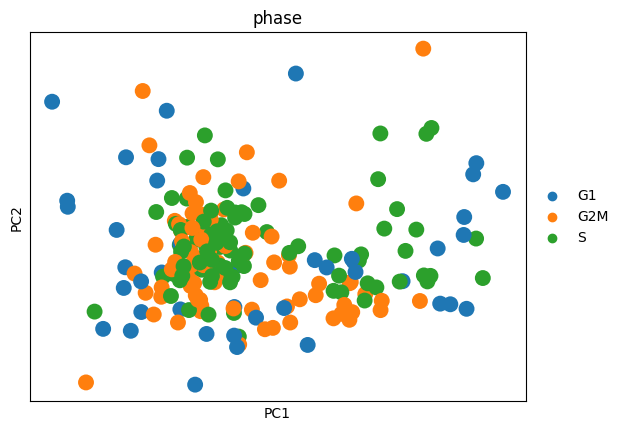

In [ ]:
adata_reg = adata.copy()
sc.pp.regress_out(adata_reg, ['S_score', 'G2M_score'])
sc.pp.scale(adata_reg)
adata_cc_genes = adata_reg[:, cell_cycle_genes]
sc.tl.pca(adata_cc_genes)
sc.pl.pca_scatter(adata_cc_genes, color='phase')

After regressing out the scores, we see clearly see that the effects of the cell cycle have been removed. Let's save it.

In [ ]:
h_unfiltered_reg = adata_reg.to_df().T

Let's see the differences between the original dataframe and the regressed dataframe.

In [ ]:
# dimensions
h_unfiltered.shape, h_unfiltered_reg.shape

((23309, 229), (23309, 229))

As expected the dimensions are the same. Yet, some values should be different, after regressing out the S and G2M scores.

In [ ]:
diff_df = h_cell_cycle - h_unfiltered_reg
diff_df

,output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A4_Hypoxia_S8_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A5_Hypoxia_S108_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A6_Hypoxia_S11_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A7_Normoxia_S113_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A8_Normoxia_S119_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A9_Normoxia_S20_Aligned.sortedByCoord.out.bam,...,output.STAR.PCRPlate4G12_Normoxia_S243_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G1_Hypoxia_S193_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G2_Hypoxia_S198_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G6_Hypoxia_S232_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G7_Normoxia_S204_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam
WASH7P,-0.028870,-0.054350,0.127512,-0.042202,0.149264,0.033444,-0.031384,0.007703,-0.043309,-0.047849,...,-0.029229,-0.026830,0.098434,-0.044094,-0.047711,-0.025282,-0.029251,0.025066,-0.034306,-0.040217
CICP27,-0.068799,0.005171,0.147252,-0.062877,0.155897,-0.022357,0.004611,-0.024090,-0.046896,-0.058901,...,-0.053044,-0.079167,0.054551,-0.029497,-0.065100,-0.011553,0.021081,0.046864,-0.042108,-0.072364
DDX11L17,-0.167620,0.017974,0.370557,-0.152570,0.367309,-0.052419,0.016183,-0.056322,-0.112546,-0.158652,...,-0.128175,-0.193607,0.138999,-0.068980,-0.158041,-0.024381,0.057375,0.120998,-0.100715,-0.176352
WASH9P,-0.065463,-0.073457,0.236564,-0.082023,0.270492,0.039918,-0.041292,-0.013260,-0.077549,-0.088482,...,-0.060022,-0.066503,0.160573,-0.072088,-0.090629,-0.046214,-0.032068,0.047020,-0.063051,-0.082807
OR4F29,-0.038988,0.085669,-0.023340,-0.007707,-0.045649,-0.075729,0.051358,-0.037845,0.011661,0.004990,...,-0.015820,-0.048344,-0.083617,0.032132,-0.002095,0.024460,0.066517,0.015470,0.003771,-0.021153
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MT-TE,0.197788,-0.156781,-0.249664,0.182890,-0.254922,0.156118,-0.074325,0.127131,0.079579,0.113811,...,0.128555,0.250699,0.006292,0.012388,0.145215,-0.023624,-0.134540,-0.110353,0.089250,0.182235
MT-CYB,-0.022153,0.217088,-0.236845,0.065835,-0.294083,-0.168916,0.142017,-0.060482,0.075076,0.070316,...,0.024672,-0.031035,-0.279741,0.112674,0.062924,0.070778,0.149513,-0.011635,0.055223,0.023042
MT-TT,0.273638,-0.138081,-0.468148,0.247998,-0.420578,0.155608,-0.048284,0.167605,0.153800,0.218692,...,0.165764,0.324072,-0.058483,0.053315,0.235647,-0.014800,-0.105252,-0.176769,0.149096,0.252870
MT-TP,0.219883,-0.005102,-0.428108,0.230280,-0.522592,0.062476,0.016353,0.127999,0.148097,0.199707,...,0.140685,0.263431,-0.168386,0.086478,0.216646,0.039466,-0.072615,-0.150603,0.164819,0.218998


In [ ]:
# summary 
diff_df.describe()

,output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A4_Hypoxia_S8_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A5_Hypoxia_S108_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A6_Hypoxia_S11_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A7_Normoxia_S113_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A8_Normoxia_S119_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A9_Normoxia_S20_Aligned.sortedByCoord.out.bam,...,output.STAR.PCRPlate4G12_Normoxia_S243_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G1_Hypoxia_S193_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G2_Hypoxia_S198_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G6_Hypoxia_S232_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G7_Normoxia_S204_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam
count,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000,...,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000,23309.000000
mean,0.025412,0.037169,-0.094763,0.036738,-0.109416,-0.017414,0.023658,-0.002315,0.038589,0.037255,...,0.022544,0.026961,-0.072480,0.035816,0.039529,0.015324,0.018702,-0.021381,0.028599,0.031891
std,0.154715,0.200796,0.357526,0.148098,0.390303,0.169709,0.123404,0.101276,0.137278,0.142841,...,0.114296,0.188083,0.270052,0.127698,0.152658,0.068694,0.151366,0.110885,0.109397,0.155461
min,-0.777166,-1.536491,-3.764920,-0.488361,-3.284919,-1.799541,-0.652593,-1.334373,-0.659463,-0.429895,...,-0.519707,-1.014519,-3.092055,-0.514224,-0.478802,-0.438130,-1.361387,-1.232329,-0.402504,-0.559378
25%,-0.069634,-0.085844,-0.235375,-0.049868,-0.270729,-0.112308,-0.050922,-0.055794,-0.034989,-0.045633,...,-0.047942,-0.089212,-0.193614,-0.035745,-0.049967,-0.025259,-0.072664,-0.065839,-0.032168,-0.064432
50%,0.011764,0.022796,-0.062637,0.019448,-0.075085,-0.011379,0.013711,-0.001797,0.022856,0.022689,...,0.012365,0.012264,-0.047890,0.022789,0.022142,0.011147,0.011376,-0.010106,0.016509,0.017083
75%,0.099442,0.143258,0.112754,0.092591,0.122463,0.082578,0.086526,0.050420,0.081670,0.090868,...,0.074897,0.117061,0.086448,0.085054,0.097504,0.049120,0.102254,0.042077,0.066127,0.103191
max,1.410924,2.129040,1.136200,1.379158,1.281063,2.308329,1.534156,1.483333,2.586176,2.128347,...,1.039595,1.763894,1.066925,1.607023,1.603983,1.485235,1.755991,1.248654,1.860667,1.306703


So, some expression levels increased while some decreased.

This said, we have identified and regressed out a cell cycle. Currently, there are discussions on whether working with data without cell cycles is worth it.
On the one hand, removing it would imply putting away a biological variability that might be intrinsic to the data, but having unwanted variability. On the other, keeping it might bias the learning process, but keep unwanted biological effects.

Given our goals, we decide to leave the dataframe as is, keeping this cell cycle.

## Feature selection

In this part of the analysis, we want to filter our dataframe as much as possible in order to keep only the genes that are relevant for us in the analysis later on. 

In order to do so, first of all, we have to account for genes with very low counts across all samples. In fact, these genes provide little evidence for differential expression and they interfere with some of the statistical approximations that are used later in the pipeline. These genes should be filtered out prior to further analysis.

So we want to remove these "undetectable" genes. How could we define a detectable gene? When there are biological replicates in each group, in this case, we have a sample size of 2 in each group. Therefore we could define a gene as detectable if there is a minimum counts-per-million (CPM) threshold in at least 2 samples. 

This threshold depends on the sequencing depth (we could choose it so the count is around 10 in the initial sample).

In [ ]:
mincpm_threshold = 0.5
mask_h_unfiltered = h_unfiltered > mincpm_threshold
mask_filtering = mask_h_unfiltered.sum(axis = 1) >= 2
h_unfiltered = h_unfiltered.loc[mask_filtering, :]
h_unfiltered

,output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A4_Hypoxia_S8_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A5_Hypoxia_S108_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A6_Hypoxia_S11_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A7_Normoxia_S113_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A8_Normoxia_S119_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A9_Normoxia_S20_Aligned.sortedByCoord.out.bam,...,output.STAR.PCRPlate4G12_Normoxia_S243_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G1_Hypoxia_S193_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G2_Hypoxia_S198_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G6_Hypoxia_S232_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G7_Normoxia_S204_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam
WASH7P,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
CICP27,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
DDX11L17,0.000000,0.000000,0.000000,0.000000,0.931840,0.000000,0.000000,0.000000,0.000000,0.613071,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
WASH9P,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.080064,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.493763,0.000000,0.480316,0.000000,0.000000
OR4F29,0.894198,0.000000,0.000000,0.000000,0.000000,0.355838,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MT-TE,3.384650,3.300300,0.000000,0.000000,1.896513,3.822451,1.175269,1.690756,3.089697,3.322172,...,3.851434,2.822544,3.685772,2.753782,2.789890,3.537412,1.147249,1.367481,2.482001,3.609319
MT-CYB,10.819736,10.384913,10.418058,8.539873,9.303453,9.658244,8.934397,8.675150,10.747102,10.809330,...,9.293188,9.179058,9.322641,10.487611,10.404834,10.568690,10.224572,9.801273,10.136854,10.158963
MT-TT,3.604249,3.782639,2.042925,2.533432,0.000000,3.640261,1.937829,1.690756,3.089697,2.527471,...,4.800574,3.760552,1.754331,3.642663,3.069481,4.181162,1.147249,2.791967,2.978210,4.325338
MT-TP,4.874454,3.964840,0.888404,3.557816,3.776936,4.725487,2.985668,2.118488,4.866632,4.364006,...,6.079207,4.463154,3.278515,5.026648,4.535066,4.363831,4.515284,3.928064,3.346736,5.500070


We could also additionally remove those such that they are not detected in at least $n$ cells. That is:

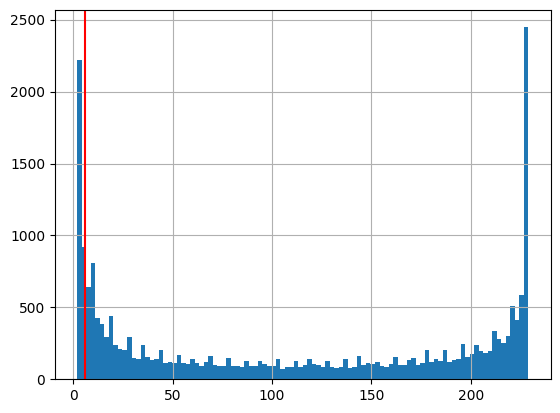

In [ ]:
#number of cells expressing a gene
number_cell_per_gene = h_unfiltered.astype(bool).sum(axis = 1)
number_cell_per_gene_threshold = 6
plt.hist(number_cell_per_gene, bins = 100)
plt.axvline(x = number_cell_per_gene_threshold, color = 'r')
# plt.xlabel()
plt.grid(True)
plt.show()

In [ ]:
#number of genes with less than threshold cell expressing them
number_cell_per_gene[number_cell_per_gene < number_cell_per_gene_threshold].size

2708

In [ ]:
h_unfiltered = h_unfiltered.loc[number_cell_per_gene >= number_cell_per_gene_threshold, :]
h_unfiltered.shape

(19547, 229)

We have removed 2708 additional genes.

Hence, we have achieved a normalized data representation that still retains biological heterogeneity while reducing technical sampling effects in gene expression. However, several remaining genes are uninformative, and their counts mostly register zero. Hence, a standard preprocessing pipeline involves feature selection to exclude uninformative genes that do not represent meaningful biological variation across samples.

Since our experiment and resulting dataset focus on a specific tissue and type of cancer, we anticipate only a small fraction of informative and biologically variable genes. Traditional approaches and pipelines typically calculate the coefficient of variation (for highly variable genes) or the average expression level (for highly expressed genes) to obtain around 3000 genes for downstream analysis. While these methods can be sensitive to the normalization technique used (e.g., CPM), we won't delve deeper into the topic.

We will use the HVG approach to select the most variable genes based on their expression across the population. This approach assumes that genuine biological differences will manifest as increased variation in affected genes compared to other genes influenced by technical noise or a baseline level of "uninteresting" biological variation.

However, we must exercise caution with the HVG approach. We cannot simply choose the most highly variable genes since they are usually the least expressed. Hence, we need to stabilize the variance first. We will proceed as follows: we will use an implementation of the [Seurat v3](https://www.biorxiv.org/content/biorxiv/early/2018/11/02/460147.full.pdf) tool in Python through the scanpy library. This will provide us with pre-implemented tools for analyzing gene variance.

We will apply a variance-stabilizing transformation by first computing the mean and variance for each gene using unnormalized counts. Then, we will take the logarithm of both quantities and fit a curve to predict the variance of each gene as a function of its mean expression.

In [ ]:
#take dataset not transformed
h_unfiltered_HVG = pd.read_csv(path_h_unfiltered, sep = " ")
h_unfiltered_HVG = h_unfiltered_HVG.loc[h_unfiltered.index, h_unfiltered.columns]
adata = sc.AnnData(h_unfiltered_HVG.transpose().copy())

In [ ]:
#compute highly variable genes
adata.raw=adata
result = sc.pp.highly_variable_genes(adata, n_top_genes = 3000, inplace = False, subset = False, flavor='seurat_v3')
sc.pp.highly_variable_genes(adata, n_top_genes = 3000,  flavor='seurat_v3')
adata

AnnData object with n_obs × n_vars = 229 × 19547
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'hvg'

Now let's visualize which genes we have chosen:

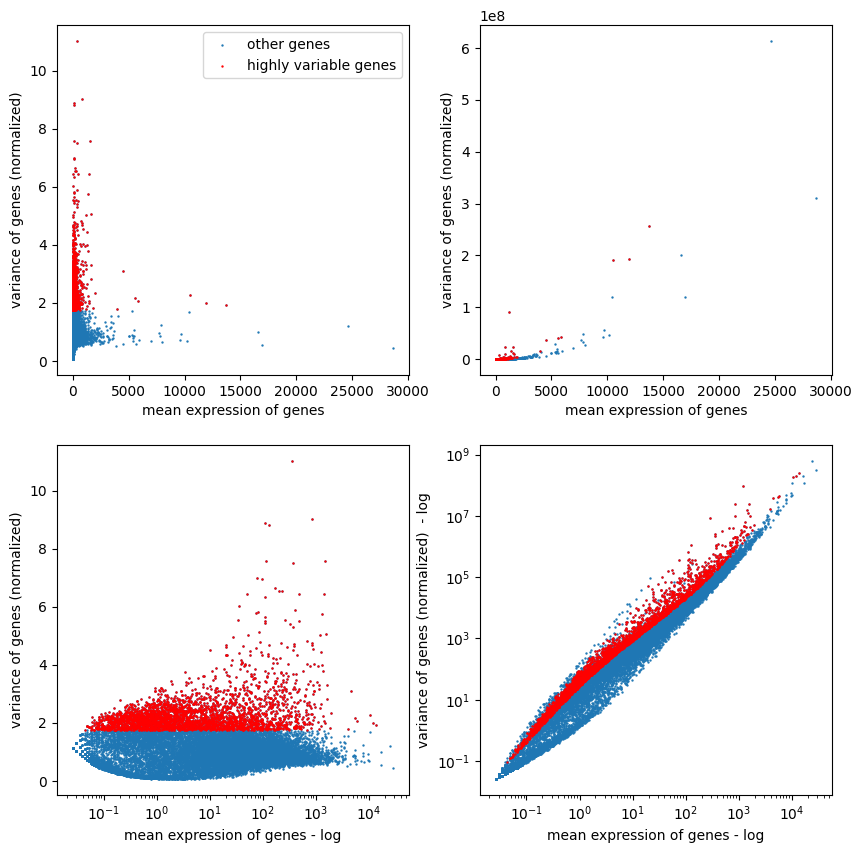

In [ ]:
fig, ax = plt.subplots(2, 2, figsize = (10,10))

ax[0][0].scatter(adata.var['means'], adata.var['variances_norm'], s = 0.5)
ax[0][0].scatter(adata[:, adata.var['highly_variable']].var['means'], adata[:, adata.var['highly_variable']].var['variances_norm'], color = 'r', s = 0.5)
ax[0][0].set_xlabel('mean expression of genes')
ax[0][0].set_ylabel('variance of genes (normalized)')
legend_drawn_flag = True
ax[0][0].legend(["other genes", "highly variable genes"], loc=0, frameon=legend_drawn_flag)

ax[0][1].scatter(adata.var['means'], adata.var['variances'], s = 0.5)
ax[0][1].scatter(adata[:, adata.var['highly_variable']].var['means'], adata[:, adata.var['highly_variable']].var['variances'], color = 'r', s = 0.5)
ax[0][1].set_xlabel('mean expression of genes')
ax[0][1].set_ylabel('variance of genes (normalized)')

ax[1][0].scatter(adata.var['means'], adata.var['variances_norm'], s = 0.5)
ax[1][0].scatter(adata[:, adata.var['highly_variable']].var['means'], adata[:, adata.var['highly_variable']].var['variances_norm'], color = 'r', s = 0.5)
ax[1][0].set_xlabel('mean expression of genes - log')
ax[1][0].set_ylabel('variance of genes (normalized)')
ax[1][0].set_xscale('log')

ax[1][1].scatter(adata.var['means'], adata.var['variances'], s = 0.5)
ax[1][1].scatter(adata[:, adata.var['highly_variable']].var['means'], adata[:, adata.var['highly_variable']].var['variances'], color = 'r', s = 0.5)
ax[1][1].set_xlabel('mean expression of genes - log')
ax[1][1].set_ylabel('variance of genes (normalized)  - log')
ax[1][1].set_xscale('log')
ax[1][1].set_yscale('log')

Just to check, we can see the performance of our method with the given train dataframe:


In [ ]:
#performance with given dataframe
adata = adata[:, adata.var['highly_variable']]
h_filtered_normalised = pd.read_csv(path_h_filtered_norm_train, sep = " ")

print("Total matching: ", adata.var['highly_variable'].index.isin(h_filtered_normalised.index).astype(bool).sum())
print("Percentage matching to the given training dataset: ", round(adata.var['highly_variable'].index.isin(h_filtered_normalised.index).astype(bool).sum()/3000*100, 2), "%")

Total matching:  2136
Percentage matching to the given training dataset:  71.2 %


In [ ]:
# we're switching the naming from unfiltered to filtered
h_filtered_adata = adata.to_df().transpose()
h_filtered = h_unfiltered.loc[h_filtered_adata.index, :]
h_filtered

,output.STAR.PCRPlate1A10_Normoxia_S123_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A4_Hypoxia_S8_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A5_Hypoxia_S108_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A6_Hypoxia_S11_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A7_Normoxia_S113_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A8_Normoxia_S119_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate1A9_Normoxia_S20_Aligned.sortedByCoord.out.bam,...,output.STAR.PCRPlate4G12_Normoxia_S243_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G1_Hypoxia_S193_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G2_Hypoxia_S198_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G6_Hypoxia_S232_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4G7_Normoxia_S204_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H10_Normoxia_S210_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H11_Normoxia_S214_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.sortedByCoord.out.bam,output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.sortedByCoord.out.bam
ISG15,6.793087,7.536365,8.031929,7.246678,7.815086,6.241986,7.390008,8.216059,6.840926,7.483137,...,6.370263,7.140666,7.164122,6.706074,5.979924,8.867480,5.632166,7.291395,6.076974,7.276676
RNF223,0.000000,0.000000,0.000000,0.000000,0.000000,0.355838,0.000000,0.000000,4.498275,2.062490,...,0.000000,0.000000,0.000000,2.408338,0.000000,1.153377,0.000000,0.000000,0.000000,0.000000
C1QTNF12,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
ANKRD65,0.000000,5.177876,5.986775,0.000000,0.000000,5.063872,0.000000,0.000000,0.000000,3.072647,...,3.672998,0.000000,0.000000,0.000000,0.000000,4.045119,0.000000,4.136853,3.500817,0.000000
LINC01770,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TSPEAR-AS2,1.442096,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.730071,3.884333,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.778134,0.000000,5.049066,0.641745
ITGB2,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.480316,4.890787,0.000000
COL6A1,0.000000,4.193040,0.360318,0.000000,5.185889,0.000000,0.000000,0.000000,1.525214,4.505253,...,3.469334,3.803026,4.802293,4.822116,6.414469,4.473909,6.254075,5.422072,2.978210,2.595012
COL6A2,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.118488,5.370978,5.588760,...,5.112111,0.000000,0.000000,3.466426,0.000000,3.933946,5.179210,6.521385,6.239058,0.000000


So this is our new filtered dataframe that we'll use from now use. As we can see it has 229 cells and 3000 genes.


## Dimensionality Reduction

We have kept to the main 3000 genes in the sections, but the space of the expression profiles is described in way fewer dimensions than the number of genes. Therefore, we want to capture this lower-dimensionality to understand the underlying structure of our data. 
In this section, our goal is that of summarizing and visualizing data, without getting too worried about the analysis, as it will come more deeply in the downstream analysis section later.

We'll apply several techniques.

In [ ]:
# auxiliary variables and functions that we'll need
h_filtered = h_filtered.transpose() # columns are features (genes)

counts_per_cell = h_filtered.sum(axis = 1) # number of counts per cell
number_of_genes = np.count_nonzero(h_filtered, axis=1) #number of detected genes count
cell_types = pd.Series(index=h_filtered.index) # type of each cell
for i, col in enumerate(h_filtered.index):
    if "Normoxia" in h_filtered.index[i]:
        cell_types[col] = 'Normoxia'
    else:
        cell_types[col] = 'Hypoxia'

# type1
colors1 = counts_per_cell
# type2
cmap = {'Hypoxia': 'red', 'Normoxia': 'blue'}
colors2 = [cmap[cell_type] for cell_type in cell_types]

def plot_dim_red(dim_type, df, ax1, ax2, ax3):
  fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(17.5, 11))

  plt.suptitle(f"{dim_type} Visualization")

  # counts per cell - 2D
  sctr2d = axs[0, 0].scatter(df[:, 0], df[:, 1], c=colors1)
  axs[0, 0].set_xlabel(ax1)
  axs[0, 0].set_ylabel(ax2)
  axs[0, 0].grid(True)
  if dim_type == "PCA":
    axs[0, 0].set_title(f"Explained Variance:{round(pca.explained_variance_ratio_[0] + pca.explained_variance_ratio_[1], 2)}")

  # counts per cell - 3D
  axs[0, 1].remove()
  axs[0, 1] = fig.add_subplot(222, projection='3d')
  sctr3d = axs[0, 1].scatter(df[:, 0], df[:, 1], df[:, 2], c=colors1)
  axs[0, 1].set_xlabel(ax1)
  axs[0, 1].set_ylabel(ax2)
  axs[0, 1].set_zlabel(ax3)
  if dim_type == "PCA":
    axs[0, 1].set_title(f"Explained Variance:{round(pca.explained_variance_ratio_[0] + pca.explained_variance_ratio_[1] + pca.explained_variance_ratio_[2], 2)}")
  fig.colorbar(sctr3d, ax=axs[0, 1], label="Counts per cell")

  # hypoxia normoxia - 2D
  sctr2d = axs[1, 0].scatter(df[:, 0], df[:, 1], c=colors2)
  axs[1, 0].set_xlabel(ax1)
  axs[1, 0].set_ylabel(ax2)
  axs[1, 0].grid(True)
  handles = [plt.plot([],[], marker="o", ms=10, ls="", mec=None, color=val, label=key)[0] for key, val in cmap.items()]
  axs[1, 0].legend(handles=handles, numpoints=1, loc='lower right')

  # hypoxia normoxia - 3D
  axs[1, 1].remove()
  axs[1, 1] = fig.add_subplot(224, projection='3d')
  sctr3d = axs[1, 1].scatter(df[:, 0], df[:, 1], df[:, 2], c=colors2)
  axs[1, 1].set_xlabel(ax1)
  axs[1, 1].set_ylabel(ax2)
  axs[1, 1].set_zlabel(ax3)

  plt.tight_layout()


<ipython-input-129-c5cb6f89bf4b>:6: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  cell_types = pd.Series(index=h_filtered.index) # type of each cell


### PCA

In [ ]:
h_filtered_scaled = StandardScaler().fit_transform(h_filtered) # unit variance, zero mean

pca = PCA()
h_filtered_pca = pca.fit_transform(h_filtered_scaled)

In [ ]:
print(f"Explained Variance Ratio PC1: {round(pca.explained_variance_ratio_[0], 4)}\
      \nExplained Variane Ratio PC2: {round(pca.explained_variance_ratio_[1], 4)}\
      \nExplained Variance Ratio PC3: {round(pca.explained_variance_ratio_[2], 4)}")

Explained Variance Ratio PC1: 0.0375      
Explained Variane Ratio PC2: 0.0293      
Explained Variance Ratio PC3: 0.0245


The first three principal components (i.e. the only ones useful for visualization) capture respectively 3.8%, 2.9%, and 2.5% of the variance. Let's see at least a plot of how many dimensions would be needed to capture, for instance, 95% of the variance.

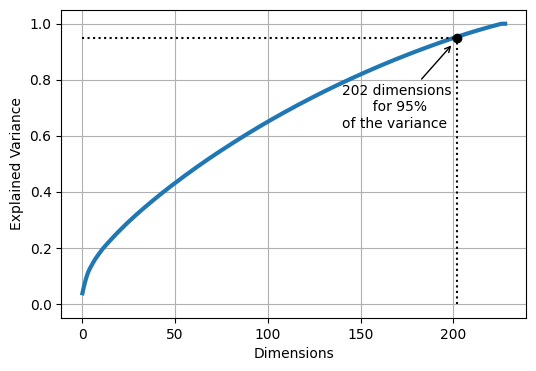

In [ ]:
cumsum = np.cumsum(pca.explained_variance_ratio_)
d = np.argmax(cumsum >= 0.95) + 1
plt.figure(figsize=(6, 4))
plt.plot(cumsum, linewidth=3)
# plt.axis([0, 400, 0, 1])
plt.xlabel("Dimensions")
plt.ylabel("Explained Variance")
plt.plot([d, d], [0, 0.95], "k:")
plt.plot([0, d], [0.95, 0.95], "k:")
plt.plot(d, 0.95, "ko")
plt.annotate(f"{d} dimensions\n       for 95%\nof the variance", xy=(200, 0.93), xytext=(140, 0.63),
             arrowprops=dict(arrowstyle="->"))
plt.grid(True)
plt.show()

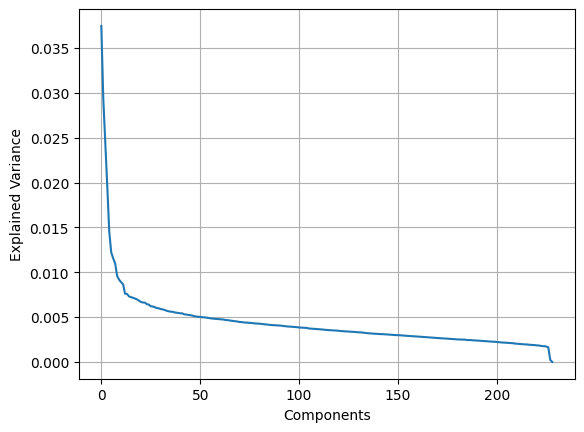

In [ ]:
plt.plot(pca.explained_variance_ratio_)
plt.ylabel('Explained Variance')
plt.xlabel('Components')
plt.grid(True)
plt.show()

The first plot shows that we need 202 dimensions to capture most of the variance. This is both good and bad news.

- Bad because we probably won't be able to do plots in which from PC1, PC2, and PC3 nice structure emerges.
- Good because 202 is much lower than 3000, so there is indeed a lower dimensional space that well describes the genes.

Moreover, from the last plot, we see the elbow at roughly 20 components, but we have no reason to apply it as we're not seeking a lower dimensional representation of the data which is not visualizable.

Let's do the 2D and 3D plots.

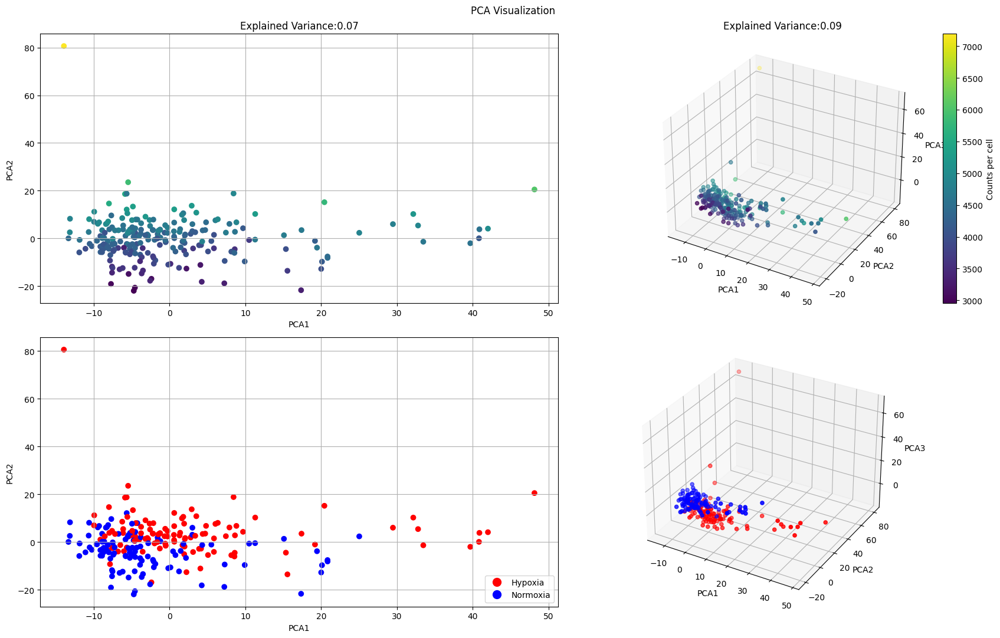

In [ ]:
plot_dim_red("PCA", h_filtered_pca, "PCA1", "PCA2", "PCA3")
plt.show()

There seems to be some structure. Indeed cells with low counts are closer together, while cells with high counts are further away and more spread out. In addition, we can see a clear distinction between hypoxic and normoxic cells. Indeed all normoxic cells seem to be centered in a region of low counts per cell and separated from the hypoxic ones, which are more dispersed and with higher counts.

An interesting cell is the one in the upper left corner, which is hypoxic and has a particularly high number of counts.

### t-SNE

t-SNE stands for t-distributed stochastic neighbor embedding and it is a nonlinear dimensionality technique. It is made of two main stages:
1. It constructs a probability distribution over pairs of high-dimensional objects where similar objects have a higher probability than dissimilar ones.
2. It minimizes the KL divergence between the high-dimensional probability distribution and the low-dimensional probability distribution, using the Euclidean distance as a similarity metric.

In [ ]:
tsne = TSNE(n_components = 3, perplexity=60, random_state = 42)
h_filtered_tsne = tsne.fit_transform(h_filtered_scaled)

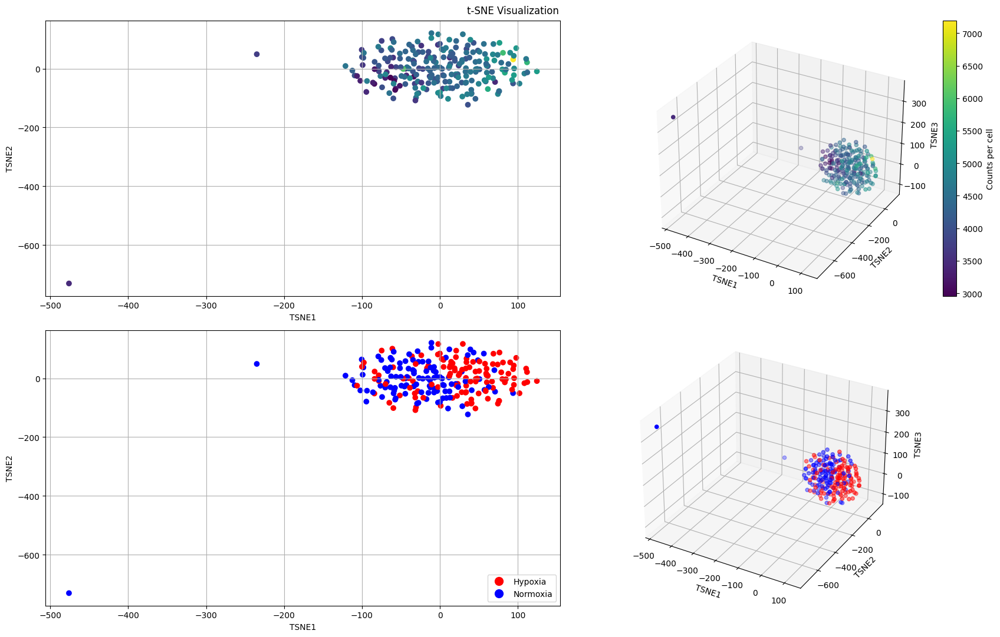

In [ ]:
plot_dim_red("t-SNE", h_filtered_tsne, "TSNE1", "TSNE2", "TSNE3")
plt.show()

t-SNE needs to be interpreted carefully, because [the plots can be a bit misleading](https://distill.pub/2016/misread-tsne/). Indeed, cluster sizes and distances have no meaning. For the perplexity hyperparameter, we choose 60 as it gave the most clear visualization of clusters. 

In a similar manner to PCA, there seems to be some slight separation between hypoxic and normoxic cells. Moreover, the outlier cell of PCA is not in the middle (yellow one in the first graph), but another outlier normoxic cell appears in the lower left corner.

### UMAP

UMAP is based on the idea of constructing a weighted graph representation of the data, where each data point is represented as a node in the graph and edges are placed between nearby points. The weight of each edge is determined by a fuzzy measure of the degree of similarity between the two points it connects. UMAP uses an optimization algorithm to find a low-dimensional representation that minimizes the difference between the fuzzy topological representation of the high-dimensional data and the low-dimensional representation.

In [ ]:
# calculate UMAP projection
reducer = umap.UMAP(n_components=3, random_state=42)
h_umap = reducer.fit_transform(h_filtered_scaled)

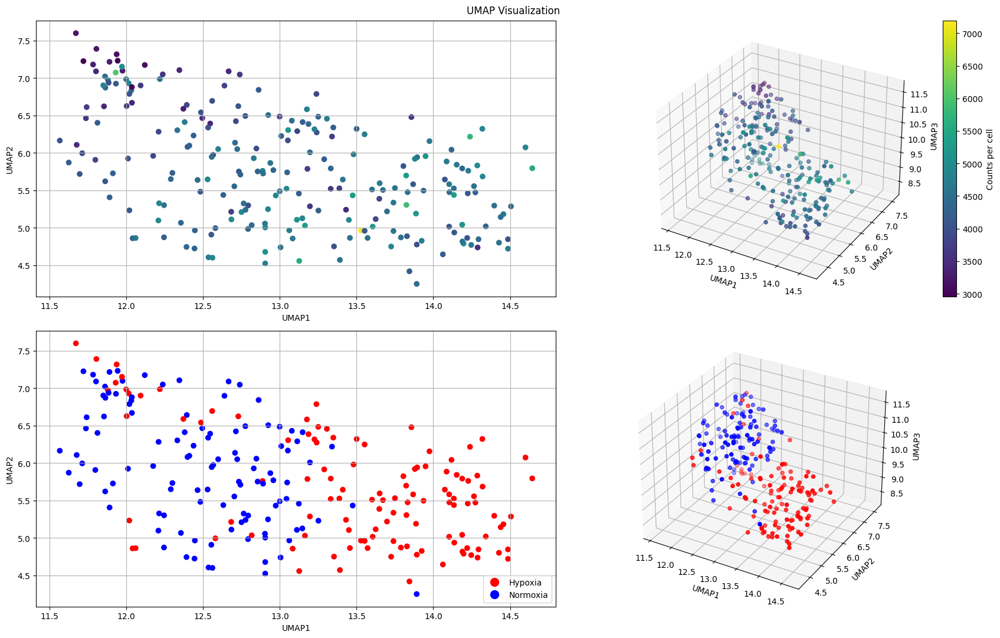

In [ ]:
plot_dim_red("UMAP", h_umap, "UMAP1", "UMAP2", "UMAP3")
plt.show()

Using UMAP, some slight separation seems to be present between normoxic and hypoxic cells, both in 2D and 3D.

# **Downstream Analysis**

Now, we're seeking to gain an even deeper understanding of the structure of the data. We'll proceed both as follows:
- Correlation
- Unsupervised Clustering
  - Hierarchical
  - K-Means
  - Leiden Algorithm
- Gene Annotation

Note that we're still trying to understand, as best as possible, what data we have, so that we can possibly give as much information as possible to whoever will need to interpret our results in a biological perspective. 

## Correlation

Just like we did in the EDA section, let's check again the correlation of this filtered data, to see if we can notice something different.

In [ ]:
h_filtered = h_filtered.transpose()

We now want to check the correlation between samples and features. As before, we first proceed at looking at the correlation between samples. We are going to visualize both Pearson's and Spearman's rank correlation, but we are going to analyze only the former, not the latter. 


Average between minimum and maximum correlation:  0.6704098944467649
Average correlation of expression profiles between cells:  0.6615169660233099
Min. correlation of expression profiles between cells:  0.3408197888935299


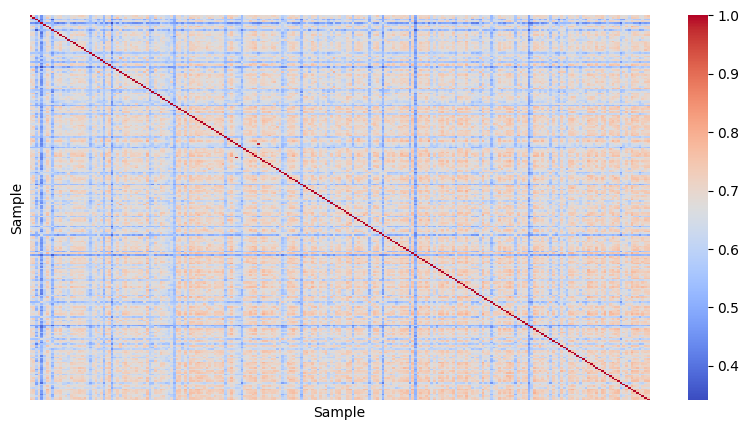

In [ ]:
#pearson correlation coefficient
corr_matrix_p = h_filtered.corr(method = 'pearson')

average = (corr_matrix_p.values.max() - corr_matrix_p.values.min()) /2 + corr_matrix_p.values.min()
print("Average between minimum and maximum correlation: ", average)
print("Average correlation of expression profiles between cells: ", corr_matrix_p.mean().mean())
print("Min. correlation of expression profiles between cells: ", corr_matrix_p.values.min())

plt.figure(figsize=(10,5))
sns.heatmap(corr_matrix_p, cmap='coolwarm', yticklabels = False, xticklabels = False)
plt.xlabel('Sample')
plt.ylabel('Sample')
plt.show()

Average between minimum and maximum correlation:  0.6584605433317094
Average correlation of expression profiles between cells:  0.5892810912270801
Min. correlation of expression profiles between cells:  0.31692108666341895


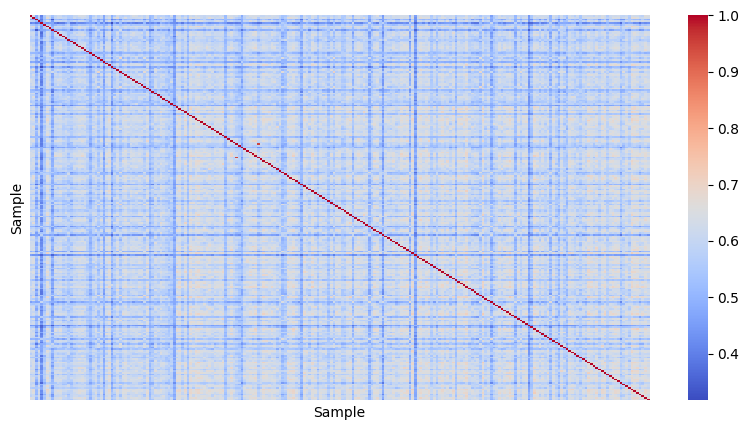

In [ ]:
#spearman correlation coefficient
corr_matrix_s = h_filtered.corr(method = 'spearman')

average = (corr_matrix_s.values.max() - corr_matrix_s.values.min()) /2 + corr_matrix_s.values.min()
print("Average between minimum and maximum correlation: ", average)
print("Average correlation of expression profiles between cells: ", corr_matrix_s.mean().mean())
print("Min. correlation of expression profiles between cells: ", corr_matrix_s.values.min())

plt.figure(figsize=(10,5))
sns.heatmap(corr_matrix_s, cmap='coolwarm', yticklabels = False, xticklabels = False)
plt.xlabel('Sample')
plt.ylabel('Sample')
plt.show()

Notice that there is a positive correlation between most cells. As before, let's plot the distribution of the correlation between gene expression profiles using a histogram (we do it on the first three variables in order not to lose too much time). 

[]

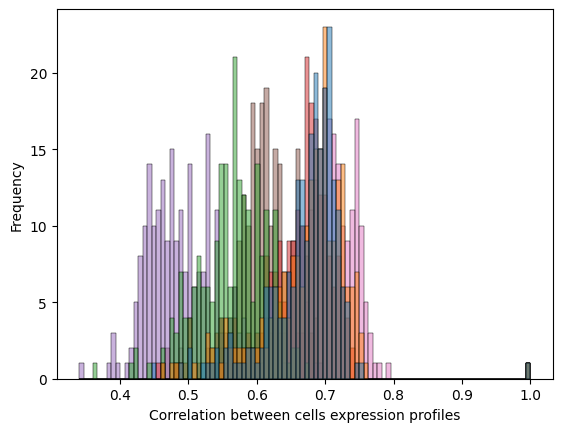

In [ ]:
c = corr_matrix_p

c_small=corr_matrix_p.iloc[:,:7]
sns.histplot(c_small,bins=100)
plt.legend().set_visible(False);
plt.ylabel('Frequency')
plt.xlabel('Correlation between cells expression profiles')
plt.plot()

Notice that cells are correlated with others. 

Now, we want to focus on the distribution of cells that have a low correlation with all the others, in order to understand why this happens, and what are its properties. Let's look at their distribution.

So, let's find the low and the highly correlated cells by analyzing the average correlation of a cell.

In [ ]:
#find low and high correlated cells
correlation_threshold = 0.6

low_corr_cells = (corr_matrix_p.sum(axis = 0) / corr_matrix_p.shape[1] ) <= correlation_threshold
high_corr_cells = ((corr_matrix_p.sum(axis = 0) / corr_matrix_p.shape[1] ) > correlation_threshold) & ((corr_matrix_p.sum(axis = 0) / corr_matrix_p.shape[1] ) <= 0.7)
very_high_corr_cells = (corr_matrix_p.sum(axis = 0) / corr_matrix_p.shape[1] ) > 0.7

Now, let's analyse the distribution of the low correlated cells.

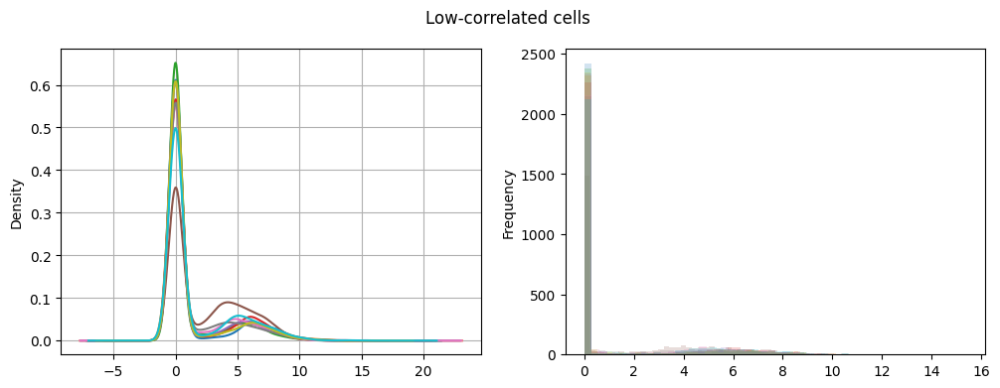

In [ ]:
low_corr = h_filtered.loc[:, low_corr_cells]

# 10 densities
fig, ax = plt.subplots(1,2, figsize=(12,4))
plt.suptitle("Low-correlated cells")
for s in low_corr.columns[:10]:
    low_corr[s].plot.density(legend = False, ax = ax[0])  
ax[0].grid(True)
ax[0].set_ylabel("Density")
 
for s in low_corr.columns[:10]:
    ax[1].hist(low_corr[s], bins = 50, alpha = 0.2)
ax[1].set_ylabel("Frequency")
ax[1].legend().set_visible(False)
plt.show()

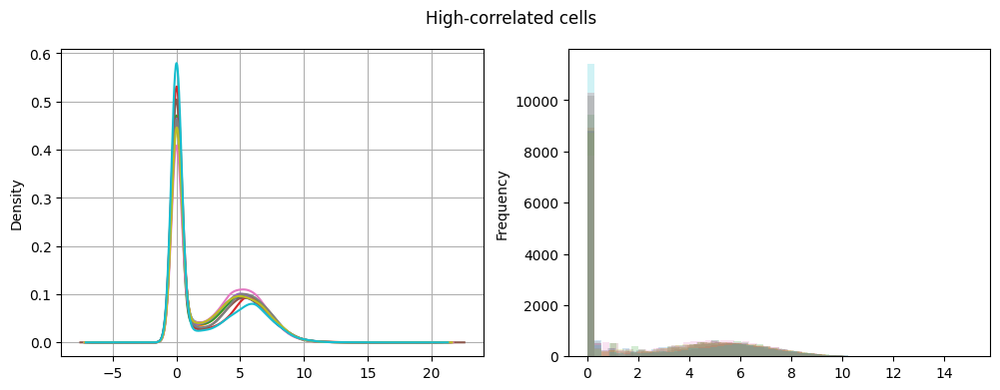

In [ ]:
high_corr = h_unfiltered.loc[:, high_corr_cells]

# 10 densities
fig, ax = plt.subplots(1,2, figsize=(12,4))
plt.suptitle("High-correlated cells")
for s in high_corr.columns[:10]:
    high_corr[s].plot.density(legend = False, ax = ax[0])  
ax[0].grid(True)
ax[0].set_ylabel("Density")
 
for s in high_corr.columns[:10]:
    ax[1].hist(high_corr[s], bins = 50, alpha = 0.2)
ax[1].set_ylabel("Frequency")
plt.show()

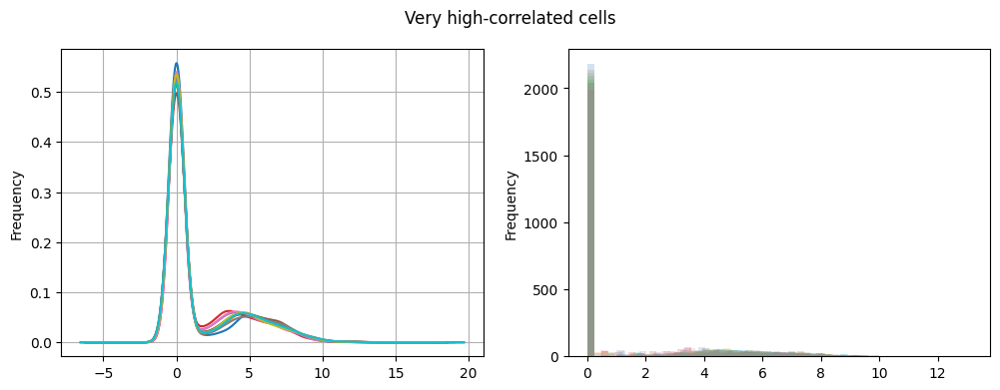

In [ ]:
very_high_corr = h_filtered.loc[:, very_high_corr_cells]

# 10 densities
fig, ax = plt.subplots(1,2, figsize=(12,4))
plt.suptitle("Very high-correlated cells")
for s in very_high_corr.columns[:10]:
    very_high_corr[s].plot.density(legend = False, ax = ax[0])  
ax[0].grid(True)
ax[0].set_ylabel("Frequency")
 
for s in very_high_corr.columns[:10]:
    ax[1].hist(very_high_corr[s], bins = 50, alpha = 0.2)
ax[1].set_ylabel("Frequency")
plt.show()

From the distributions, we see that the distriubtions are fairly similar among low/high correlated samples. Let's check this: 

In [ ]:
#max
print("Max expression low correlated cells: ", low_corr.max(axis = 0).max())
print("Max expression high correlated cells: ", high_corr.max(axis = 0).max())
print("Max expression very high correlated cells: ", very_high_corr.max(axis = 0).max())

Max expression low correlated cells:  15.394209408231243
Max expression high correlated cells:  15.151184541570867
Max expression very high correlated cells:  13.145105033386143


In [ ]:
#average
print("Average expression low correlated cells: ", low_corr.mean().mean())
print("Average expression high correlated cells: ", high_corr.mean().mean())
print("Average expression very high correlated cells: ", very_high_corr.mean().mean())

Average expression low correlated cells:  1.452980084194392
Average expression high correlated cells:  2.6727020341461354
Average expression very high correlated cells:  1.5752502212760162


In [ ]:
#sparsity of low_corr, high_corr and very_high_corr
sparsity_index_low = 1 - (np.count_nonzero(low_corr.values) / low_corr.size)
sparsity_index_high = 1 - (np.count_nonzero(high_corr.values) / high_corr.size)
sparsity_index_very_high = 1 - (np.count_nonzero(very_high_corr.values) / very_high_corr.size)
print("Low correlation: ", sparsity_index_low)
print("High correlation: ", sparsity_index_high)
print("Very high correlation: ", sparsity_index_very_high)

Low correlation:  0.7225873015873017
High correlation:  0.4512976993417025
Very high correlation:  0.6834545454545455


The data displayed above confirm what was previously stated, indeed.

Now, we are interested in how hypoxic and normoxic cells relate to each other. So, we want to analyze, using the Pearson correlation coefficient, the correlation between hypoxic and normoxic cells between them.

Hypoxic:
Number of cells included:  (117, 117)
Average between minimum and maximum correlation:  0.6704098944467649
Average correlation of expression profiles between cells:  0.667425601345052
Min. correlation of expression profiles between cells:  0.3408197888935299
Normoxic:
Number of cells included:  (112, 112)
Average between minimum and maximum correlation:  0.7126696649773665
Average correlation of expression profiles between cells:  0.6834860097879832
Min. correlation of expression profiles between cells:  0.4253393299547331
Mixed:
Number of cells included:  (112, 117)
Average between minimum and maximum correlation:  0.5754045354751341
Average correlation of expression profiles between cells:  0.6479156613108791
Min. correlation of expression profiles between cells:  0.3616287998484856


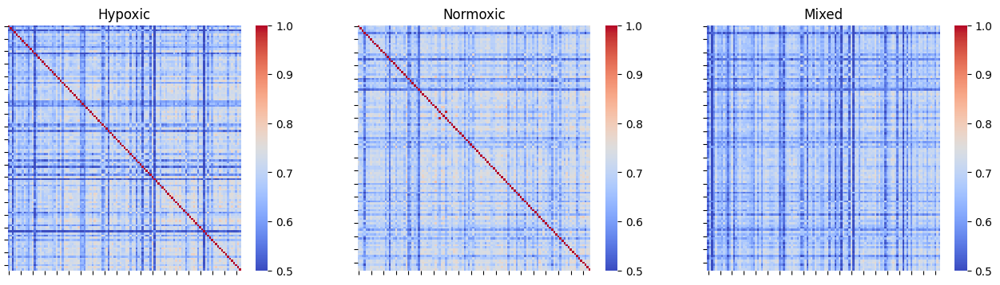

In [ ]:
normoxic_cells = h_unfiltered.columns[h_filtered.columns.str.contains('Normoxia')].tolist()
hypoxic_cells = h_unfiltered.columns[h_filtered.columns.str.contains('Hypoxia')].tolist()

#correlation matrix between hypoxic cells
corr_matrix_hypoxic = corr_matrix_p.loc[hypoxic_cells, hypoxic_cells]
corr_matrix_hypoxic
print("Hypoxic:")
average = (corr_matrix_hypoxic.values.max() - corr_matrix_hypoxic.values.min()) /2 + corr_matrix_hypoxic.values.min()
print("Number of cells included: ", np.shape(corr_matrix_hypoxic))
print("Average between minimum and maximum correlation: ", average)
print("Average correlation of expression profiles between cells: ", corr_matrix_hypoxic.mean().mean())
print("Min. correlation of expression profiles between cells: ", corr_matrix_hypoxic.values.min())


#correlation matrix between normoxic cells
corr_matrix_normoxic = corr_matrix_p.loc[normoxic_cells, normoxic_cells]
corr_matrix_normoxic
print("Normoxic:")
average = (corr_matrix_normoxic.values.max() - corr_matrix_normoxic.values.min()) /2 + corr_matrix_normoxic.values.min()
print("Number of cells included: ", np.shape(corr_matrix_normoxic))
print("Average between minimum and maximum correlation: ", average)
print("Average correlation of expression profiles between cells: ", corr_matrix_normoxic.mean().mean())
print("Min. correlation of expression profiles between cells: ", corr_matrix_normoxic.values.min())

#correlation matrix between mixed cells
corr_matrix_mixed = corr_matrix_p.loc[normoxic_cells, hypoxic_cells]
corr_matrix_mixed
print("Mixed:")
average = (corr_matrix_mixed.values.max() - corr_matrix_mixed.values.min()) /2 + corr_matrix_mixed.values.min()
print("Number of cells included: ", np.shape(corr_matrix_mixed))
print("Average between minimum and maximum correlation: ", average)
print("Average correlation of expression profiles between cells: ", corr_matrix_mixed.mean().mean())
print("Min. correlation of expression profiles between cells: ", corr_matrix_mixed.values.min())

#Statistics:
fig, ax =plt.subplots(1,3, figsize = (16,4))

sns.heatmap(corr_matrix_hypoxic, cmap='coolwarm', ax=ax[0], vmin=0.5, vmax=1)
ax[0].set(title='Hypoxic', xticklabels=[], yticklabels=[])

sns.heatmap(corr_matrix_normoxic, cmap='coolwarm', ax=ax[1], vmin=0.5, vmax=1)
ax[1].set(title='Normoxic', xticklabels=[], yticklabels=[])

sns.heatmap(corr_matrix_mixed, cmap='coolwarm', ax=ax[2], vmin=0.5, vmax=1)
ax[2].set(title='Mixed', xticklabels=[], yticklabels=[])

plt.show()


There doesn't seem to be much difference among the different cells.

Now we are interested in the analysis of the correlation of genes. Let's first use again Pearson and Spearman correlation coefficients.

Number of cells included:  (3000, 3000)
Average between minimum and maximum correlation:  0.1695603008341363
Average correlation of expression profiles between cells:  0.014895438393351544
Min. correlation of expression profiles between cells:  -0.6608793983317274


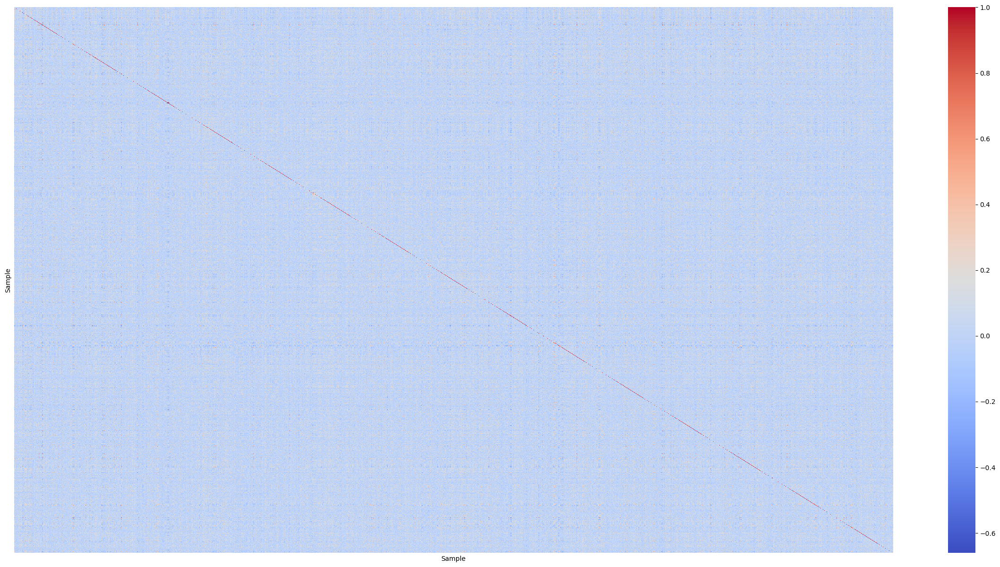

In [ ]:
#pearson correlation coefficient
corr_matrix_p = h_filtered.transpose().corr(method = 'pearson')

average = (corr_matrix_p.values.max() - corr_matrix_p.values.min()) /2 + corr_matrix_p.values.min()
print("Number of cells included: ", np.shape(corr_matrix_p))
print("Average between minimum and maximum correlation: ", average)
print("Average correlation of expression profiles between cells: ", corr_matrix_p.mean().mean())
print("Min. correlation of expression profiles between cells: ", corr_matrix_p.values.min())

plt.figure(figsize=(30,15))
sns.heatmap(corr_matrix_p, cmap='coolwarm', yticklabels = False, xticklabels = False)
plt.xlabel('Sample')
plt.ylabel('Sample')
plt.show()

Number of cells included:  (3000, 3000)
Average between minimum and maximum correlation:  0.19162656628294006
Average correlation of expression profiles between cells:  0.014895438393351544
Min. correlation of expression profiles between cells:  -0.6608793983317274


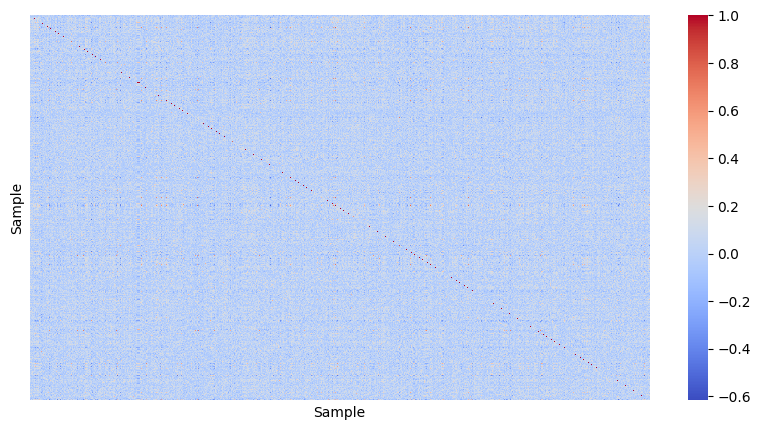

In [ ]:
#spearman correlation coefficient
corr_matrix_s = h_filtered.transpose().corr(method = 'spearman')

average = (corr_matrix_s.values.max() - corr_matrix_s.values.min()) /2 + corr_matrix_s.values.min()
print("Number of cells included: ", np.shape(corr_matrix_s))
print("Average between minimum and maximum correlation: ", average)
print("Average correlation of expression profiles between cells: ", corr_matrix_p.mean().mean())
print("Min. correlation of expression profiles between cells: ", corr_matrix_p.values.min())

plt.figure(figsize=(10,5))
sns.heatmap(corr_matrix_s, cmap='coolwarm', yticklabels = False, xticklabels = False)
plt.xlabel('Sample')
plt.ylabel('Sample')
plt.show()

Notice that overall there doesn't seem to be some significant structure of genes. Indeed most are negatively correlated and that's it.

To go on with this analysis, we can also proceed by creating a co-expression network. Gene co-expression networks (GCNs) are transcript–transcript association networks, generally reported as undirected graphs, where genes are connected when an appreciable co-expression association between them exists. 

The steps of creating one are:
1. Calculating a co-expression measure
2. Selecting a significance threshold.

As for the co-expression measure, we'll use Pearson’s correlation coefficient. The two disadvantages are that it detects only linear relationships and that is sensitive to outliers.

As for the second step, a threshold is selected such that gene pairs that have a correlation score higher than the threshold are considered to have a significant co-expression relationship. Then, the elements in the correlation matrix which are above the threshold are replaced by 1 (meaning that the corresponding genes are similarly co-expressed), and the remaining elements are replaced by 0.

The study of gene co-expression networks allows us to identify genes that are controlled by the same transcriptional regulatory program, that are functionally related, or whose gene products are involved in a common biological process.

In [ ]:
corr_threshold = 0.45
adj_corr_matrix = np.abs(corr_matrix_p) > corr_threshold
adj_corr_matrix = adj_corr_matrix.astype(int)
adj_corr_matrix

#remove diagonal
n = adj_corr_matrix.shape[0]
diagonal = pd.DataFrame(0, index=adj_corr_matrix.index, columns=adj_corr_matrix.columns)

# set diagonal elements to 1
for i in range(n):
    diagonal.iloc[i,i] = 1

adj_corr_matrix = adj_corr_matrix - diagonal
adj_corr_matrix

genes_to_keep = adj_corr_matrix.sum() != 0
adj_corr_matrix = adj_corr_matrix.loc[genes_to_keep,genes_to_keep]
adj_corr_matrix

,LINC01770,HES5,ERRFI1,DHRS3,LRRC38,PDPN,FHAD1-AS1,LINC01772,MST1P2,PADI2,...,GRIK1,CLDN8,KRTAP20-4,C21orf62-AS1,CLDN14,CSTB,PFKL,COL6A1,COL6A2,LSS
LINC01770,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
HES5,0,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
ERRFI1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
DHRS3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
LRRC38,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CSTB,0,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
PFKL,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
COL6A1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
COL6A2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0


To draw it we'll create an HTML file, saved as "graph_output.html" in the "data_additional" folder, that will output an interactive plot, in which one will be able to see which genes have an edge to each other.
Since loading will take time, we also put a simple plot generated with python in the subsequent cell, to avoid the burdens of waiting for the loading of the HTML file.

In [ ]:
def draw_graph3(networkx_graph,notebook=True,output_filename='graph.html',show_buttons=False,only_physics_buttons=False):
        """
        This function accepts a networkx graph object,
        converts it to a pyvis network object preserving its node and edge attributes,
        and both returns and saves a dynamic network visualization.

        Valid node attributes include:
            "size", "value", "title", "x", "y", "label", "color".

            (For more info: https://pyvis.readthedocs.io/en/latest/documentation.html#pyvis.network.Network.add_node)

        Valid edge attributes include:
            "arrowStrikethrough", "hidden", "physics", "title", "value", "width"

            (For more info: https://pyvis.readthedocs.io/en/latest/documentation.html#pyvis.network.Network.add_edge)


        Args:
            networkx_graph: The graph to convert and display
            notebook: Display in Jupyter?
            output_filename: Where to save the converted network
            show_buttons: Show buttons in saved version of network?
            only_physics_buttons: Show only buttons controlling physics of network?
        """

        # import
        from pyvis import network as net

        # make a pyvis network
        pyvis_graph = net.Network(notebook=notebook, cdn_resources='in_line')
        pyvis_graph.width = '1000px'
        # for each node and its attributes in the networkx graph
        for node,node_attrs in networkx_graph.nodes(data=True):
            pyvis_graph.add_node(node,**node_attrs)
    #         print(node,node_attrs)

        # for each edge and its attributes in the networkx graph
        for source,target,edge_attrs in networkx_graph.edges(data=True):
            # if value/width not specified directly, and weight is specified, set 'value' to 'weight'
            if not 'value' in edge_attrs and not 'width' in edge_attrs and 'weight' in edge_attrs:
                # place at key 'value' the weight of the edge
                edge_attrs['value']=edge_attrs['weight']
            # add the edge
            pyvis_graph.add_edge(source,target,**edge_attrs)

        # turn buttons on
        if show_buttons:
            if only_physics_buttons:
                pyvis_graph.show_buttons(filter_=['physics'])
            else:
                pyvis_graph.show_buttons()

        # return and also save
        pyvis_graph.save_graph(output_filename)
        return pyvis_graph.show(output_filename)

graph = nx.from_pandas_adjacency(adj_corr_matrix, create_using=None)
draw_graph3(graph,output_filename='graph_output.html', notebook=True)


graph_output.html


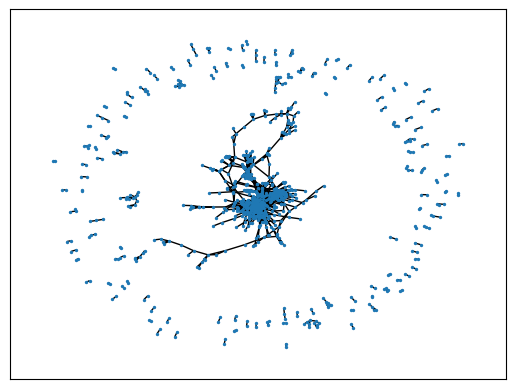

In [ ]:
graph = nx.from_pandas_adjacency(adj_corr_matrix, create_using=None)
layout = nx.spring_layout(graph)
nx.draw_networkx(graph, pos = layout, node_size = 2, with_labels = False)
plt.show()

From the HTML file, and even slightly for the python plot we see the presence of three main groups of genes that are highly correlated.

This information is interesting as it displays the presence of some separating structures of the genes that we'll uncover in the next section.

## Unsupervised Clustering

Here we want to group cells, without any prior knowledge, based on similarity conditions, which we'll define via distance metrics. We'll then visualize the cluster on a lower dimensional space using the techniques of the Dimensionality Reduction section, if needed.

We'll apply the following methods:
- Hierarchical Clustering
- K-Means Clustering
- Leiden Clustering

### Hierarchical

The algorithm works by iteratively merging the closest pairs of data points into clusters until all the data points belong to a single cluster.

In [ ]:
hierarchical = h_filtered.transpose() # genes as column
hierarchical.shape

(229, 3000)

To determine the distance between the clusters we'll use four methods:
- Complete linkage: it computes the distance between the two clusters as the maximum distance between any two points in each cluster.
- Average linkage: it computes the distance between the two clusters as the average distance between all pairs of points in each cluster.
- Ward linkage: it minimizes the variance of the distances between all points in each cluster.
- Median linkage: it computes the distance between the two clusters as the distance between the medians of each cluster.

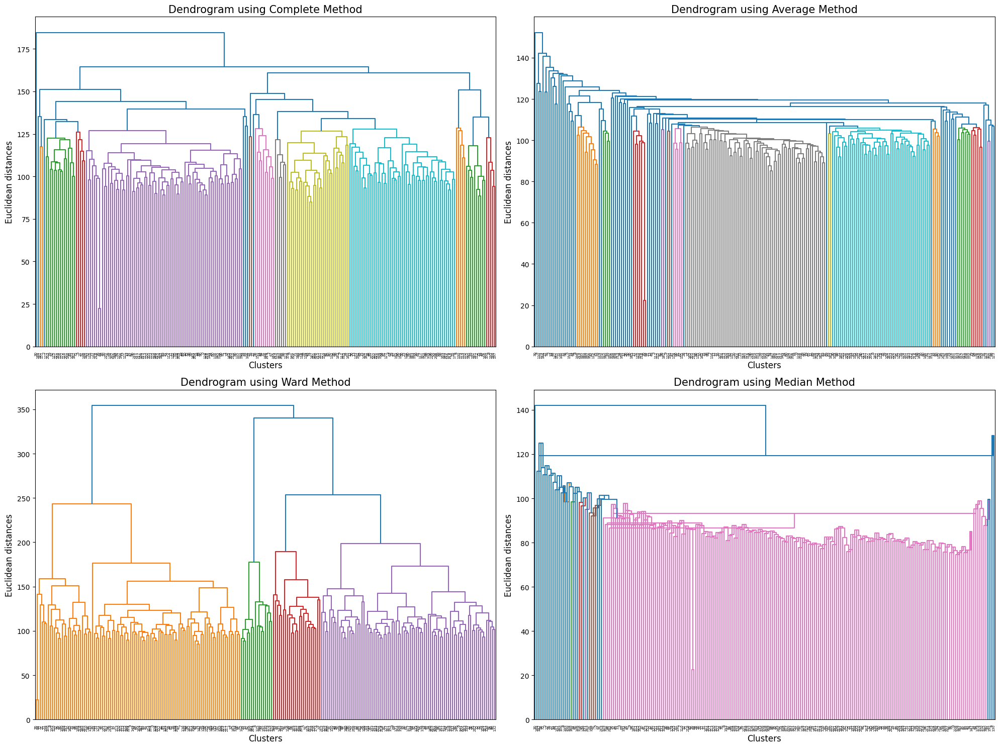

In [ ]:
linkage_methods = ['complete', 'average', 'ward', 'median']

# Loop through the linkage methods and plot each dendrogram subplot
fig, axs = plt.subplots(len(linkage_methods)//2, 2, figsize=(20, 15))

# Loop through the linkage methods and plot each dendrogram subplot
for i, method in enumerate(linkage_methods):
    row = i // 2
    col = i % 2
    dend = dendrogram(linkage(hierarchical, method=method), ax=axs[row, col])
    axs[row, col].set_title(f"Dendrogram using {method.capitalize()} Method", fontsize=15)
    axs[row, col].set_xlabel('Clusters', fontsize=12)
    axs[row, col].set_ylabel('Euclidean distances', fontsize=12)
    axs[row, col].grid(False)

# Adjust the spacing between subplots and display the figure
fig.tight_layout()
plt.show()

Each method yields different results, as expected.

The best-looking one seems from Ward's method, and it is not surprising as it optimizes the sum of squares within clusters, which is particularly suitable for detecting compact, dense clusters in high-dimensional data, such as ours. It finds four main clusters.

From average linkage we see the presence of many genes that are added at the end, indicating that they might be a bit separated.

This, together with the other linkage methods, might illustrate the presence of many more subclasses of genes, that together might be related to a normoxic and hypoxic cell. Overall, we can intuitively say that there are surely different types of genes accounting for the same type of cell (i.e. normoxic or hypoxic).

### K-Means

It works by iteratively partitioning the data into k clusters, where k is the number of clusters specified by the user. The algorithm calculates the centroid of each cluster and assigns data points to the cluster with the nearest centroid. This process is repeated until the cluster assignments no longer change significantly. The result is k clusters of data points that are similar to each other and dissimilar to data points in other clusters.

In [ ]:
kmeans_df = h_filtered.transpose()
# kmeans_df

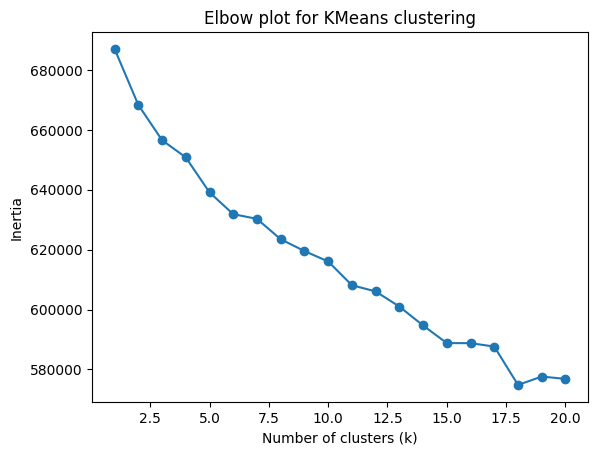

In [ ]:
k_range = range(1, 21)

inertia = []
for k in k_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(StandardScaler().fit_transform(kmeans_df))
    inertia.append(kmeans.inertia_)

plt.plot(k_range, inertia, marker='o')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Inertia')
plt.title('Elbow plot for KMeans clustering')
plt.show()

As we can see there is no true elbow. So, we'll try to visualize them using only two clusters, which hopefully will be the hypoxic and normoxic ones.

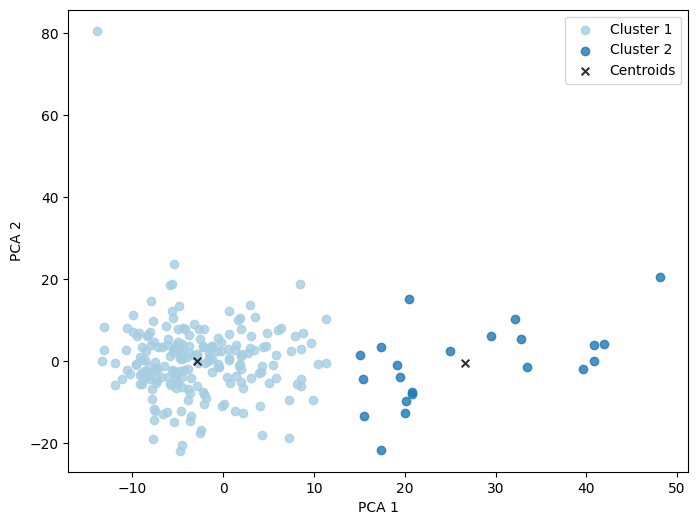

In [ ]:
kmeans = KMeans(n_clusters=2, init='k-means++', random_state=42)
pca = PCA(n_components=2)
PCA_components = pca.fit_transform(StandardScaler().fit_transform(kmeans_df))
kmeans.fit(PCA_components)
cluster_labels = kmeans.predict(PCA_components)
centroids = kmeans.cluster_centers_
kmeans_df['cluster'] = cluster_labels
fig, ax = plt.subplots(figsize=(8, 6))
colors = sns.color_palette("Paired", n_colors=4)
for i in range(2):
    ax.scatter(PCA_components[kmeans_df['cluster']==i, 0], PCA_components[kmeans_df['cluster']==i, 1], alpha=0.8, label='Cluster '+str(i+1), color=colors[i])
ax.scatter(centroids[:,0], centroids[:,1], marker='x', s=30, color='black', alpha = 0.8, label='Centroids')
plt.xlabel('PCA 1')
plt.ylabel('PCA 2')
ax.legend()
plt.show()

Interestingly, it found first the "outlier" cluster. Let's try with four clusters.

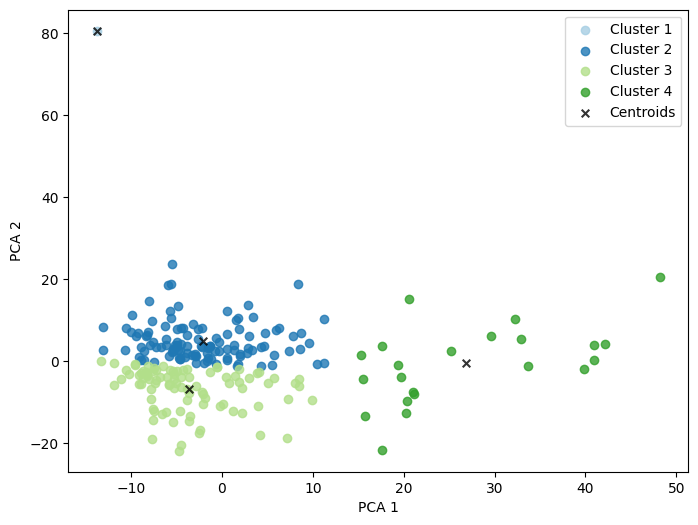

In [ ]:
kmeans = KMeans(n_clusters=4, init='k-means++', random_state=42)
pca = PCA(n_components=2)
PCA_components = pca.fit_transform(StandardScaler().fit_transform(kmeans_df))
kmeans.fit(PCA_components)
cluster_labels = kmeans.predict(PCA_components)
centroids = kmeans.cluster_centers_
kmeans_df['cluster'] = cluster_labels
fig, ax = plt.subplots(figsize=(8, 6))
colors = sns.color_palette("Paired", n_colors=4)
for i in range(4):
    ax.scatter(PCA_components[kmeans_df['cluster']==i, 0], PCA_components[kmeans_df['cluster']==i, 1], alpha=0.8, label='Cluster '+str(i+1), color=colors[i])
ax.scatter(centroids[:,0], centroids[:,1], marker='x', s=30, color='black', alpha = 0.8, label='Centroids')
plt.xlabel('PCA 1')
plt.ylabel('PCA 2')
ax.legend()
plt.show()

Apart from having a cluster with a single cell, now we see the separtion between hypoxic and normoxic cells we were looking for.

### Leiden Clustering Technique

The Leiden algorithm utilizes a K-nearest neighbors graph created from a reduced expression space via principal component analysis to perform clustering. Initially, each node is placed in its own community, and then the algorithm relocates individual nodes to other communities to identify an initial partition, which is then optimized through further refinement. A refined partition is then used to generate an aggregate network, which undergoes iterative refinement until no further enhancements can be achieved, resulting in the final partition. The Leiden algorithm is an enhancement of the Louvain algorithm (another widely used method) and has demonstrated superior performance, making it the preferred option.

We'll implement it using scanpy as many functions are implemented there.

In [ ]:
sc.settings.verbosity = 0
leiden = h_filtered.transpose()
adata = sc.AnnData(leiden.copy())

Now some preliminary necessary procedures to run the algorithm

In [ ]:
adata.var["mt"] = adata.var_names.str.startswith("MT-")
sc.pp.calculate_qc_metrics(adata, qc_vars=["mt"], inplace=True, percent_top=[20], log1p=True)
sc.pp.scale(adata)
sc.pp.pca(adata, svd_solver="arpack", n_comps = 228) # same plot as before
sc.pp.neighbors(adata, n_pcs = 202) # computes the KNN graph on the lower-dim space on 202 components (95% variance)

We are now ready to apply the Leiden algorithm

In [ ]:
sc.tl.leiden(adata)

The Leiden module has a resolution parameter, which allows control of the clustering resolution. Indeed the higher the values, the more the clusters. We'll apply values in a range $[0.5, 1]$ at steps of 0.1 and then select the ideal resolution value based on the structure we want to identify. This will become especially important when annotating the clusters.

In [ ]:
sc.tl.leiden(adata, key_added="leiden_res0_5", resolution=0.5)
sc.tl.leiden(adata, key_added="leiden_res0_6", resolution=0.6)
sc.tl.leiden(adata, key_added="leiden_res0_7", resolution=0.7)
sc.tl.leiden(adata, key_added="leiden_res0_8", resolution=0.8)
sc.tl.leiden(adata, key_added="leiden_res0_9", resolution=0.9)
sc.tl.leiden(adata, key_added="leiden_res1", resolution=1.0)

We now visualize the different clustering results obtained with the Leiden algorithm at different resolutions. To avoid making the report longer, we'll just plot it here only on PCA. Keep in mind that we plotted the results on t-SNE and UMAP too, obtaining similar results to those of PCA.

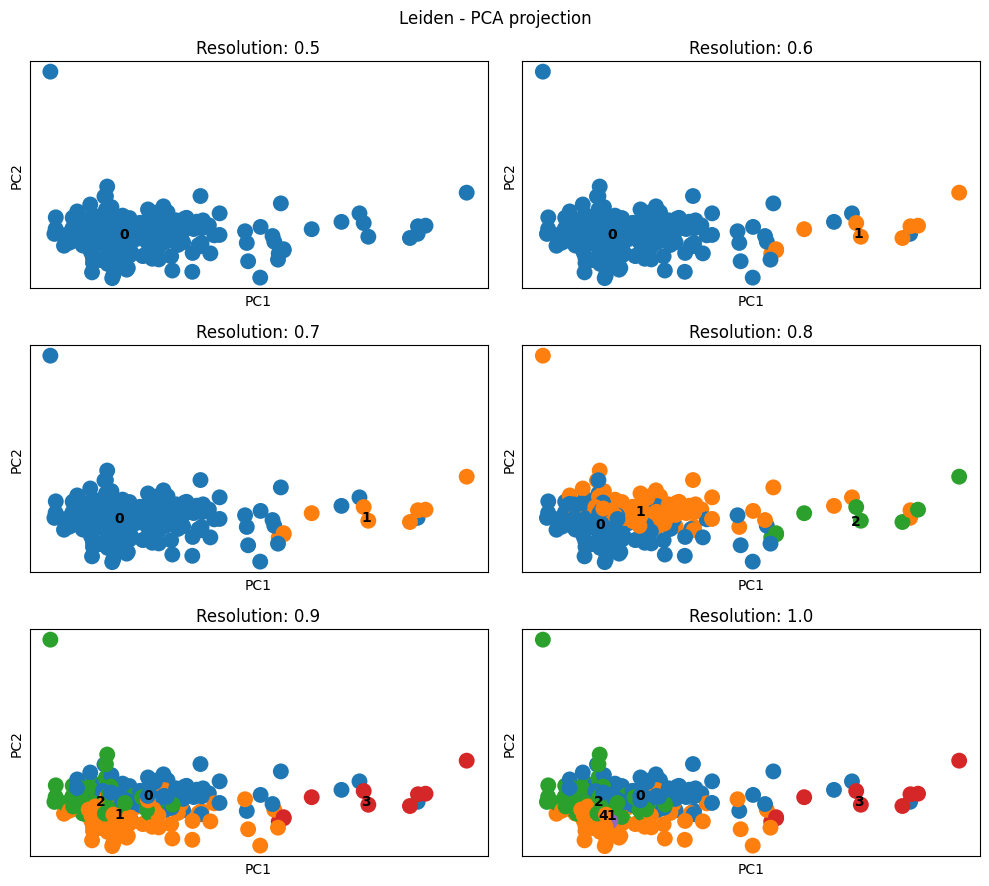

In [ ]:
fig, axs = plt.subplots(3, 2, figsize=(10, 9))
plt.suptitle("Leiden - PCA projection")

sc.pl.pca(adata, color="leiden_res0_5", legend_loc="on data", ax=axs[0, 0], show=False)
axs[0, 0].set_title("Resolution: 0.5")

sc.pl.pca(adata, color="leiden_res0_6", legend_loc="on data", ax=axs[0, 1], show=False)
axs[0, 1].set_title("Resolution: 0.6")

sc.pl.pca(adata, color="leiden_res0_7", legend_loc="on data", ax=axs[1, 0], show=False)
axs[1, 0].set_title("Resolution: 0.7")

sc.pl.pca(adata, color="leiden_res0_8", legend_loc="on data", ax=axs[1, 1], show=False)
axs[1, 1].set_title("Resolution: 0.8")

sc.pl.pca(adata, color="leiden_res0_9", legend_loc="on data", ax=axs[2, 0], show=False)
axs[2, 0].set_title("Resolution: 0.9")

sc.pl.pca(adata, color="leiden_res1", legend_loc="on data", ax=axs[2, 1], show=False)
axs[2, 1].set_title("Resolution: 1.0")

plt.tight_layout()
plt.show()

Just like in k-means, the first identified cluster is the one of the outliers (we mean the cells which are further away from the others) and then as we increase the resolution, more structure in the main "cloud" seems to appear. The clusters initially seem to be separating hypoxic and normix cells.

In all three projections, the resolution value that seems most informative to us is 0.8, which identifies 3 clusters. Indeed, even if larger values give more clusters, hence more differentiation between cells due to genes, we're still interested in just classifying normoxic or hypoxic cells. 

With a resolution value of 0.8, we always get two big clusters plus a small one, which might indicate some noise, intuitively speaking.
Moreover, in the next part, we are going to annotate the main genes that belong to each cluster, which will be even more fundamental in understanding the results and interpreting which genes are relevant.

## Gene Annotation

Once we have identified a suitable number of clusters, we can try to understand the cluster "identity" even more. In particular, we could label groups of cells based on (known) markers. Notice that even though all cells are of the same type, this is an important step in the analysis because it allows us to identify which main genes are responsible for the differences between clusters, which will later come useful to interpret the results we get, especially for an expert in biology that knows what each gene might do.

First, in spirit to the EDA section, let's check which genes are produced the most by each cell, and for normoxic and hypoxic cells (i.e. our main groups), check the top 5 expressed genes.

In [ ]:
# which gene are produced the most by each cell
print(pd.DataFrame({'gene': h_filtered.idxmax(), 'value': h_filtered.max()}))
print("Uniques[{}]: {}".format(h_filtered.idxmax().unique().size, h_filtered.idxmax().unique()))

                                                     gene      value
output.STAR.PCRPlate1A10_Normoxia_S123_Aligned....   FTH1  12.581760
output.STAR.PCRPlate1A12_Normoxia_S26_Aligned.s...   FTH1  11.942694
output.STAR.PCRPlate1A2_Hypoxia_S104_Aligned.so...  HSPA5  14.281864
output.STAR.PCRPlate1A3_Hypoxia_S4_Aligned.sort...   FTH1  12.991999
output.STAR.PCRPlate1A4_Hypoxia_S8_Aligned.sort...   FTH1  15.394209
...                                                   ...        ...
output.STAR.PCRPlate4H10_Normoxia_S210_Aligned....  HSPA5  12.484445
output.STAR.PCRPlate4H11_Normoxia_S214_Aligned....  HSPA5  12.279027
output.STAR.PCRPlate4H2_Hypoxia_S199_Aligned.so...  LAMB3  12.887459
output.STAR.PCRPlate4H7_Normoxia_S205_Aligned.s...  LAMC2  13.079699
output.STAR.PCRPlate4H9_Normoxia_S236_Aligned.s...  HSPA5  11.594712

[229 rows x 2 columns]
Uniques[7]: ['FTH1' 'HSPA5' 'LAMC2' 'LAMB3' 'DDIT4' 'KRT13' 'KRT17']


So from 3000 genes, only 7 seem to be the most codified. This might indicate that the normoxia and hypoxia conditions might boil down to "few" genes.

In [ ]:
# check for normoxic, hypoxic cells which are the top 10 expressed genes
print("Top 5 genes of normoxic cells:\n", h_filtered.loc[:, normoxic_cells].sum(axis = 1).nlargest(5))
print("Top 5 genes of hypoxic cells:\n", h_filtered.loc[:, hypoxic_cells].sum(axis = 1).nlargest(5))

Top 5 genes of normoxic cells:
 FTH1     1365.128760
BEST1    1343.024750
HSPA5    1317.703984
LAMB3    1184.497846
LAMC2    1169.995759
dtype: float64
Top 5 genes of hypoxic cells:
 FTH1     1441.242768
BEST1    1417.593413
HSPA5    1406.605119
DDIT4    1341.890732
LAMB3    1297.061416
dtype: float64


Now, our goal is to identify the gene markers manually for the 3 clusters identified before with the Leiden algorithm, using a resolution of 0.8. First, we need to define a set of known marker genes, some of which were taken from [Peng-Ju et al, 2020](https://www.frontiersin.org/articles/10.3389/fonc.2020.579868). Note that one could actually define its own list of genes and there are infinitely many choices. Due to time constraints we decided to keep only these ones. Notice also that the genes are related to specific cell types, but let's recall that they will be useless for us as our data has only one cell-type, so we'll be looking only at genes.

In [ ]:
marker_genes = {
    #these one are standard
    "CD14+ Mono": ["FCN1", "CD14"],
    "CD16+ Mono": ["TCF7L2", "FCGR3A", "LYN"],
    "ID2-hi myeloid prog": [
        "CD14",
        "ID2",
        "VCAN",
        "S100A9",
        "CLEC12A",
        "KLF4",
        "PLAUR",
    ],
    "cDC1": ["CLEC9A", "CADM1"],
    "cDC2": [
        "CST3",
        "COTL1",
        "LYZ",
        "DMXL2",
        "CLEC10A",
        "FCER1A",
    ],  # Note: DMXL2 should be negative
    "Normoblast": ["SLC4A1", "SLC25A37", "HBB", "HBA2", "HBA1", "TFRC"],
    "Erythroblast": ["MKI67", "HBA1", "HBB"],
    "Proerythroblast": [
        "CDK6",
        "SYNGR1",
        "HBM",
        "GYPA",
    ],  # Note HBM and GYPA are negative markers
    "NK": ["GNLY", "NKG7", "CD247", "GRIK4", "FCER1G", "TYROBP", "KLRG1", "FCGR3A"],
    "ILC": ["ID2", "PLCG2", "GNLY", "SYNE1"],
    "Lymph prog": [
        "VPREB1",
        "MME",
        "EBF1",
        "SSBP2",
        "BACH2",
        "CD79B",
        "IGHM",
        "PAX5",
        "PRKCE",
        "DNTT",
        "IGLL1",
    ],
    "Naive CD20+ B": ["MS4A1", "IL4R", "IGHD", "FCRL1", "IGHM"],
    "B1 B": [
        "MS4A1",
        "SSPN",
        "ITGB1",
        "EPHA4",
        "COL4A4",
        "PRDM1",
        "IRF4",
        "CD38",
        "XBP1",
        "PAX5",
        "BCL11A",
        "BLK",
        "IGHD",
        "IGHM",
        "ZNF215",
    ],  # Note IGHD and IGHM are negative markers
    "Transitional B": ["MME", "CD38", "CD24", "ACSM3", "MSI2"],
    "Plasma cells": ["MZB1", "HSP90B1", "FNDC3B", "PRDM1", "IGKC", "JCHAIN"],
    "Plasmablast": ["XBP1", "RF4", "PRDM1", "PAX5"],  # Note PAX5 is a negative marker
    "CD4+ T activated": ["CD4", "IL7R", "TRBC2", "ITGB1"],
    "CD4+ T naive": ["CD4", "IL7R", "TRBC2", "CCR7"],
    "CD8+ T": ["CD8A", "CD8B", "GZMK", "GZMA", "CCL5", "GZMB", "GZMH", "GZMA"],
    "T activation": ["CD69", "CD38"],  # CD69 much better marker!
    "T naive": ["LEF1", "CCR7", "TCF7"],
    "pDC": ["GZMB", "IL3RA", "COBLL1", "TCF4"],
    "G/M prog": ["MPO", "BCL2", "KCNQ5", "CSF3R"],
    "HSC": ["NRIP1", "MECOM", "PROM1", "NKAIN2", "CD34"],
    "MK/E prog": [
        "ZNF385D",
        "ITGA2B",
        "RYR3",
        "PLCB1",
    ],  # Note PLCB1 is a negative marker
    # these ones are based on Peng-Ju et al., 2020, https://www.frontiersin.org/articles/10.3389/fonc.2020.579868 
    'Endothelial cells': ['VEGFA', 'SLC2A1', 'PGAM1', 'LDHA'],
    'Fibroblasts': ['TPI1', 'P4HA1', 'MRPS17', 'CDKN3'],
    'Adipocytes': ['ADM', 'NDRG1', 'TUBB6'],
    'Myocytes': ['ALDOA', 'MIF']
}

In [ ]:
marker_genes_in_data = {}
for ct, markers in marker_genes.items():
    markers_found = list()
    for marker in markers:
        if marker in adata.var.index:
            markers_found.append(marker)
    marker_genes_in_data[ct] = markers_found
marker_genes_in_data = {k: v for k, v in marker_genes_in_data.items() if v} # keep nonempty sets

In [ ]:
marker_genes_in_data

{'ID2-hi myeloid prog': ['ID2', 'S100A9', 'PLAUR'],
 'Erythroblast': ['MKI67'],
 'NK': ['CD247'],
 'ILC': ['ID2', 'SYNE1'],
 'Lymph prog': ['MME'],
 'B1 B': ['COL4A4', 'PRDM1'],
 'Transitional B': ['MME', 'CD24'],
 'Plasma cells': ['PRDM1'],
 'Plasmablast': ['PRDM1'],
 'CD4+ T activated': ['TRBC2'],
 'CD4+ T naive': ['TRBC2'],
 'T activation': ['CD69'],
 'T naive': ['LEF1'],
 'HSC': ['PROM1'],
 'Endothelial cells': ['VEGFA', 'SLC2A1'],
 'Fibroblasts': ['P4HA1'],
 'Adipocytes': ['ADM', 'NDRG1']}

We see that not many of the given marker genes are in our data, but still, some are, so hopefully we can have good results. We could focus on different all these cell subtypes. So let's see where we can find them the most in our plot before.

In [ ]:
# subtypes we want to show the markers for
cell_subtypes = ["B1 B", "Transitional B", # b cells
                 "Plasma cells", "Plasmablast", # plasma cells
                 "CD4+ T activated", "CD4+ T naive", "T activation", "T naive", # t cells
                 "Endothelial cells", "Fibroblasts", "Adipocytes"]


B1 B:


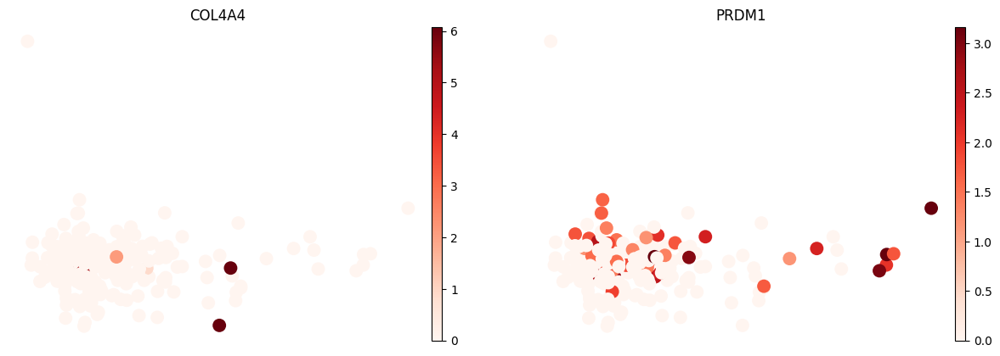





TRANSITIONAL B:


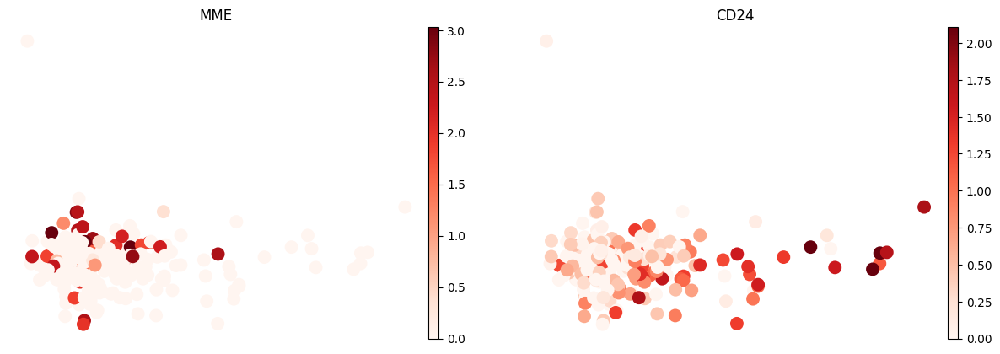





PLASMA CELLS:


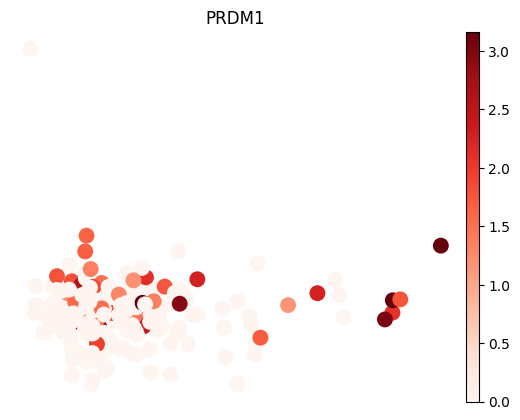





PLASMABLAST:


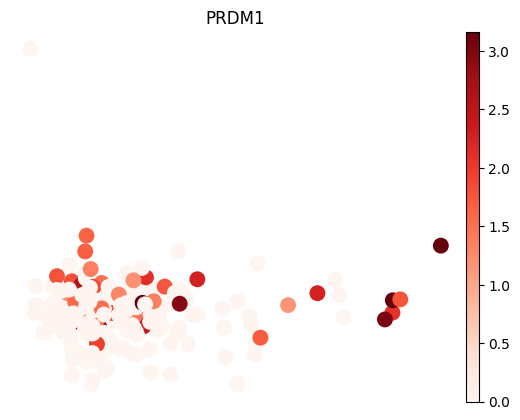





CD4+ T ACTIVATED:


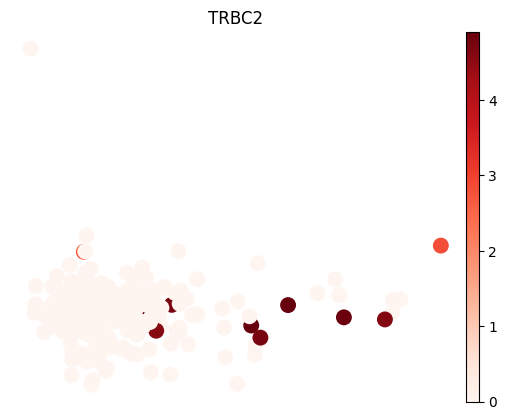





CD4+ T NAIVE:


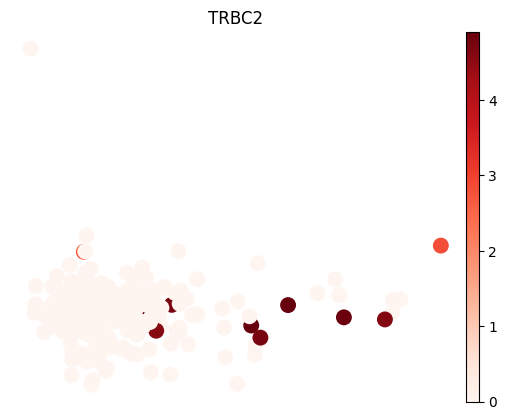





T ACTIVATION:


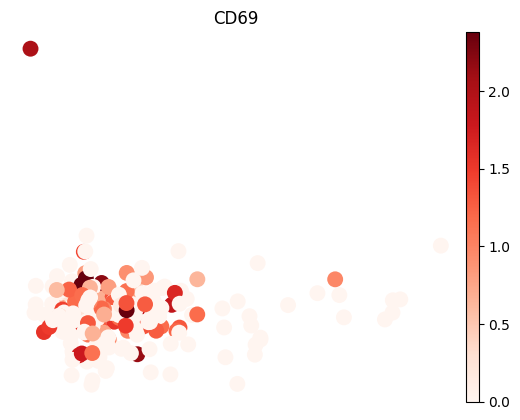





T NAIVE:


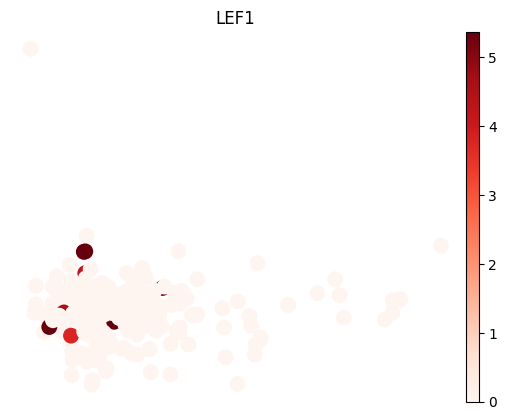





ENDOTHELIAL CELLS:


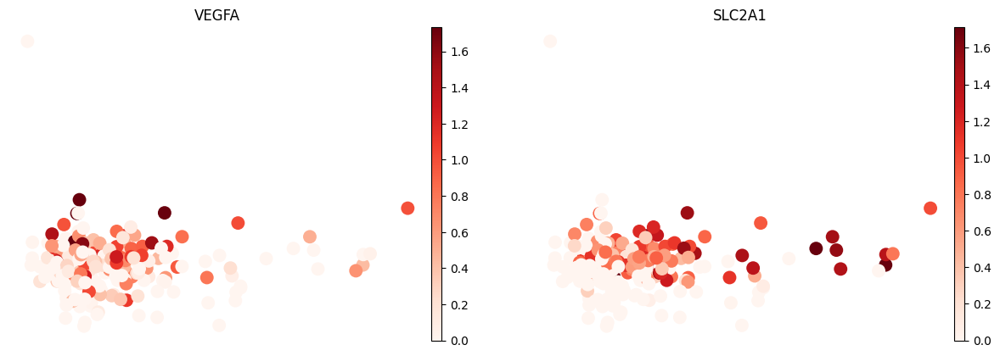





FIBROBLASTS:


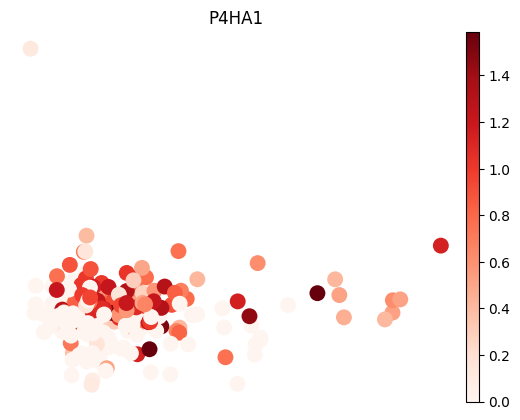





ADIPOCYTES:


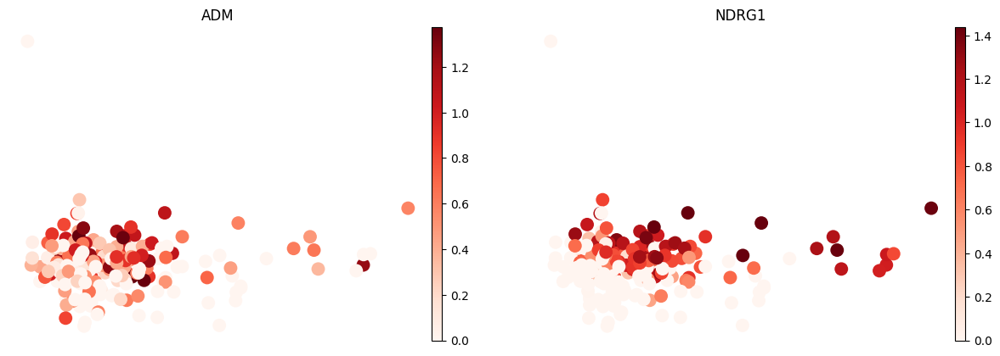

In [ ]:
for ct in cell_subtypes:
    print(f"{ct.upper()}:")
    sc.pl.pca(
        adata,
        color=marker_genes_in_data[ct],
        vmin=0,
        vmax="p99",  # set vmax to the 99th percentile of the gene count instead of the maximum
        sort_order=False,
        frameon=False,
        cmap="Reds")
    print("\n\n\n")

From the above plots, we see which how marker genes are expressed in the different cell types. Some structure seems to emerge.
Let's use Leiden with resolution 0.8, as it was the optimal one according to the previous observations. 
First, we plot it once again, for illustration purposes.

<Axes: title={'center': 'leiden_res0_8'}, xlabel='PC1', ylabel='PC2'>

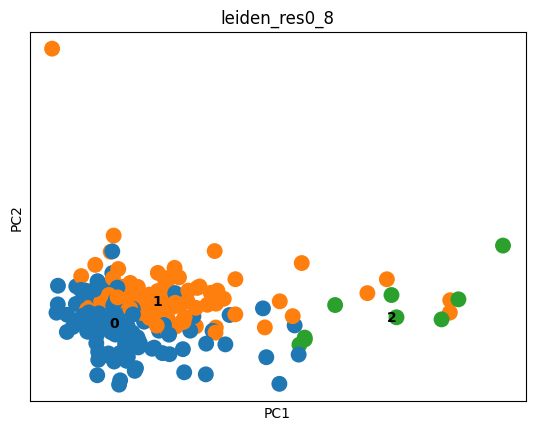

In [ ]:
sc.pl.pca(adata, color="leiden_res0_8", legend_loc="on data", show=False)

To have more insights, let's do a dotplot, where each dot represents two values: mean expression within each category and fraction of cells expressing the variable in the category (visualized by the size of the dot).


/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


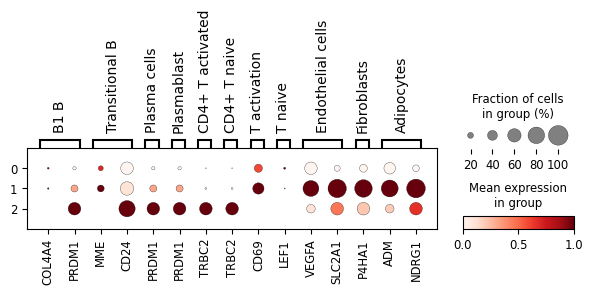

In [ ]:
cell_markers = {
    ct: [m for m in ct_markers if m in adata.var.index]
    for ct, ct_markers in marker_genes.items()
    if ct in cell_subtypes
}

# res 0.8
sc.pl.dotplot(adata, groupby="leiden_res0_8", var_names=cell_markers, standard_scale="var") # normalize each gene to range from 0 to 1

Small dots indicate that few cells in the cluster express the marker, whereas large dots show that almost all cells in the cluster express the marker.

As we can see cluster 0, has only one meaningful gene: CD69. Graphically, we can see that it is not the best marker, but it is still better than nothing. For cluster 1, the right-hand side genes are more prevalent than others. Doing also a graphical inspection, the most representative seems SLC2A1, which is not surprising as it can increase to facilitate the uptake of glucose, which is an important source of energy for hypoxic cells.
For cluster 2, so the "outliers", there are many possible marker genes. Looking at the previous plots, we decide to choose CD24

Now we can annotate the clusters, taking the most representative genes.

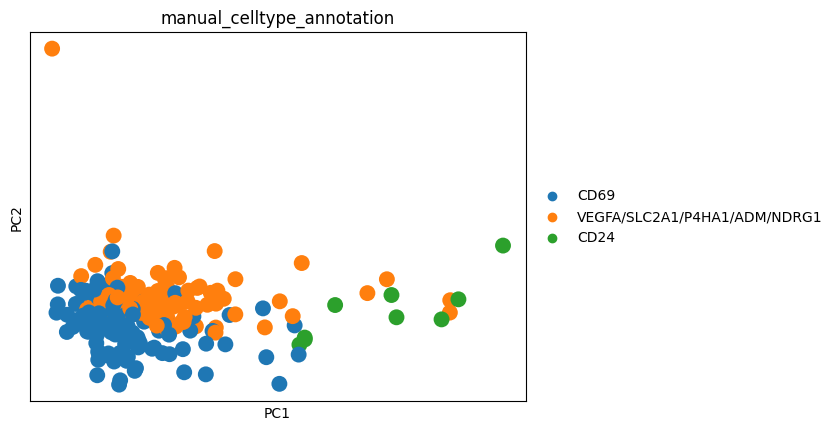

In [ ]:
cluster_annotation = {
    "0": "CD69",
    "1": "VEGFA/SLC2A1/P4HA1/ADM/NDRG1",
    "2": "CD24",
}
adata.obs["manual_celltype_annotation"] = adata.obs.leiden_res0_8.map(cluster_annotation)
sc.pl.pca(adata, color=["manual_celltype_annotation"])

These are the results we got. We should now leave the interpretation to a biologist because our expertise stops here. However, it is fundamental to notice that the cluster annotation is not unique.

Indeed, based on the cell markers we choose, we can get potentially different results. Therefore, we claim that these results are good according to the markers defined above only. 

Now that we've done all the necessary preliminary analyses, it is time to make the classification on a separate file. We'll be working with the train data from now on, and the reader should now switch to the "HCC1806_train" file.

In [ ]:
# h_train = h_filtered.to_csv(path_or_buf = "/content/h_train.csv")